# Imports

In [ ]:
import phasorpy.phasor as ph
import phasorpy.plot as plot

import matplotlib.pyplot as plt
import os
import sys
import numpy as np

import warnings
warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")

plt.style.use('default')
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']

# Edit this path to point to the downloaded data directory
droot = f'/path/to/downloaded/data'
os.chdir(droot)

# This path should not need to change unless this notebook is moved out of the local directory into which this repo was cloned
sys.path.append("../pmc/pmc.py")
from pmc import *

# Figure 2

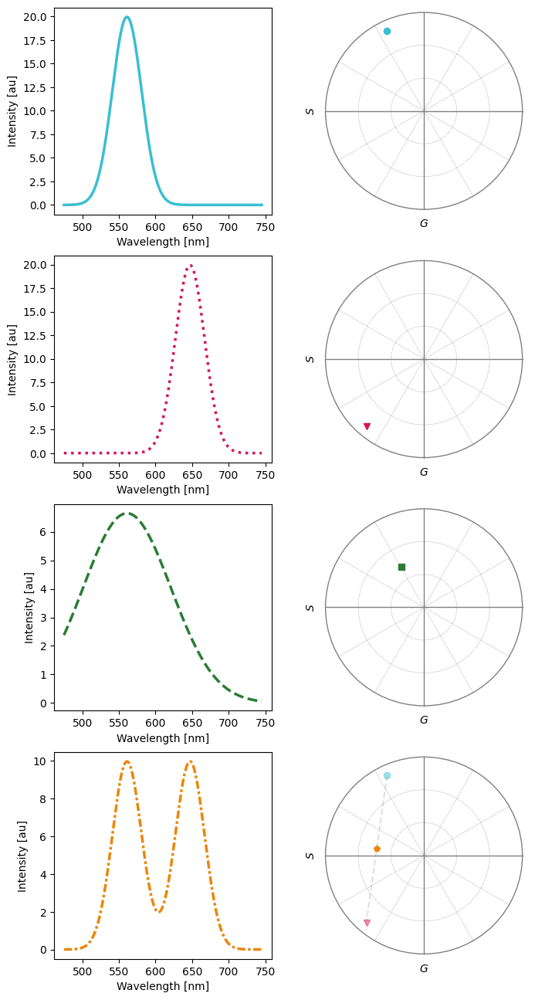

In [16]:
import phasorpy.phasor as ph
import phasorpy.plot as plot

### Visualize phasor points corresponding to spectra of various widths and peak wavelengths

def gaussian(x, mu, sig):
    return (
        1000.0 / (np.sqrt(2.0 * np.pi) * sig) * np.exp(-np.power((x - mu) / sig, 2.0) / 2)
    )
    
save_dir = os.path.join(droot,'fig2/')

cs = ['#39BFD0','#D81159','#297C33','#EC8609']
lpks = [561, 647, 561]
sig = [20, 20, 60]
lambdas = np.arange(475,750,10)
lstyle = ['solid','dotted','dashed',(0, (3, 1, 1, 1))]
marker = ['o','v','s','p']
lpts = np.arange(np.amin(lambdas),np.amax(lambdas),0.1)
fig, ax1 = plt.subplots(nrows=4,ncols=2,figsize=(8,16))

for l, s, c, ls, m, ax, ax2 in zip(lpks, sig, cs[:-1], lstyle[:-1], marker[:-1],ax1.ravel()[::2], ax1.ravel()[1::2]):
    
    response = gaussian(lpts,l,s)

    curves = ax.plot(lpts,response,c=c,linewidth=2.5,linestyle=ls)
    ax.set_xlabel('Wavelength [nm]')
    ax.set_ylabel('Intensity [au]')
    
    
    mean, real, imag = ph.phasor_from_signal(response)
    pplot = plot.PhasorPlot(ax=ax2,allquadrants=True)
    pplot.plot(real,imag,c=c, marker=m)
    ax2.set_title('')
    ax2.set_xlabel(r'$G$')
    ax2.set_ylabel(r'$S$')
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.set_frame_on(False)

response1 = gaussian(lpts,lpks[0],sig[0])
response2 = gaussian(lpts,lpks[-2],sig[0])
response = 0.5*(response1 + response2)

curves = ax1.ravel()[-2].plot(lpts,response,c=cs[-1],linewidth=2.5,linestyle=lstyle[-1])
ax1.ravel()[-2].set_xlabel('Wavelength [nm]')
ax1.ravel()[-2].set_ylabel('Intensity [au]')
    
mean, real, imag = ph.phasor_from_signal(response)
pplot = plot.PhasorPlot(ax=ax1.ravel()[-1],allquadrants=True)
pplot.plot(real,imag,c=cs[-1],marker=marker[-1])

mean, real1, imag1 = ph.phasor_from_signal(gaussian(lpts,lpks[0],sig[0]))
pplot.plot(real1,imag1,c=cs[0],marker=marker[0],alpha=0.25)

mean, real2, imag2 = ph.phasor_from_signal(gaussian(lpts,lpks[1],sig[1]))
pplot.plot(real2,imag2,c=cs[1],marker=marker[1],alpha=0.25)

ax1.ravel()[-1].scatter(real1,imag1,marker=marker[0],alpha=0.25,color=cs[0])
ax1.ravel()[-1].scatter(real2,imag2,marker=marker[1],alpha=0.25,color=cs[1])
ax1.ravel()[-1].plot([real1,real2],[imag1,imag2],color='gray',alpha=0.25,linestyle='dashed',zorder=-1000)

ax1.ravel()[-1].set_xlabel(r'$G$')
ax1.ravel()[-1].set_ylabel(r'$S$')

ax1.ravel()[-1].set_title('')
ax1.ravel()[-1].set_xticks([])
ax1.ravel()[-1].set_yticks([])
ax1.ravel()[-1].set_frame_on(False)

# fig.savefig(os.path.join(save_dir,f'gaussian_phasor_plots_new_1.svg'),dpi=300,bbox_inches='tight')


# Figure 3

Finished clustering data for AF561...
Determined peak at [-0.93715247  0.09985097]for AF561
Finished clustering data for AF647...
Determined peak at [-0.53922969 -0.77234609]for AF647
AF561 is already clustered... Peak at [-0.93715247  0.09985097]
AF647 is already clustered... Peak at [-0.53922969 -0.77234609]
test has a colocalization factor of [0.27922732 0.1925636 ]


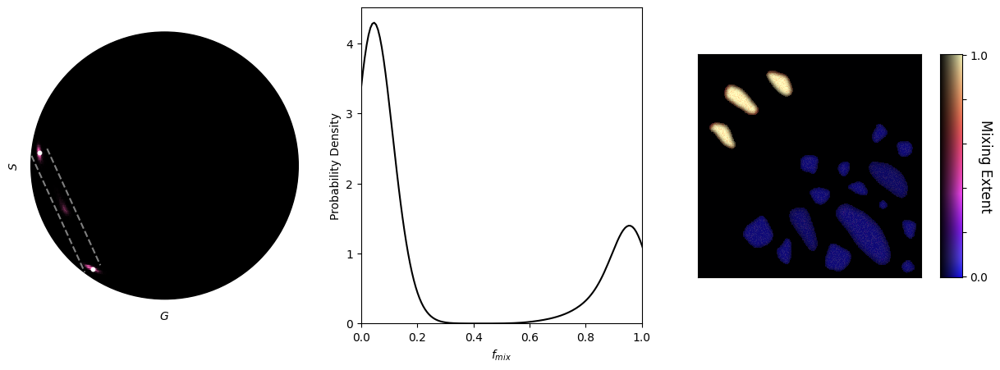

In [49]:
### This figure uses the simulated multispectral data from example A in Figures 1 and 4.
### This is done only to illustrate phasor plots and the other methods.
### Full analysis of this data is performed in Figure 4
data_dir_sim = os.path.join(droot,f'fig3/')
pc1_spec_test = PC(file=data_dir_sim+'A_ch1_af561_spec.tif',name='AF561',thresh='otsu')
pc2_spec_test = PC(file=data_dir_sim+'A_ch2_af647_spec.tif',name='AF647',thresh='otsu')

pc1_spec_test.determine_peak(pk_flag='test')
pc2_spec_test.determine_peak(pk_flag='test')
mixA = PairMixture(file=data_dir_sim + 'A_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh='otsu')

mixA.analyze_overlap(p_max=0.75,lims=[0,100]);

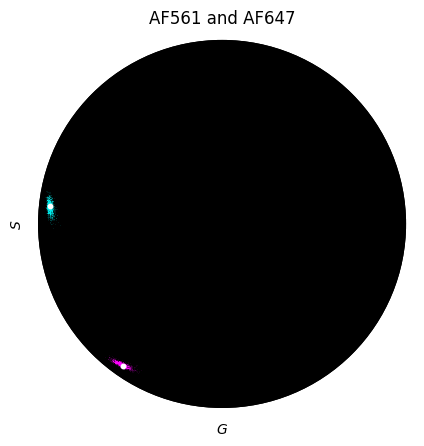

In [ ]:
save_dir = os.path.join(droot,f'fig3/figures')
### Single-color phasor plots
fig, ax = plt.subplots(figsize=(5,5))
pc1_spec_test.plot_phasor(ax1=ax,p_max=0.5,cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']))
pc2_spec_test.plot_phasor(ax1=ax,p_max=0.5,cmap=lsm.from_list(name = 'test', colors=['0','#fd00fdff']))
ax.set_title('AF561 and AF647')
ax.scatter(mixA.pc_pks[:,0],mixA.pc_pks[:,1],c='w',marker='o',s=10)
# plt.savefig(os.path.join(save_dir,f'A_AF561_AF647_phasor_plot.png'),dpi=300,transparent=True,bbox_inches='tight')

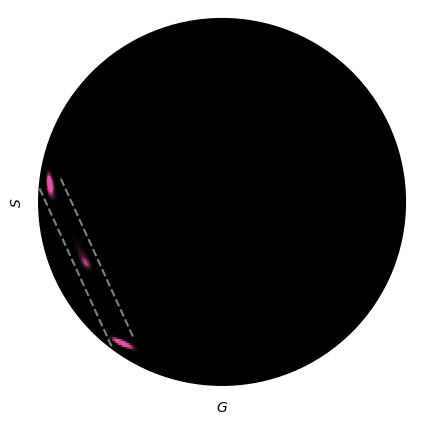

In [ ]:
save_dir = os.path.join(droot,f'fig3/figures')
### Phasor plot of a two-color sample
fig, ax = plt.subplots(figsize=(5,5))
mixA.plot_phasor(ax1=ax,p_max=0.5)
ax.plot([mixA.vertices[0,0],mixA.vertices[3,0]],[mixA.vertices[0,1],mixA.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mixA.vertices[1,0],mixA.vertices[2,0]],[mixA.vertices[1,1],mixA.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'A_phasor_band_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

The following blocks of code plot the histograms of the S coordinate in the phasor plots above.  
These are then manually placed on the phasor plots to qualitatively display the density of phasor points.

Text(0, 0.5, 'Counts')

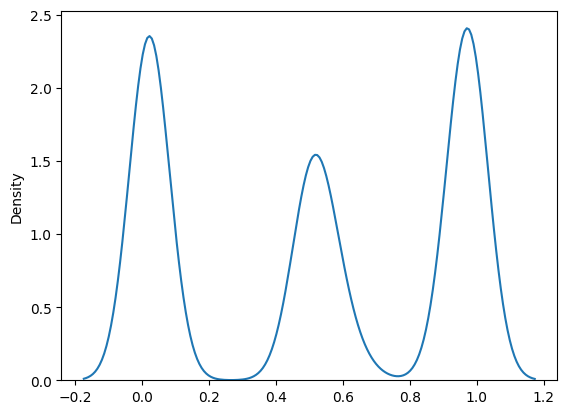

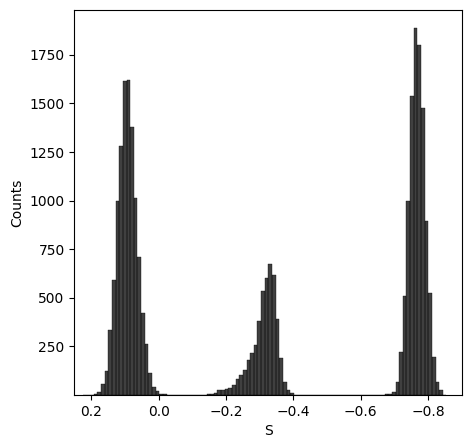

In [ ]:
save_dir = os.path.join(droot,f'fig3/figures')
temp = np.hstack((mixA.fs_tot[np.logical_and(mixA.ids_b,mixA.fs_tot[:,1]>=0.5),0],1-mixA.fs_tot[np.logical_and(mixA.ids_b,mixA.fs_tot[:,0]>0.5),1]))

fig, ax1 = plt.subplots()
my_kde = sns.kdeplot(ax=ax1,data=temp)
line = my_kde.lines[0]
x, y_1 = line.get_data()
y_1 = y_1[np.logical_and(x>=0,x<=1)]

v = (mixA.dx*np.array([1,0])+mixA.dy*np.array([0,1]))
p0 = mixA.pc_pks[0]
# thresh = threshold_otsu(np.sum(np.nan_to_num(mixA.intensity),axis=-1))
# binary = np.sum(mixA.intensity,axis=-1) < thresh
temp_x = mixA.phasor_coords[~mixA.binary,0].flatten()
temp_y = mixA.phasor_coords[~mixA.binary,1].flatten()

temp = np.dstack((temp_x,temp_y))
x = np.linspace(mixA.vertices[1,0],mixA.vertices[-2,0],len(y_1))
a = mixA.dy/mixA.dx
b = mixA.vertices[0,1] - a*np.amin(mixA.vertices[1,0])
y = a*x+b

x_proj = v*(np.sum(v*(temp[0]-p0),axis=1)/np.dot(v,v))[:,None]+p0

x_proj_new = np.vstack((x_proj,np.dstack((x,y))[0]))

fig, ax1 = plt.subplots(figsize=(5,5))

sns.histplot(ax=ax1,data=x_proj_new[:,1],color='k',bins=100)

ax1.set_xlim([-0.9,0.25])
plt.gca().set_ylim(bottom=1)
plt.gca().invert_xaxis()
ax1.set_xlabel(r'S')
ax1.set_ylabel(r'Counts')

# plt.savefig(os.path.join(save_dir,f'A_phasor_hist.svg'),dpi=300)

Text(0, 0.5, 'Counts')

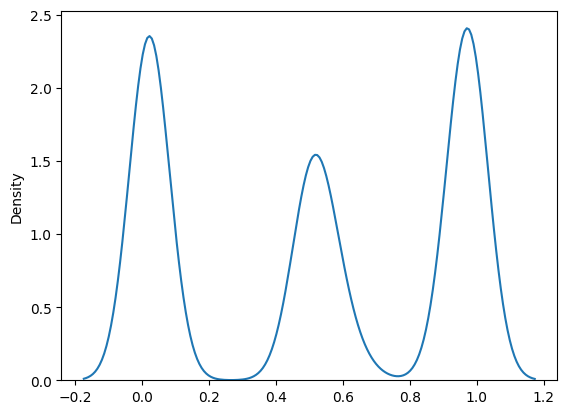

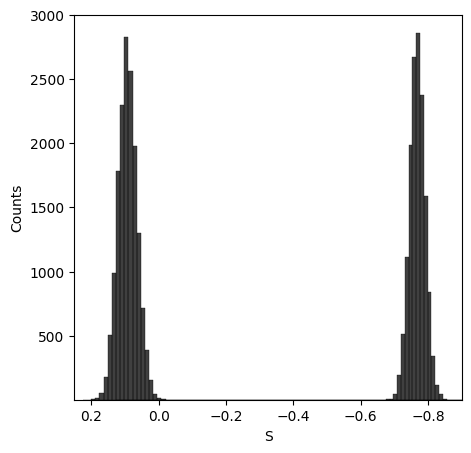

In [ ]:
save_dir = os.path.join(droot,f'fig3/figures')
temp = np.hstack((mixA.fs_tot[np.logical_and(mixA.ids_b,mixA.fs_tot[:,1]>=0.5),0],1-mixA.fs_tot[np.logical_and(mixA.ids_b,mixA.fs_tot[:,0]>0.5),1]))

fig, ax1 = plt.subplots()
my_kde = sns.kdeplot(ax=ax1,data=temp)
line = my_kde.lines[0]
x, y_1 = line.get_data()
y_1 = y_1[np.logical_and(x>=0,x<=1)]

v = (mixA.dx*np.array([1,0])+mixA.dy*np.array([0,1]))
p0 = mixA.pc_pks[0]

temp_x = pc1_spec_test.phasor_coords[~pc1_spec_test.binary,0].flatten()
temp_y = pc1_spec_test.phasor_coords[~pc1_spec_test.binary,1].flatten()

temp = np.dstack((temp_x,temp_y))

x = np.linspace(mixA.vertices[1,0],mixA.vertices[-1,0],len(y_1))
a = mixA.dy/mixA.dx
b = mixA.vertices[0,1] - a*np.amin(mixA.vertices[1,0])
y = a*x+b

x_proj = v*(np.sum(v*(temp[0]-p0),axis=1)/np.dot(v,v))[:,None]+p0

x_proj_new = np.vstack((x_proj,np.dstack((x,y))[0]))


temp_x = pc2_spec_test.phasor_coords[~pc2_spec_test.binary,0].flatten()
temp_y = pc2_spec_test.phasor_coords[~pc2_spec_test.binary,1].flatten()

temp = np.dstack((temp_x,temp_y))

x = np.linspace(mixA.vertices[1,0],mixA.vertices[-1,0],len(y_1))
a = mixA.dy/mixA.dx
b = mixA.vertices[0,1] - a*np.amin(mixA.vertices[1,0])
y = a*x+b

x_proj = v*(np.sum(v*(temp[0]-p0),axis=1)/np.dot(v,v))[:,None]+p0

x_proj_new_1 = np.vstack((x_proj,np.dstack((x,y))[0]))

fig, ax1 = plt.subplots(figsize=(5,5))

sns.histplot(ax=ax1,data=x_proj_new[:,1],color='k',bins=100)
sns.histplot(ax=ax1,data=x_proj_new_1[:,1],color='k',bins=100)

ax1.set_xlim([-0.9,0.25])
plt.gca().set_ylim(bottom=1)
plt.gca().invert_xaxis()
ax1.set_xlabel(r'S')
ax1.set_ylabel(r'Counts')

# plt.savefig(os.path.join(save_dir,f'A_AF561_AF647_phasor_hist.svg'),dpi=300)

# Figure 4

In [195]:
### Function to simulate a multispectral image from a single intensity image as input
data_dir_sim = os.path.join(droot,f'fig4/')

def sim_spectral_image_dist(im_file, params):
    
    lpks = params['l_file']
    sig = params['sig']
    lambdas = params['lambdas']
    ints = tifffile.imread(im_file)
    img_shape = ints.shape
    gain = params['gain']
    readnoise = params['readnoise']
    nphtns = params['nphtns']
    bg = np.random.normal(readnoise,np.sqrt(readnoise),(img_shape[0]*img_shape[1],nphtns))
    pc_file = np.loadtxt(lpks,delimiter=',',skiprows=1)
    prob = pc_file[:,-1]/np.sum(pc_file[:,-1])
    temp = gain*(np.random.choice(np.arange(pc_file[0,0],pc_file[-1,0]+1), p=prob,size=(img_shape[0]*img_shape[1],nphtns))+bg)
    temp[temp<0] = 0.0
    temp2 = [np.histogram(sim,lambdas) for sim in temp]
    sim_im1 = np.multiply(np.reshape(np.array([temp2[j][0] for j in range(len(temp2))]),(img_shape[0],img_shape[1],32)),ints[:,:,np.newaxis]).astype('float32')
    ls = np.array(temp2[0][1][1:])
    
    return sim_im1, ls

To best display phasor plots in these simulated images, an intensity threshold is applied using Otsu's method.  
This removes the large number of background pixels which skews the displayed density of phasor points.  
All analysis was performed without this threshold applied.

## A

#### Simulate Multispectral Images (The resulting images are given in the data directory)

In [ ]:
### Simulate single- and two-color multispectral images from single intensity image inputs
data_dir_sim = os.path.join(droot,f'fig4/')
params = {'l_file' : data_dir_sim+'af561.csv', 'sig' : 10, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'A_ch1.tiff'

imA, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'A_ch1_af561_spec.tif',np.moveaxis(imA,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

params = {'l_file' : data_dir_sim+'af647.csv', 'sig' : 10, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'A_ch2.tiff'

imB, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'A_ch2_af647_spec.tif',np.moveaxis(imB,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

im_comb = 1.0*imA + 1.0*imB
tifffile.imwrite(data_dir_sim+'A_afcomb_spec.tif',np.moveaxis(im_comb,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

#### Analysis

Finished clustering data for AF561...
Determined peak at [-0.93874972  0.09900877]for AF561
Finished clustering data for AF647...
Determined peak at [-0.55102041 -0.76573912]for AF647
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93874972  0.09900877]
AF647 is already clustered... Peak at [-0.55102041 -0.76573912]
test has a colocalization factor of [0.20312058 0.32996988]
Threshold method not given by requested. Using Otsu
0.7422759929511236 0.2517386512574018 0.25713285290711113


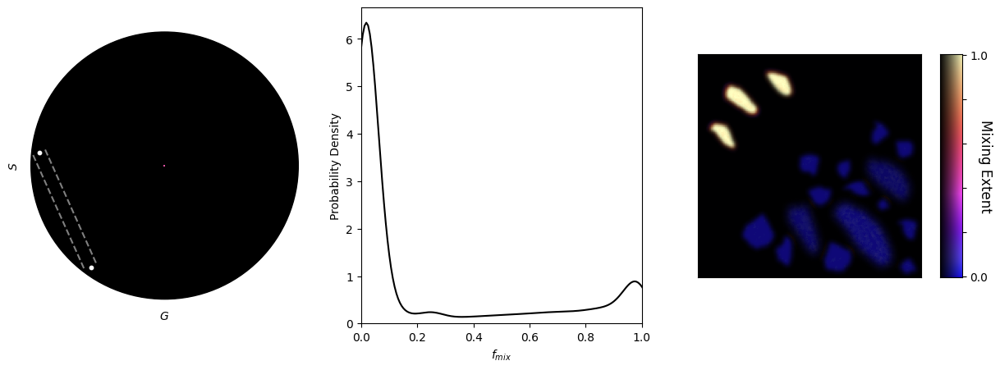

In [53]:
### Determine the PC coordinates from single-color images
data_dir_sim = os.path.join(droot,f'fig4/')
pc1_spec_test = PC(file=data_dir_sim+'A_ch1_af561_spec.tif',name='AF561',thresh=None)
pc2_spec_test = PC(file=data_dir_sim+'A_ch2_af647_spec.tif',name='AF647',thresh=None)

pc1_spec_test.determine_peak(pk_flag='test')

pc2_spec_test.determine_peak(pk_flag='test')

### Calculate the colocalization and mixing from the two-color sample
mixA = PairMixture(file=data_dir_sim + 'A_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True)

mixA.analyze_overlap(p_max=0.75,lims=[0,100])

mixA.calc_pearson_mander(pcs=mixA.purecomps,thresh_override=True)
print(mixA.pearsons,mixA.manders1,mixA.manders2)

### Plots for Display Purposes Only

AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.31604464 0.23923885]


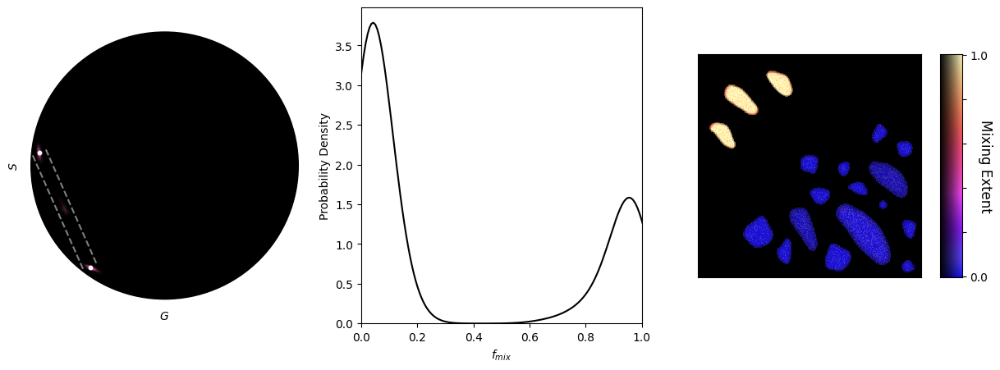

In [234]:
mixA = PairMixture(file=data_dir_sim + 'A_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh='otsu')
mix_choice = mixA
mix_choice.analyze_overlap(plot=True)

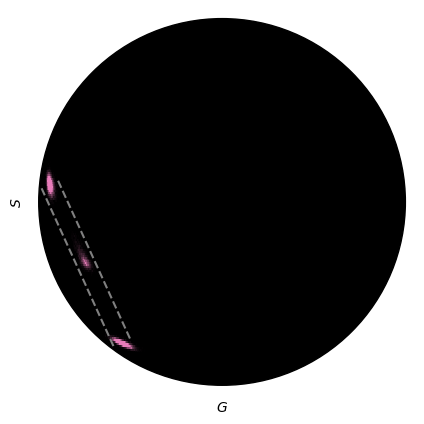

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax = plt.subplots(figsize=(5,5))
mix_choice.plot_phasor(ax1=ax,p_max=0.5)
ax.plot([mix_choice.vertices[0,0],mix_choice.vertices[3,0]],[mix_choice.vertices[0,1],mix_choice.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_choice.vertices[1,0],mix_choice.vertices[2,0]],[mix_choice.vertices[1,1],mix_choice.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'A_phasor_band_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

Text(0, 0.5, 'Probability Density')

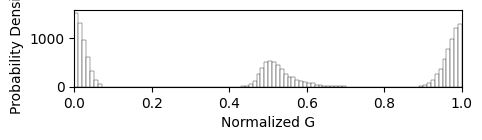

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(5,1))
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w',bins=100)
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'A_mixture_band_hist.svg'),format='svg',dpi=300)

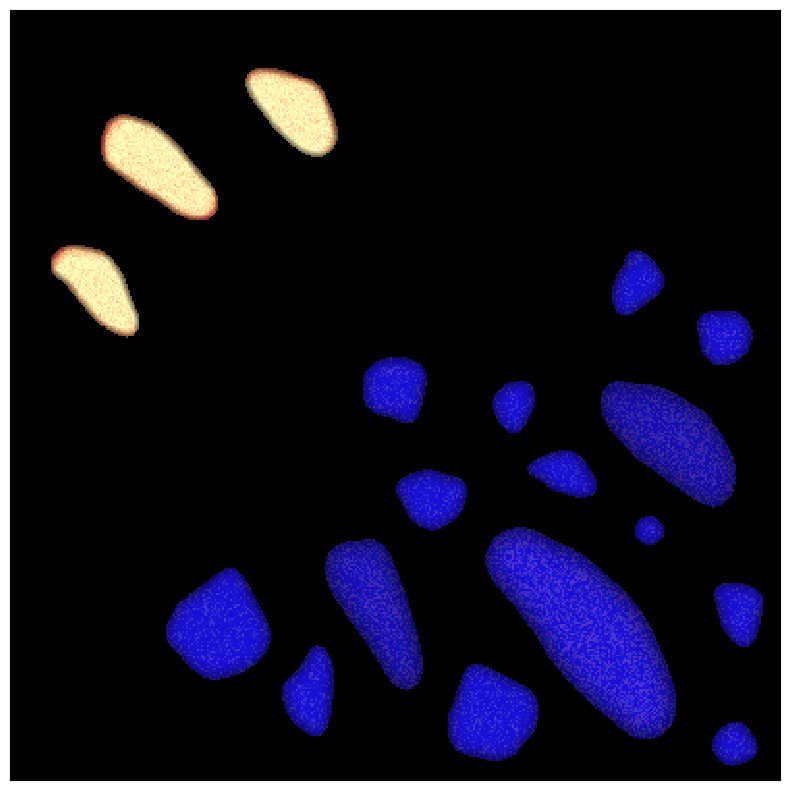

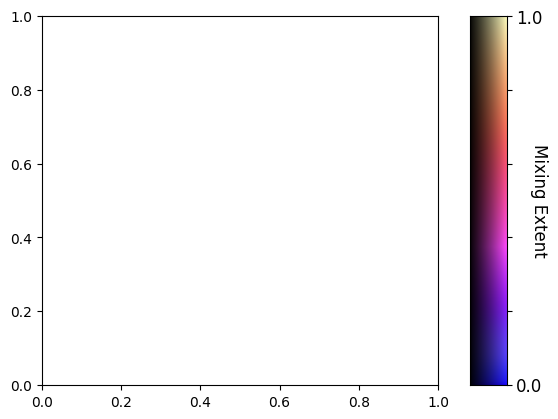

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'A_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

fig1, ax1 = plt.subplots()
divider = make_axes_locatable(ax1)
ax = divider.append_axes('right',size='25%',pad=0.005)
ax.imshow(np.flipud(mix_choice.LUT_2D))
ax.set_aspect(10.0)
ax.set_xticks([])
ax.set_yticks(np.arange(0,256,51),['1.0','','','','','0.0'],fontsize=12)
ax.yaxis.tick_right()
ax.yaxis.set_label_position("right")
ax.yaxis.set_label_text('Mixing Extent',rotation=-90,fontsize=12)
# plt.savefig(os.path.join(save_dir,f'2DLUT_colorbar.svg'),dpi=300)

## B

#### Simulate Multispectral Images (The resulting images are given in the data directory)

In [ ]:
### Simulate single- and two-color multispectral images from single intensity image inputs
data_dir_sim = os.path.join(droot,f'fig4/')
params = {'l_file' : data_dir_sim+'af561.csv', 'sig' : 30, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'B_ch1_new.tiff'

imA, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'B_ch1_af561_spec_new.tif',np.moveaxis(imA,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

params = {'l_file' : data_dir_sim+'af647.csv', 'sig' : 30, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'B_ch2.tiff'

imB, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'B_ch2_af647_spec.tif',np.moveaxis(imB,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

im_comb = 1.0*imA + 1.0*imB
tifffile.imwrite(data_dir_sim+'B_afcomb_spec.tif',np.moveaxis(im_comb,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

### Analysis

Finished clustering data for AF561...
Determined peak at [-0.93480406  0.09508337]for AF561
Finished clustering data for AF647...
Determined peak at [-0.55533909 -0.76484555]for AF647
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93480406  0.09508337]
AF647 is already clustered... Peak at [-0.55533909 -0.76484555]
test has a colocalization factor of [0.19917877 0.59820605]
Threshold method not given by requested. Using Otsu
-0.04169820544426925 0.1592225606429861 0.9997641044751979


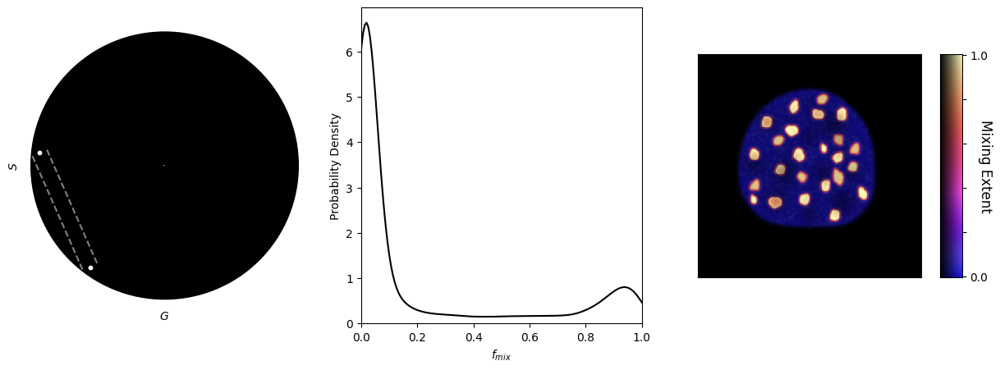

In [54]:
### Determine the PC coordinates from single-color images
data_dir_sim = os.path.join(droot,f'fig4/')
pc1_spec_test = PC(file=data_dir_sim+'B_ch1_af561_spec_new.tif',name='AF561',thresh=None)
pc2_spec_test = PC(file=data_dir_sim+'B_ch2_af647_spec.tif',name='AF647',thresh=None)

pc1_spec_test.determine_peak(pk_flag='test')
pc2_spec_test.determine_peak(pk_flag='test')
### Calculate the colocalization and mixing from the two-color sample
mixB = PairMixture(file=data_dir_sim + 'B_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True)

mixB.analyze_overlap(p_max=0.75,lims=[0,100])
mixB.calc_pearson_mander(pcs=mixB.purecomps,thresh_override=True)
print(mixB.pearsons,mixB.manders1,mixB.manders2)

### Plots for Display Purposes Only

AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.26986121 0.66866605]


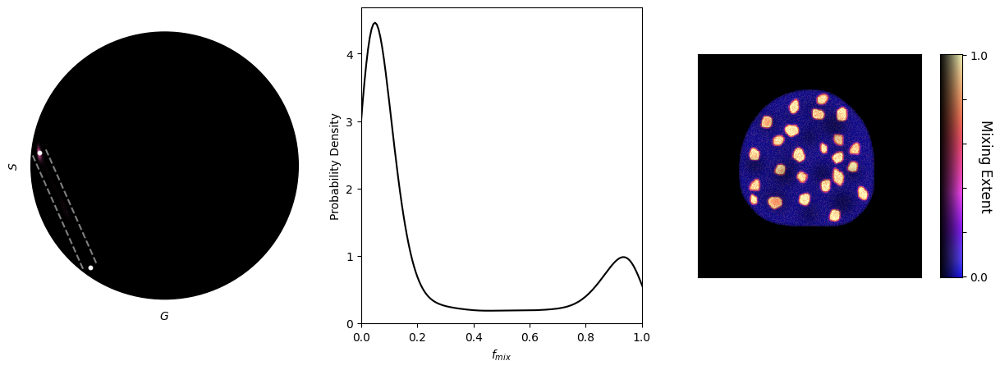

In [228]:
mixB = PairMixture(file=data_dir_sim + 'B_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh='otsu')
mix_choice = mixB
mix_choice.analyze_overlap(plot=True)

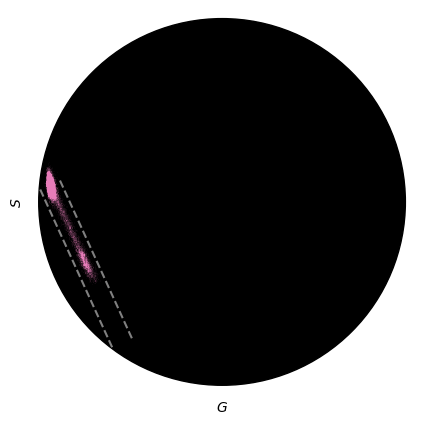

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax = plt.subplots(figsize=(5,5))
mix_choice = mixB
mix_choice.plot_phasor(ax1=ax,p_max=0.25)
ax.plot([mix_choice.vertices[0,0],mix_choice.vertices[3,0]],[mix_choice.vertices[0,1],mix_choice.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_choice.vertices[1,0],mix_choice.vertices[2,0]],[mix_choice.vertices[1,1],mix_choice.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.koin(save_dir,f'B_phasor_band_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

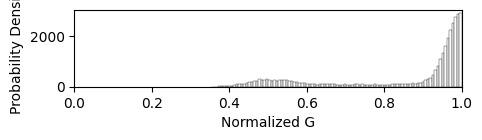

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(5,1))
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w',bins=100)
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'B_mixture_band_hist.svg'),format='svg',dpi=300)

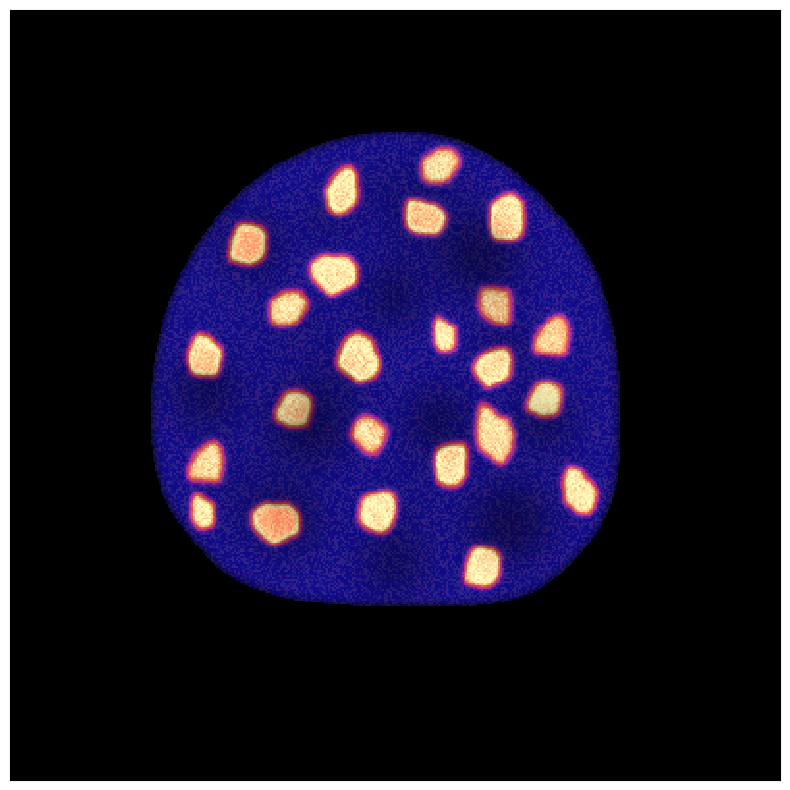

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'B_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

## C

#### Simulate Multispectral Images (The resulting images are given in the data directory)

In [ ]:
### Simulate single- and two-color multispectral images from single intensity image inputs
data_dir_sim = os.path.join(droot,f'fig4/')
params = {'l_file' : data_dir_sim+'af561.csv', 'sig' : 30, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'C_ch1_new.tiff'

imA, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'C_ch1_af561_spec_new.tif',np.moveaxis(imA,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

params = {'l_file' : data_dir_sim+'af647.csv', 'sig' : 30, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'C_ch2_new.tiff'

imB, ls = sim_spectral_image_dist(fname,params)
tifffile.imwrite(data_dir_sim+'C_ch2_af647_spec_new.tif',np.moveaxis(imB,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

im_comb = 1.0*imA + 1.0*imB
tifffile.imwrite(data_dir_sim+'C_afcomb_spec_new.tif',np.moveaxis(im_comb,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

### Analysis

Finished clustering data for AF561...
Determined peak at [-0.93764371  0.09812046]for AF561
Finished clustering data for AF647...
Determined peak at [-0.55547238 -0.76442206]for AF647
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.57378986 0.59192426]
Threshold method not given by requested. Using Otsu
0.02540226063015219 0.6922629477980731 0.999796881444184


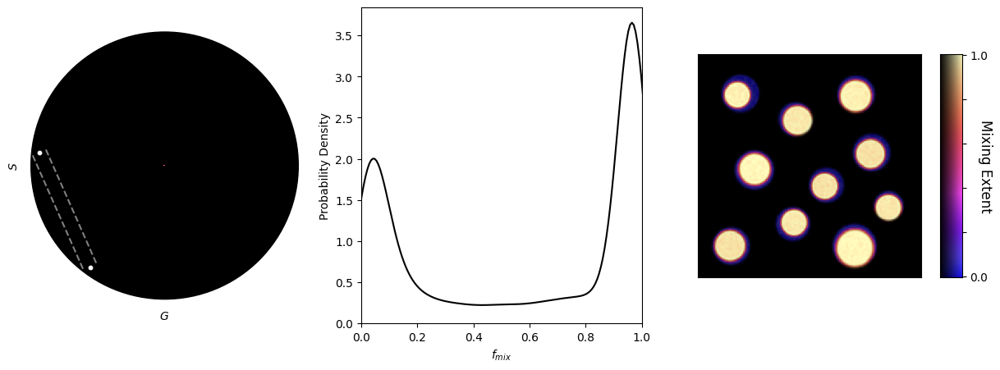

In [55]:
### Determine the PC coordinates from single-color images
data_dir_sim = os.path.join(droot,f'fig4/')
pc1_spec_test = PC(file=data_dir_sim+'C_ch1_af561_spec_new.tif',name='AF561',thresh=None)
pc2_spec_test = PC(file=data_dir_sim+'C_ch2_af647_spec_new.tif',name='AF647',thresh=None)

pc1_spec_test.determine_peak(pk_flag='test')
pc2_spec_test.determine_peak(pk_flag='test')
### Calculate the colocalization and mixing from the two-color sample
mixC = PairMixture(file=data_dir_sim + 'C_afcomb_spec_new.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True)

mixC.analyze_overlap(p_max=0.75,lims=[0,100])
mixC.calc_pearson_mander(pcs=mixC.purecomps,thresh_override=True)
print(mixC.pearsons,mixC.manders1,mixC.manders2)

### Plots for Display Purposes Only

AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.67752559 0.65472508]


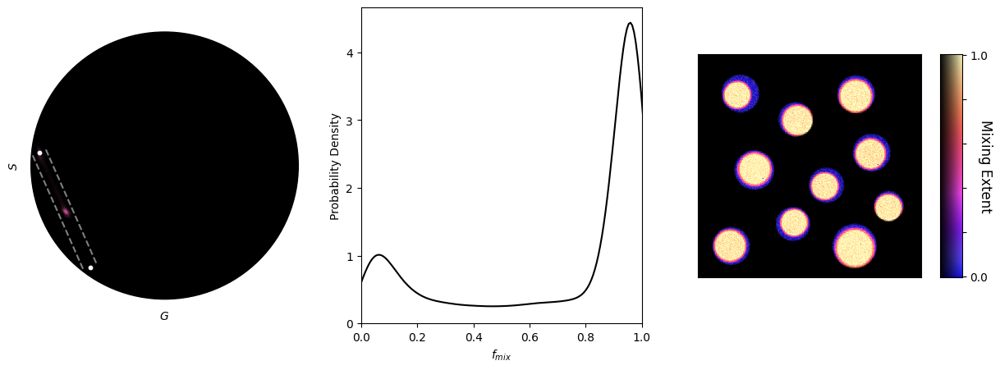

In [248]:
mixC = PairMixture(file=data_dir_sim + 'C_afcomb_spec_new.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh='li')
mix_choice = mixC
mix_choice.analyze_overlap(plot=True,lims=[0,85])

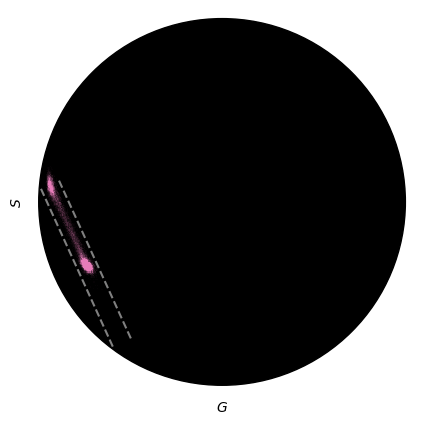

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax = plt.subplots(figsize=(5,5))
mix_choice = mixC
mix_choice.plot_phasor(ax1=ax,p_max=0.5)
ax.plot([mix_choice.vertices[0,0],mix_choice.vertices[3,0]],[mix_choice.vertices[0,1],mix_choice.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_choice.vertices[1,0],mix_choice.vertices[2,0]],[mix_choice.vertices[1,1],mix_choice.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'C_phasor_band_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

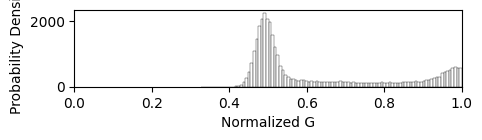

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(5,1))
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w',bins=100)
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'C_mixture_band_hist.svg'),format='svg',dpi=300)

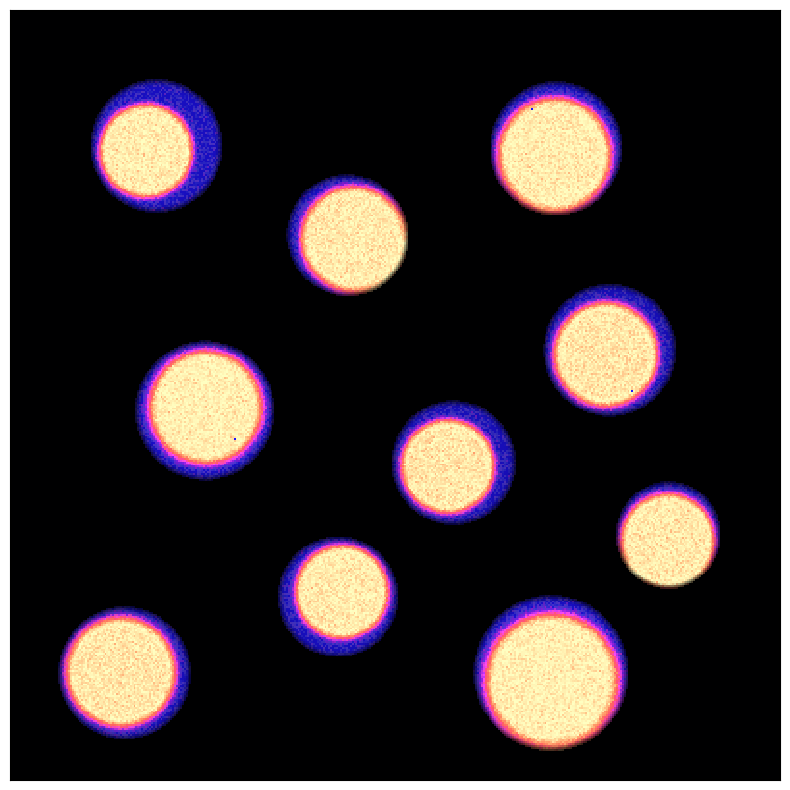

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'C_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

### Intensity Imbalance Effects (Fig S8)

In [253]:
data_dir_sim = os.path.join(droot,f'fig_s8/')

In [ ]:
params = {'l_file' : data_dir_sim+'af647.csv', 'sig' : 10, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
imA = tifffile.imread(os.path.join(data_dir_sim,'C_ch1_af561_spec_new.tif'))
ns = ['0p9','0p8','0p6','0p4','0p2']
for n in ns:
    fname = os.path.join(data_dir_sim,'C_ch2_new_' + n +'.tif')

    imB, ls = sim_spectral_image_dist(fname,params)
    tifffile.imwrite(data_dir_sim+'C_ch2_r'+n+'_af647_spec.tif',np.moveaxis(imB,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

    im_comb = 1.0*np.moveaxis(imA,0,-1) + 1.0*imB
    tifffile.imwrite(data_dir_sim+'C_afcomb_'+n+'_spec.tif',np.moveaxis(im_comb,-1,0),imagej=True,metadata={'axes' : 'CYX', 'Labels' : [f'{l}' for l in ls]})

Finished clustering data for AF561...
Determined peak at [-0.93764371  0.09812046]for AF561
Finished clustering data for AF647...
Determined peak at [-0.55547238 -0.76442206]for AF647
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.57378986 0.59192426]
Threshold method not given by requested. Using Otsu
[0.02540226063015219, 0.6922629477980731, 0.999796881444184]
0.5878116743057713
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor of [0.52740153 0.61584238]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
test has a colocalization factor

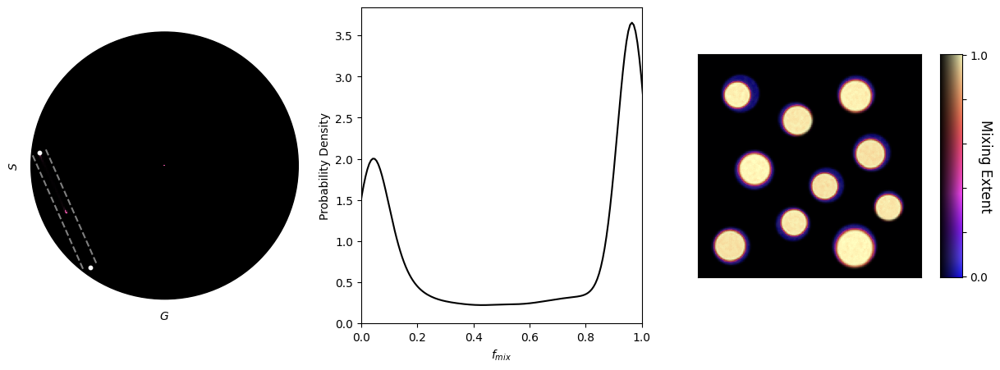

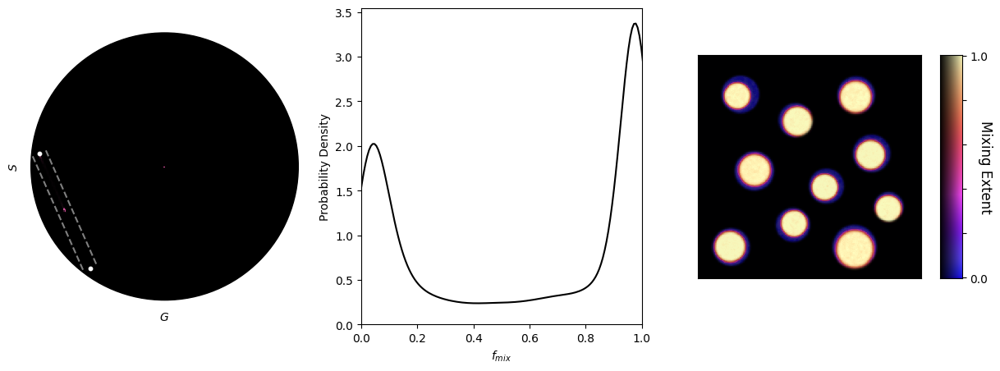

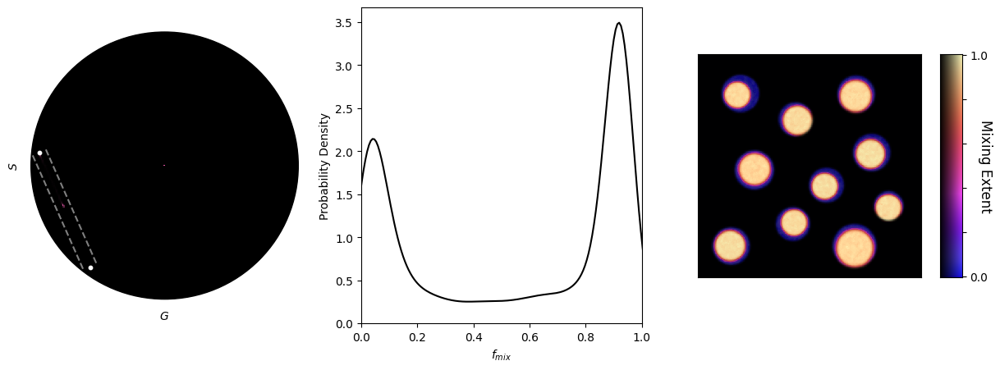

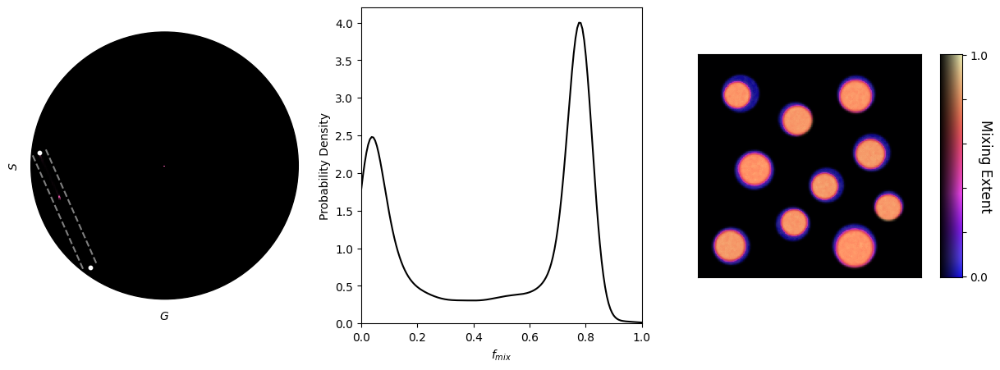

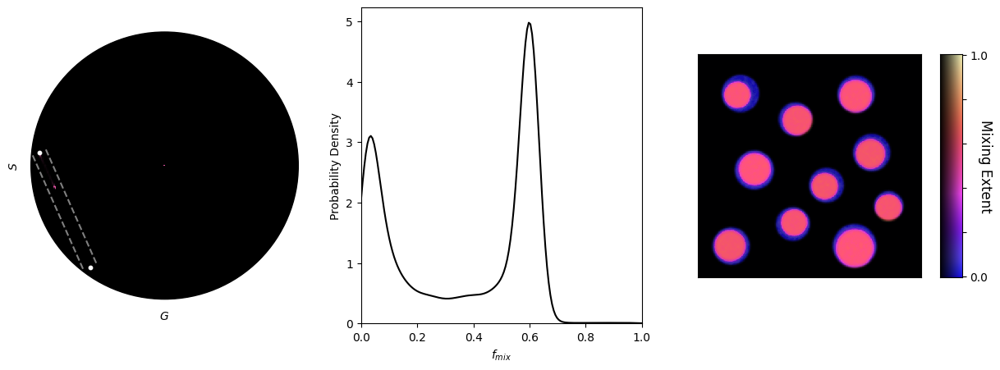

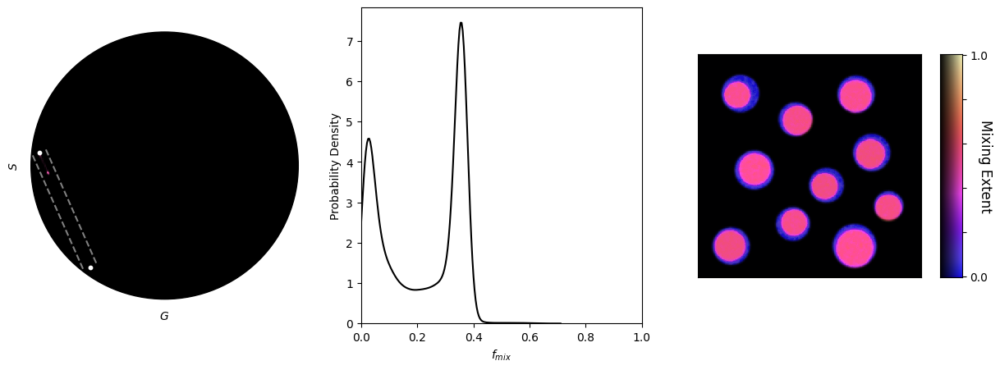

In [254]:
pc1_spec_test = PC(file=data_dir_sim+'C_ch1_af561_spec_new.tif',name='AF561',thresh=None)
pc2_spec_test = PC(file=data_dir_sim+'C_ch2_af647_spec_new.tif',name='AF647',thresh=None)

pc1_spec_test.determine_peak(pk_flag='test')

pc2_spec_test.determine_peak(pk_flag='test')

exps_c = dict()

### Calculate the colocalization and mixing from the two-color sample
rs = np.arange(6)
pmcs = np.zeros(len(rs))
pmcs_var = np.zeros(len(rs))
pearsons = np.zeros(len(rs))
manders1 = np.zeros(len(rs))
manders2 = np.zeros(len(rs))
mandersO = np.zeros(len(rs))

mix = PairMixture(file=os.path.join(data_dir_sim,'C_afcomb_spec_new.tif'),name='test',
                pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True)

exps_c['control'] = mix

mix.analyze_overlap(p_max=0.25,lims=[0,100])

mix.calc_pearson_mander(pcs=mix.purecomps,thresh_override=True)
print([mix.pearsons,mix.manders1,mix.manders2])
print(mix.band_cov)

pmcs[0] = mix.coloc_vec[0]
pmcs_var[0] = mix.coloc_vec[1]
pearsons[0] = mix.pearsons
manders1[0] = mix.manders1
manders2[0] = mix.manders2
mandersO[0] = mix.mandersO

ns = ['0p9','0p8','0p6','0p4','0p2']
offset = np.amin(rs)+1

for j, n in zip(range(len(ns)),ns):

    mix = PairMixture(file=os.path.join(data_dir_sim,'C_afcomb_'+n+'_spec.tif'),name='test',
                    pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True)

    mix.analyze_overlap(p_max=0.25,lims=[0,100])

    mix.calc_pearson_mander(pcs=mix.purecomps,thresh_override=True)
    
    pmcs[j+offset] = mix.coloc_vec[0]
    pmcs_var[j+offset] = mix.coloc_vec[1]
    pearsons[j+offset] = mix.pearsons
    manders1[j+offset] = mix.manders1
    manders2[j+offset] = mix.manders2
    mandersO[j+offset] = mix.mandersO
    
    exps_c[n] = mix

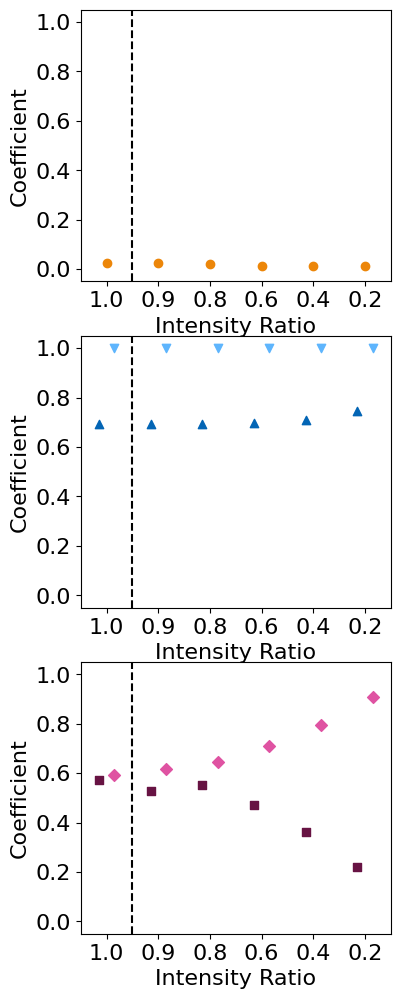

In [ ]:
### Plot the colocalization and mixing coefficients for each example in Figure 4
save_dir = os.path.join(data_dir_sim,'figures/')
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(4,12))
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']
xs = [0.0,0.125,0.175,0.275,0.325]
markers = ['o','^','v','s','D']

for j, axes in zip(range(len(ax.ravel())),ax.ravel()):
    if j==0:
        d = pearsons
        axes.scatter(rs,d,color=colors[j],marker=markers[j])
    elif j==1:
        d1 = manders1
        d2 = manders2
        axes.scatter(rs-0.15,d1,color=colors[j],marker=markers[j])
        axes.scatter(rs+0.15,d2,color=colors[j+1],marker=markers[j+1])
    elif j==2:
        d1 = pmcs
        d2 = pmcs_var
        axes.scatter(rs-0.15,d1,color=colors[-2],marker=markers[-2])
        axes.scatter(rs+0.15,d2,color=colors[-1],marker=markers[-1])
    else:
        continue
    
    axes.axvline(x=np.amin(rs)+0.5,color='k',linestyle='--')
    axes.set_ylim([-0.05,1.05])
    axes.set_xlim([np.amin(rs)-0.5,np.amax(rs)+0.5])
    axes.set_xticks(rs,labels=['1.0','0.9','0.8','0.6','0.4','0.2'],rotation=0,fontsize=16)
    axes.set_yticks(np.arange(0.0,1.1,0.2),labels=['0.0','0.2','0.4','0.6','0.8','1.0'],fontsize=16)
    axes.set_ylabel('Coefficient',fontsize=16)
    axes.set_xlabel('Intensity Ratio',fontsize=16)
    
# fig.savefig(os.path.join(save_dir,f'C_intensity_imbalance_coeffs.svg'),dpi=300)

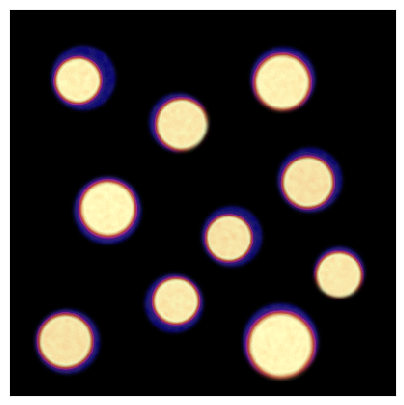

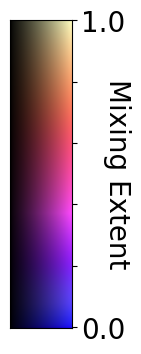

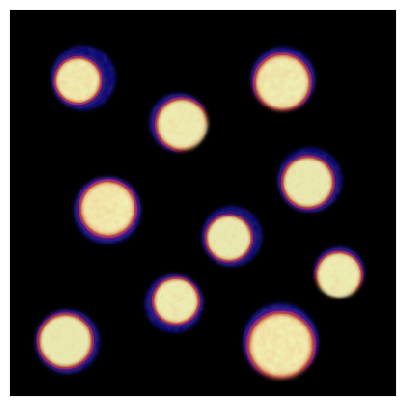

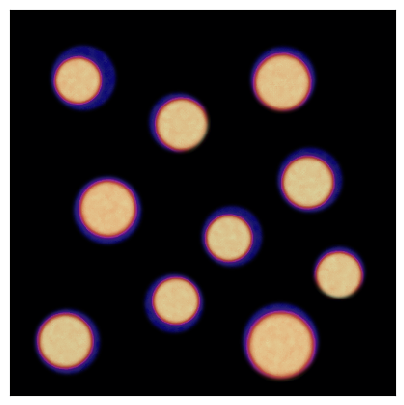

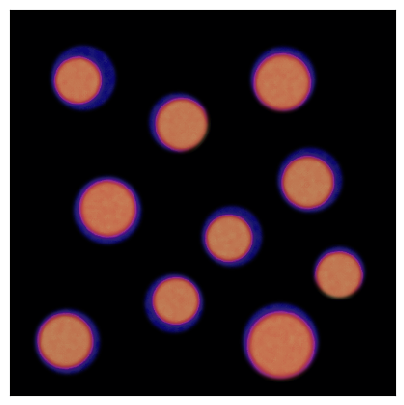

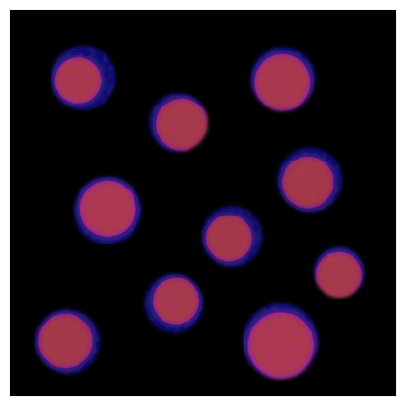

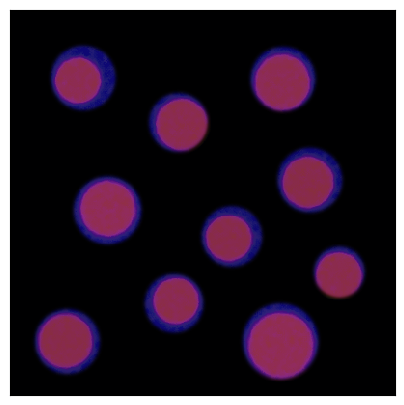

In [ ]:
save_dir = os.path.join(data_dir_sim,'figures/')
obj='magma'
cmap = mpl.colormaps.get_cmap(obj)
# fig, axes = plt.subplots(nrows=1,ncols=6,figsize=(15,5))

# for key, ax1 in zip(exps_c,axes.ravel()):
for key in exps_c:
    mix_choice = exps_c[key]
    test, test_im = im2DLUT(np.reshape(mix_choice.fs_norm,mix.img_mean.shape),mix_choice.img_mean,cmap=cmap,intLim=np.percentile(exps_c['control'].img_mean,[2,99]))
    # CS = ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
    fig, ax = plt.subplots(figsize=(5,5))
    CS = ax.pcolormesh(np.flipud(test_im))

    ax.set_aspect('equal'); 
    ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        labelbottom=False,
        left=False,
        right=False,
        labelleft=False
    )
    # plt.savefig(os.path.join(save_dir,f'C_'+key+'_mixing_image_2DLUT.png'),dpi=300,transparent=True,bbox_inches='tight')
    
    if key == 'control':
        fig, ax1 = plt.subplots(figsize=(2,4))
        
        ax1.imshow(np.flipud(test))
        ax1.set_aspect(5.0)
        ax1.set_xticks([])
        ax1.set_yticks(np.arange(0,256,51),['1.0','','','','','0.0'],fontsize=20)
        ax1.yaxis.tick_right()
        ax1.yaxis.set_label_position("right")
        ax1.yaxis.set_label_text('Mixing Extent',rotation=-90,fontsize=20)
        # plt.savefig(os.path.join(save_dir,f'C_2DLUT.png'),dpi=300,transparent=True,bbox_inches='tight')
    

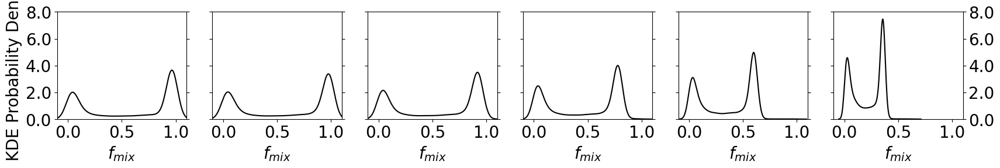

In [ ]:
save_dir = os.path.join(data_dir_sim,'figures/')
fig, axes = plt.subplots(nrows=1,ncols=6,figsize=(20,5))

for key, ax in zip(exps_c,axes.ravel()):
    mix_choice = exps_c[key]
    sns.kdeplot(ax=ax,data=mix_choice.fs_norm[mix_choice.ids_b],color='k')
    ax.set_xlim([-0.1,1.1])
    ax.set_ylim([0.0,8.0])
    ax.set_aspect(1/8)
    if key=='control':
        
        ax.set_yticks(np.arange(0.0,8.1,2),[str(i) for i in np.arange(0.0,8.1,2)],fontsize=20)
        ax.set_ylabel('KDE Probability Density',fontsize=20)
    elif key=='0p2':
        ax.set_yticks(np.arange(0.0,8.1,2),[str(i) for i in np.arange(0.0,8.1,2)],fontsize=20)
        ax.yaxis.tick_right()
        ax.set_ylabel('')
        
    else:
        ax.set_yticks(np.arange(0.0,8.1,2),['' for i in np.arange(0.0,8.1,2)],fontsize=20)
        ax.set_ylabel('')
    ax.yaxis.set_ticks_position('both')
    ax.set_xticks(np.arange(0.0,1.1,0.5),[str(i) for i in np.arange(0.0,1.1,0.5)],fontsize=20)
    ax.set_xlabel(r'$f_{mix}$',fontsize=20)
    
# fig.savefig(os.path.join(save_dir,f'C_intensity_imbalance_fmix.svg'),dpi=300)

## Sim Stats

[0.7422759929511236, 0.2517386512574018, 0.25713285290711113, 0.17907463665898102, 0.16448783477092696]
[-0.04169820544426925, 0.1592225606429861, 0.9997641044751979, 0.20852481029617567, 0.5871519638880456]
[0.02540226063015219, 0.6922629477980731, 0.999796881444184, 0.5556836131384297, 0.5965662585958509]


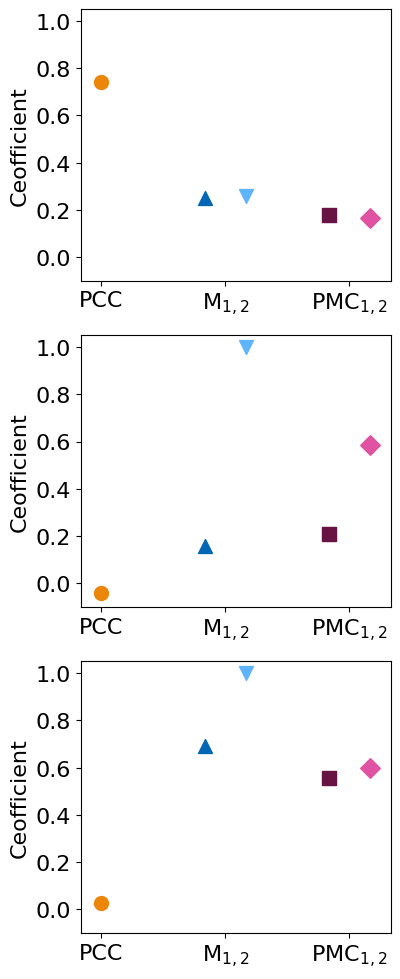

In [ ]:
save_dir = os.path.join(droot,'fig4/figures')
### Plot the colocalization and mixing coefficients for each example in Figure 4
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(4,12))
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']
xs = [0.0,0.125,0.175,0.275,0.325]
markers = ['o','^','v','s','D']
data = [mixA,mixB,mixC]
for j, axes in zip(range(len(data)),ax.ravel()):
    d = [data[j].pearsons,data[j].manders1,data[j].manders2,data[j].coloc_vec[0],data[j].coloc_vec[1]]
    print(d)
    for jj in range(len(xs)):
        axes.scatter(xs[jj],d[jj],c=colors[jj],marker=markers[jj],s=100)
    axes.set_ylim([-0.1,1.05])
    axes.set_xlim([-0.025,0.35])
    axes.set_xticks([0.0,0.15,0.3],labels=['PCC',r'M$_{1,2}$',r'PMC$_{1,2}$'],rotation=0,fontsize=16)
    axes.set_yticks(np.arange(0.0,1.1,0.2),labels=['0.0','0.2','0.4','0.6','0.8','1.0'],fontsize=16)
    axes.set_ylabel('Ceofficient',fontsize=16)

# fig.savefig(os.path.join(save_dir,f'A_B_C_coeffs_new_color_corrected_sep.svg'),dpi=300)

# Figure 5

## Mito-Mito

### PCs

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.26318282 0.66654808]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62000249 -0.15956851]for AF568


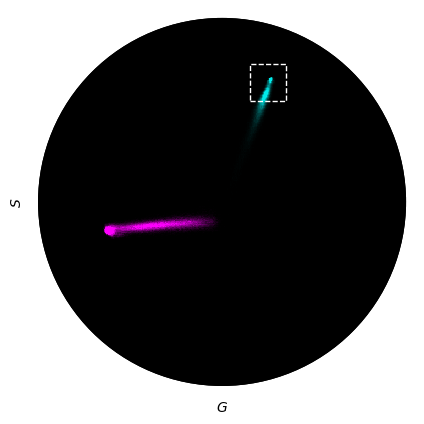

In [56]:
### Determine the PC coordinates in single-color samples

data_dir = os.path.join(droot,f'fig5/mito-mito/')

pc1_test = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
pc2_test = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh=None,filt=True,ver=0,crop_dims=None)

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

raw_pk = pc1_test.pks_l

fig, ax = plt.subplots(figsize=(5,5))
pc1_test.plot_phasor(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']),p_max=0.75)
pc2_test.plot_phasor(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#fd00fdff']),p_max=0.75)
ax.add_patch(plt.Rectangle((.15, .55), .2, .2, ls="--", ec="w", fc="none"))

save_dir = os.path.join(droot,'fig_s3')

# fig.savefig(os.path.join(save_dir,'raw_pcs.png'),dpi=300)

##### Thresolded PCs (Fig S5)

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.26283187 0.66982663]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62394424 -0.16130445]for AF568


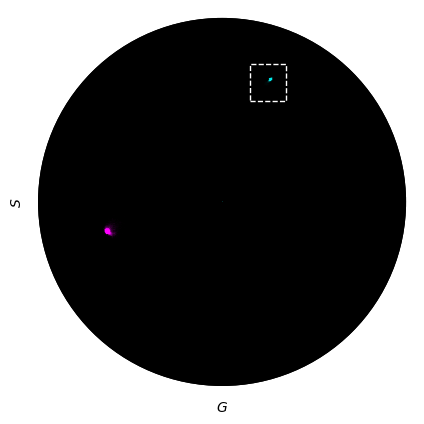

In [57]:
### Determine the PC coordinates after applying an intensity threshold determined by using Otsu's method
data_dir = os.path.join(droot,f'fig5/mito-mito/')

pc1_test_thresh = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh='otsu',filt=True,ver=0,crop_dims=None)
pc2_test_thresh = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh='otsu',filt=True,ver=0,crop_dims=None)


pc1_test_thresh.determine_peak(pk_flag='test')
pc2_test_thresh.determine_peak(pk_flag='test')

thresh_pk = pc1_test_thresh.pks_l

fig, ax = plt.subplots(figsize=(5,5))
pc1_test_thresh.plot_phasor(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']),p_max=0.5)
pc2_test_thresh.plot_phasor(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#fd00fdff']),p_max=0.5)
ax.add_patch(plt.Rectangle((.15, .55), .2, .2, ls="--", ec="w", fc="none"))

save_dir = os.path.join(droot,'fig_s3')

# fig.savefig(os.path.join(save_dir,f'otsu_pcs.png'),dpi=300)

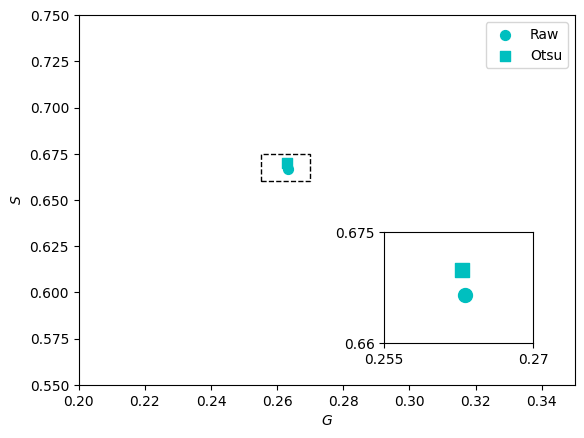

In [ ]:
import matplotlib.pyplot as plt

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

fig, ax = plt.subplots()
ax.scatter(raw_pk[0],raw_pk[1],c='c',marker='o',s=50)
ax.scatter(thresh_pk[0],thresh_pk[1],c='c',marker='s',s=50)
ax.legend(['Raw','Otsu'])
ax.set_xlim([0.2,0.35])
ax.set_ylim([0.55,0.75])

# For visualization purposes we mark the bounding box by a rectangle
x1 = 0.255 
y1 = 0.66
w = 0.015
h = 0.015
ax.add_patch(plt.Rectangle((x1, y1), w, h, ls="--", ec="k", fc="none"))

axins = inset_axes(ax, width="30%", height="30%",loc="lower right",borderpad=3)
axins.set_xlim([x1,x1+w])
axins.set_ylim([y1,y1+h])

axins.set_xticks([x1,x1+w],[str(x) for x in [x1,x1+w]])
axins.set_yticks([y1,y1+h],[str(x) for x in [y1,y1+h]])

axins.scatter(raw_pk[0],raw_pk[1],c='c',marker='o',s=100)
axins.scatter(thresh_pk[0],thresh_pk[1],c='c',marker='s',s=100)

ax.set_xlabel(r'$G$'); ax.set_ylabel(r'$S$')

save_dir = os.path.join(droot,'fig_s3')

# fig.savefig(os.path.join(save_dir,f'threshold_effect_on_pc_pk.svg'),dpi=300)

### Single Cell

#### Display

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.23467492 0.58406678]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62402521 -0.15826097]for AF568
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.23467492 0.58406678]
AF568 is already clustered... Peak at [-0.62402521 -0.15826097]
(256, 256, 3)
(256, 256, 3)
(400, 400)
(400, 400)
mito has a colocalization factor of [0.90632963 0.99503416]
Threshold method not given by requested. Using Otsu
0.9426105188700571
0.994866921091321
0.9658157490112068
0.9772133543283804


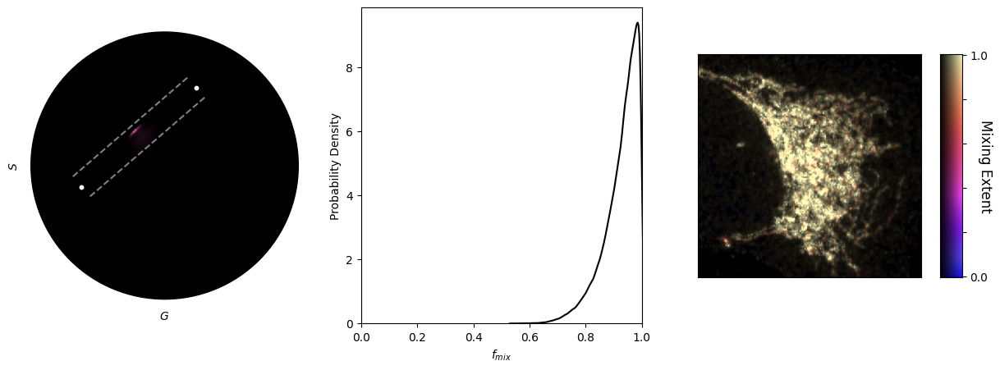

In [300]:
### Calculate the colocalization and mixing for a two-color sample without thresholding
data_dir = os.path.join(droot,f'fig5/mito-mito/')

pc1_test = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
pc2_test = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh=None,filt=True,ver=0,crop_dims=None)

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

crop_dims = [30,430,100,500]

mix_mitomito = PairMixture(file=data_dir+'/5. AF488_AF55_3x_0.8%_0.1%_112.czi',name='mito',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=crop_dims)
mix_mitomito.analyze_overlap()
mix_mitomito.calc_pearson_mander(pcs=mix_mitomito.purecomps,thresh_override=True)
print(mix_mitomito.pearsons)
print(mix_mitomito.mandersO)
print(mix_mitomito.manders1)
print(mix_mitomito.manders2)

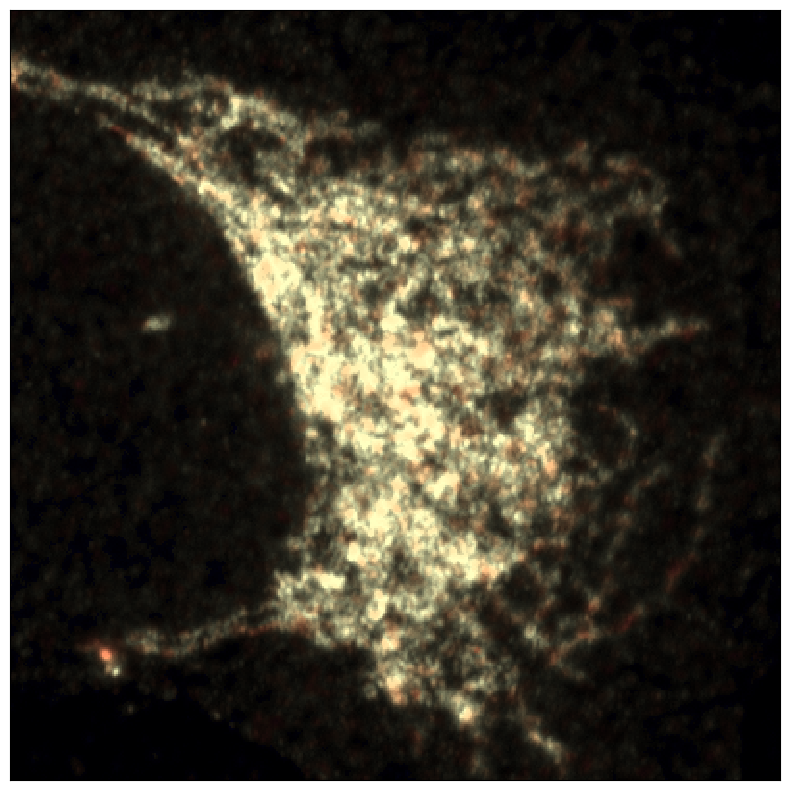

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_mitomito.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'mito_mito_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

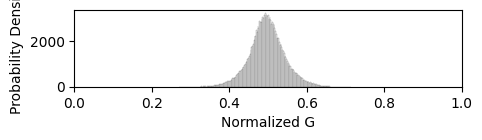

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax1 = plt.subplots(figsize=(5,1))
mix_choice = mix_mitomito
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w')
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'mito_mito_mixture_band_hist_new.svg'),format='svg',dpi=300)

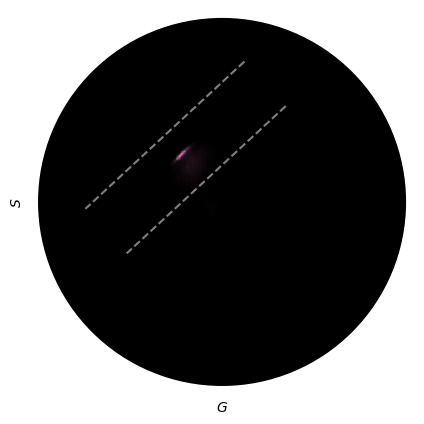

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax = plt.subplots(figsize=(5,5))
mix_mitomito.plot_phasor(ax1=ax)
ax.plot([mix_mitomito.vertices[0,0],mix_mitomito.vertices[3,0]],[mix_mitomito.vertices[0,1],mix_mitomito.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_mitomito.vertices[1,0],mix_mitomito.vertices[2,0]],[mix_mitomito.vertices[1,1],mix_mitomito.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'mito_phasor_band_new_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

In [ ]:
# 10um Scale bar
10/(44.9/37.759)

8.40957683741648

##### Otsu Masks (Fig S4)

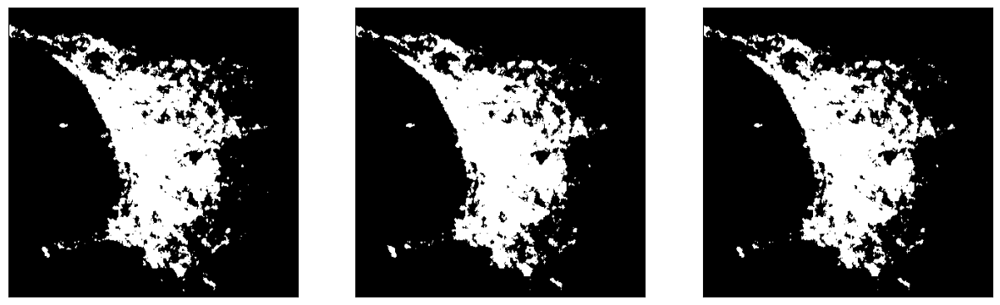

In [ ]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(15,5))
ax[0].imshow(-1.0*mix_mitomito.mask2,cmap='Greys')
ax[0].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[1].imshow(-1.0*mix_mitomito.mask1,cmap='Greys')
ax[1].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[2].imshow(-1.0*np.logical_and(mix_mitomito.mask1,mix_mitomito.mask2),cmap='Greys')
ax[2].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

save_dir = os.path.join(droot,'fig_s4/')
plt.savefig(os.path.join(save_dir,f'mitomito_otsu_masks.png'),dpi=300,transparent=True,bbox_inches='tight')

##### Thresholding Effects (Fig S5)

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.23467492 0.58406678]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62000249 -0.15956851]for AF568
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.23467492 0.58406678]
AF568 is already clustered... Peak at [-0.62000249 -0.15956851]
mitomito has a colocalization factor of [0.90644832 0.99479758]
0.9900692796359373
0.9937374228919553
0.9998500269453177
0.99985542830294
Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.26283187 0.66982663]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62394424 -0.16130445]for AF568
otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.26283187 0.66982663]
AF568 is already clustered... Peak at [-0.62394424 -0.16130445]
mitomito has a colocalization factor of [0.926199

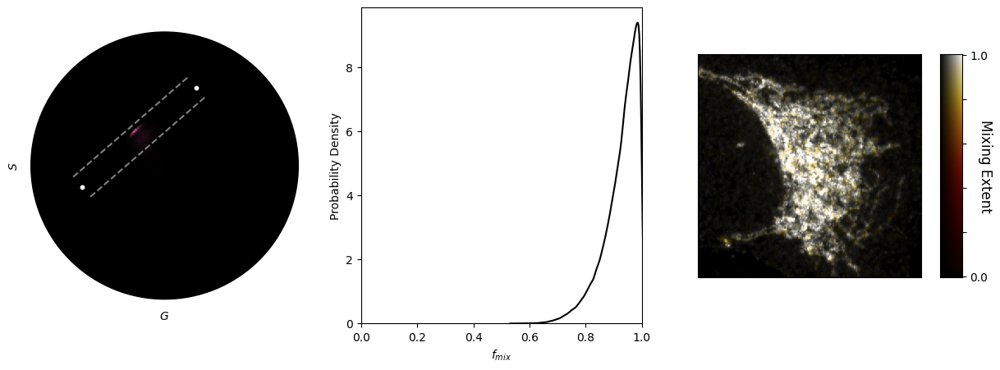

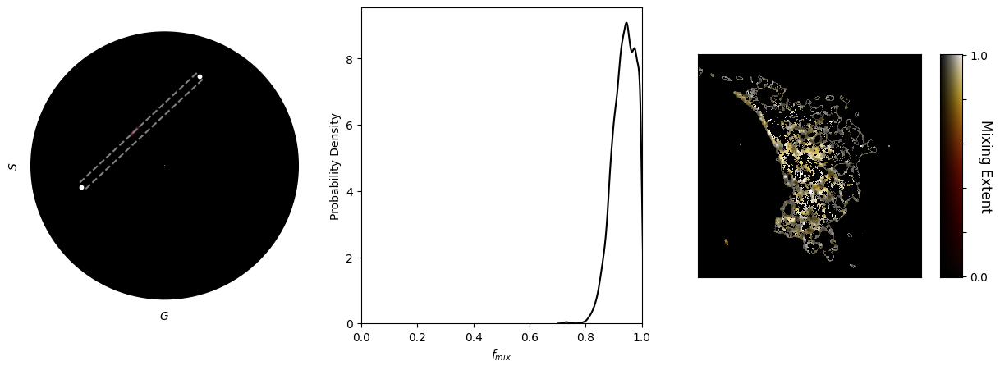

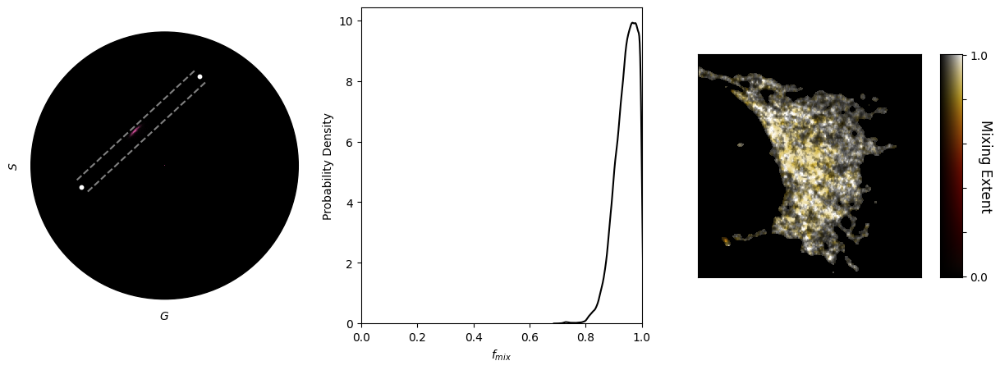

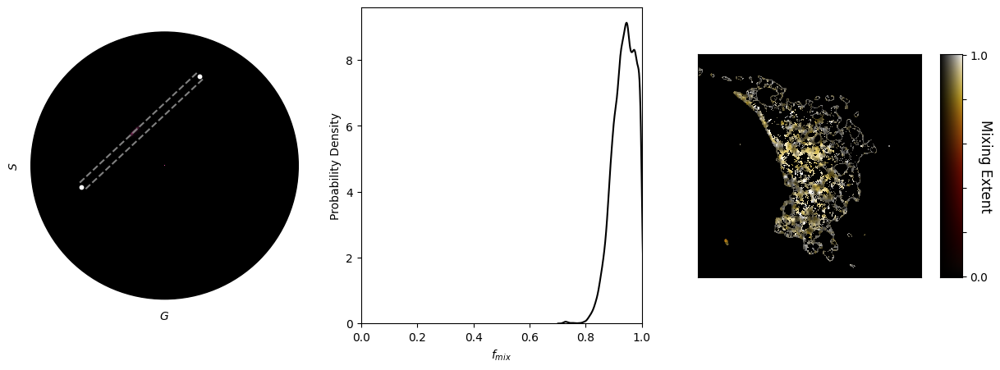

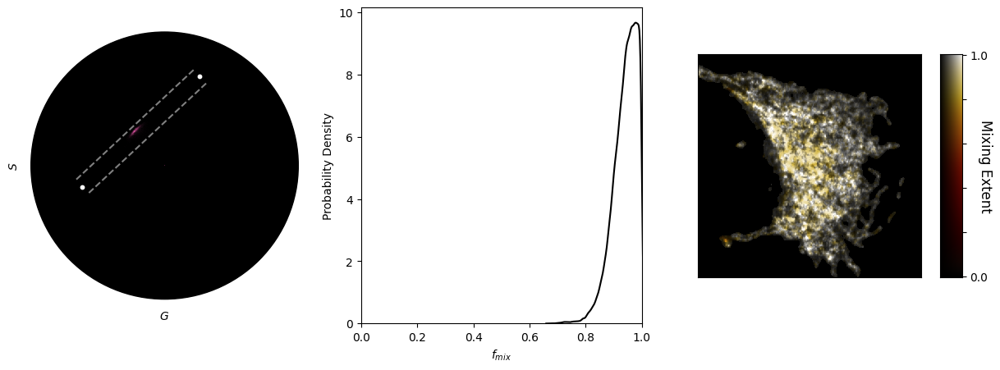

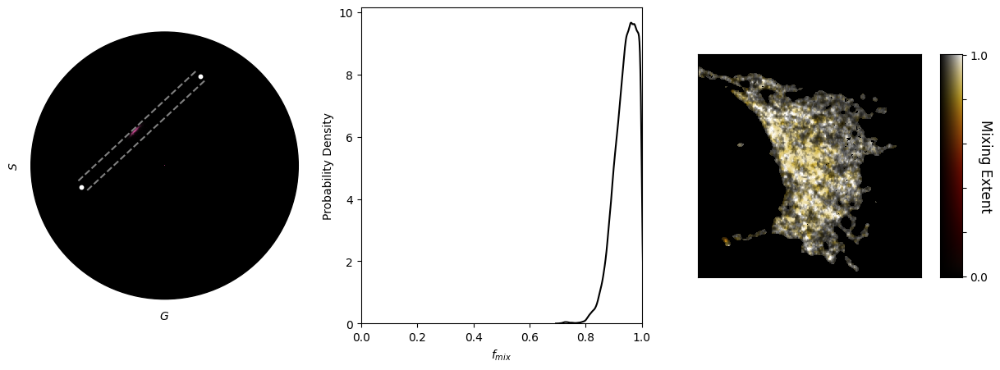

In [139]:
### Calculate the colocalization and mixing for a two-color sample with applying an intensity threshold determined through various methods

data_dir = os.path.join(droot,f'fig5/mito-mito/')
pearsons = []
manders = []
manders1 = []
manders2 = []
pmc1 = []
pmc2 = []

pc1_test = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
pc2_test = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh=None,filt=True,ver=0,crop_dims=None)

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

crop_dims = [30,430,100,500]
mix_mitomito = PairMixture(file=data_dir+'/5. AF488_AF55_3x_0.8%_0.1%_112.czi',name='mitomito',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=crop_dims)
mix_mitomito.analyze_overlap(quad=True,cmap='cet_linear_kryw_5_100_c64')
mix_mitomito.calc_pearson_mander(pcs=mix_mitomito.purecomps,thresh_override=False)
print(mix_mitomito.pearsons)
print(mix_mitomito.mandersO)
print(mix_mitomito.manders1)
print(mix_mitomito.manders2)

pearsons.append(mix_mitomito.pearsons)
manders.append(mix_mitomito.mandersO)
manders1.append(mix_mitomito.manders1)
manders2.append(mix_mitomito.manders2)
pmc1.append(mix_mitomito.coloc_vec[0])
pmc2.append(mix_mitomito.coloc_vec[1])

exps = dict()

for thresh in ['otsu','mean','iso','triangle','li']:
    pc1_test = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh=thresh,filt=True,ver=0,crop_dims=None)
    pc2_test = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh=thresh,filt=True,ver=0,crop_dims=None)

    pc1_test.determine_peak(pk_flag='test')
    pc2_test.determine_peak(pk_flag='test')
    print(thresh)
    crop_dims = [30,430,100,500]
    mix_mitomito = PairMixture(file=data_dir+'/5. AF488_AF55_3x_0.8%_0.1%_112.czi',name='mitomito',
                    pcs=[pc1_test,pc2_test],thresh=thresh,filt=True,crop_dims=crop_dims)
    mix_mitomito.analyze_overlap(quad=True,cmap='cet_linear_kryw_5_100_c64')
    mix_mitomito.calc_pearson_mander(pcs=mix_mitomito.purecomps,thresh_override=True)
    print(mix_mitomito.pearsons)
    print(mix_mitomito.mandersO)
    print(mix_mitomito.manders1)
    print(mix_mitomito.manders2)
    pearsons.append(mix_mitomito.pearsons)
    manders.append(mix_mitomito.mandersO)
    manders1.append(mix_mitomito.manders1)
    manders2.append(mix_mitomito.manders2)
    pmc1.append(mix_mitomito.coloc_vec[0])
    pmc2.append(mix_mitomito.coloc_vec[1])
    exps[thresh] = mix_mitomito
    

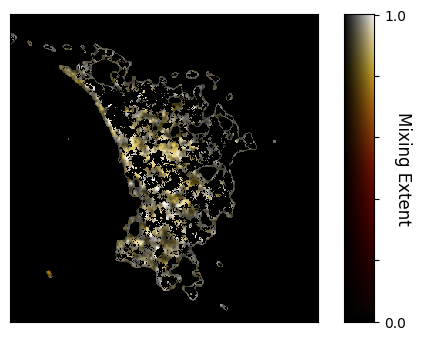

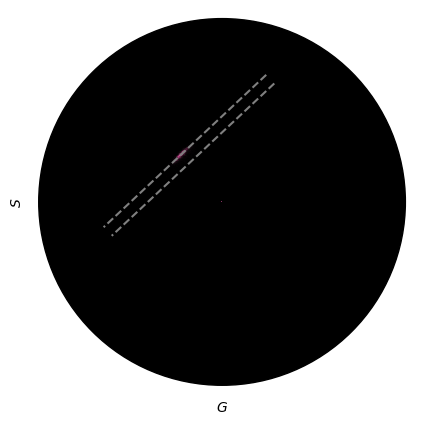

In [ ]:
save_dir = os.path.join(droot,'fig_s5')
mix_choice = exps['otsu']
fig, ax = plt.subplots(figsize=(5,5))
mix_choice.color_mixing_image(ax1=ax,quad=True,cmap='cet_linear_kryw_5_100_c64')
# fig.savefig(os.path.join(save_dir,f'mito_mito_mixing_image_otsu_new.png'),dpi=300,transparent=True,bbox_inches='tight')

fig, ax = plt.subplots(figsize=(5,5))
mix_mitomito.plot_phasor(ax1=ax)
ax.plot([mix_choice.vertices[0,0],mix_choice.vertices[3,0]],[mix_choice.vertices[0,1],mix_choice.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_choice.vertices[1,0],mix_choice.vertices[2,0]],[mix_choice.vertices[1,1],mix_choice.vertices[2,1]],c='gray',linestyle='--')
# fig.savefig(os.path.join(save_dir,f'mito_phasor_band_otsu_new_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

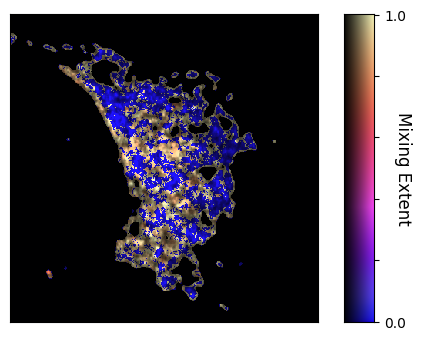

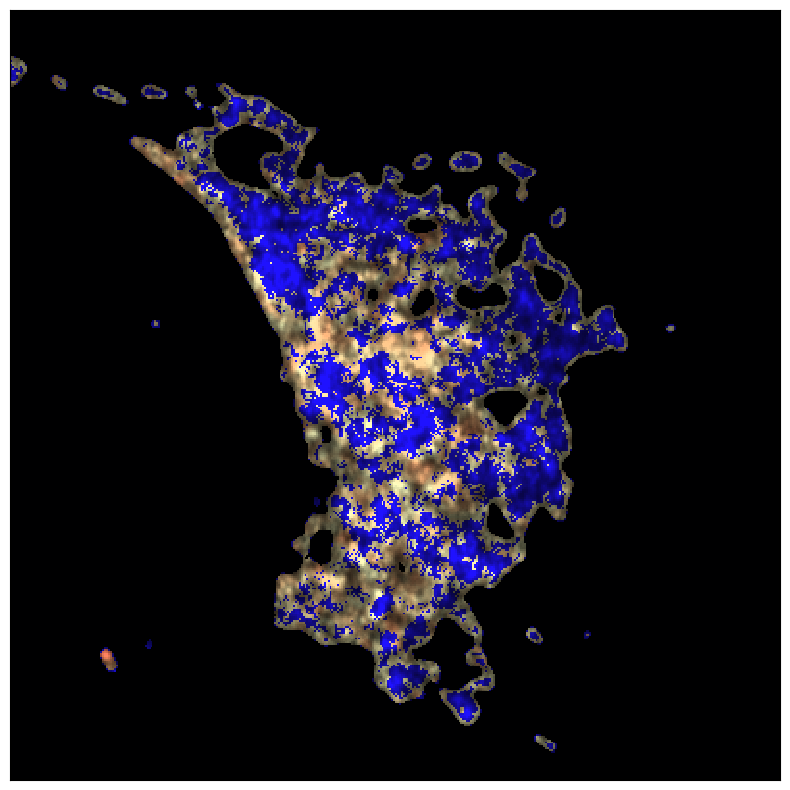

In [ ]:
save_dir = os.path.join(droot,'fig_s5')

mix_choice = exps['otsu']
fig, ax = plt.subplots(figsize=(5,5))
# mix_choice.color_mixing_image(ax1=ax,quad=True,cmap='cet_linear_kryw_5_100_c64')
mix_choice.color_mixing_image(ax1=ax)

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
# fig.savefig(os.path.join(save_dir,f'mito_mito_mixing_image_otsu_excluded_pixels.png'),dpi=300,transparent=True,bbox_inches='tight')

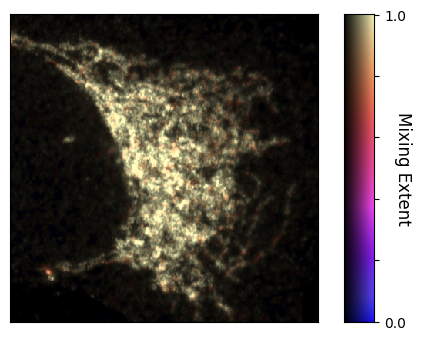

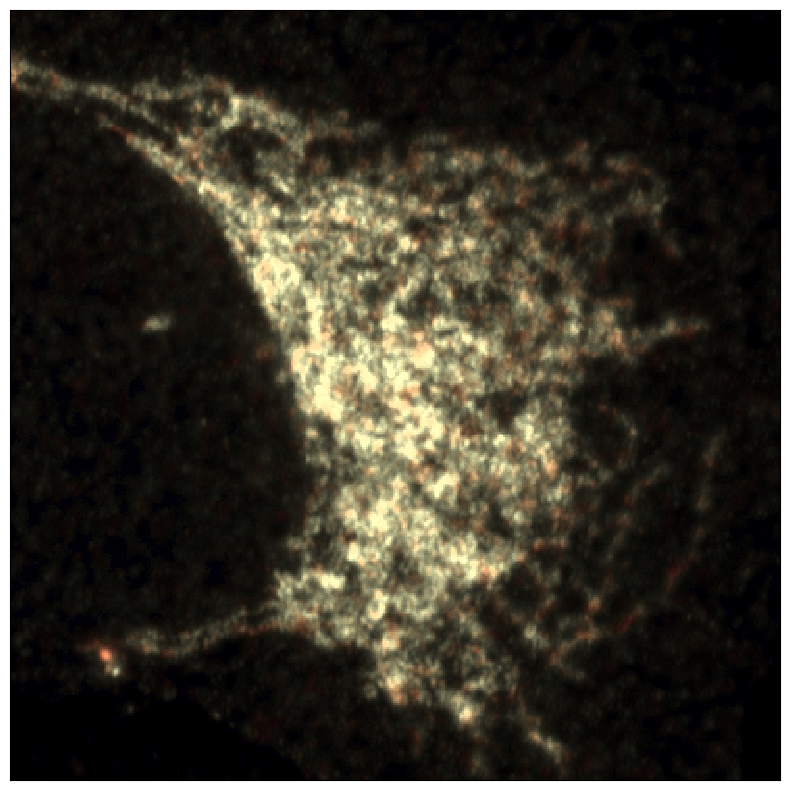

In [381]:
save_dir = os.path.join(droot,'fig5/figures/')

mix_choice = mix_mitomito
fig, ax = plt.subplots(figsize=(5,5))
# mix_choice.color_mixing_image(ax1=ax,quad=True,cmap='cet_linear_kryw_5_100_c64')
mix_choice.color_mixing_image(ax1=ax)

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_choice.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
fig.savefig(os.path.join(save_dir,f'mito_mito_mixing_image.png'),dpi=300,transparent=True,bbox_inches='tight')

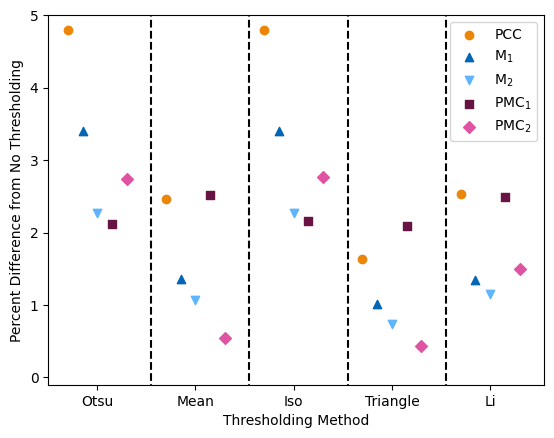

In [ ]:
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']

plt.scatter(np.arange(1,6)+0.15,100*np.abs(pearsons[1:]-pearsons[0])/pearsons[0],c=colors[0],marker='o')
plt.scatter(np.arange(1,6)+0.3,100*np.abs(manders1[1:]-manders1[0])/manders1[0],c=colors[1],marker='^')
plt.scatter(np.arange(1,6)+0.45,100*np.abs(manders2[1:]-manders2[0])/manders2[0],c=colors[2],marker='v')
plt.scatter(np.arange(1,6)+0.6,100*np.abs(pmc1[1:]-pmc1[0])/pmc1[0],c=colors[3],marker='s')
plt.scatter(np.arange(1,6)+0.75,100*np.abs(pmc2[1:]-pmc2[0])/pmc2[2],c=colors[4],marker='D')
plt.xticks(np.arange(1,6)+0.45,['Otsu','Mean','Iso','Triangle','Li'])
plt.vlines([2,3,4,5],ymin=-100*0.005,ymax=100*0.05,linestyle='dashed',color='k')
plt.ylim([-100*0.001,100*0.05])
plt.xlim([0.95,6.0])
plt.legend([r'PCC',r'M$_1$',r'M$_2$',r'PMC$_1$',r'PMC$_2$'])
plt.xlabel('Thresholding Method')
plt.ylabel('Percent Difference from No Thresholding')

save_dir = os.path.join(droot,'supp_fig3/')
plt.savefig(save_dir+'coefficients_threshold_effect.svg',dpi=300)

#### Combined

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.26318282 0.66654808]for AF488
Finished clustering data for AF568...
Determined peak at [-0.62000249 -0.15956851]for AF568
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.26318282 0.66654808]
AF568 is already clustered... Peak at [-0.62000249 -0.15956851]
mito has a colocalization factor of [0.90803333 0.99541519]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.26318282 0.66654808]
AF568 is already clustered... Peak at [-0.62000249 -0.15956851]
mito has a colocalization factor of [0.87792822 0.9897939 ]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.26318282 0.66654808]
AF568 is already clustered... Peak at [-0.62000249 -0.15956851]
mito has a colocalization factor of [0.85313976 0.991098

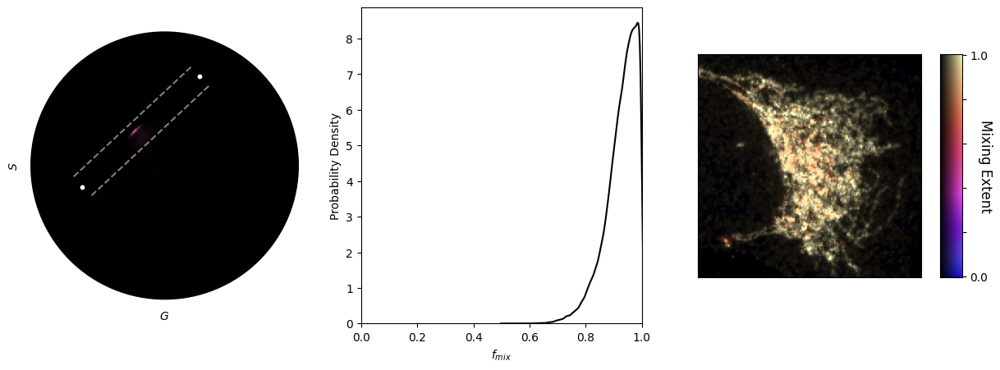

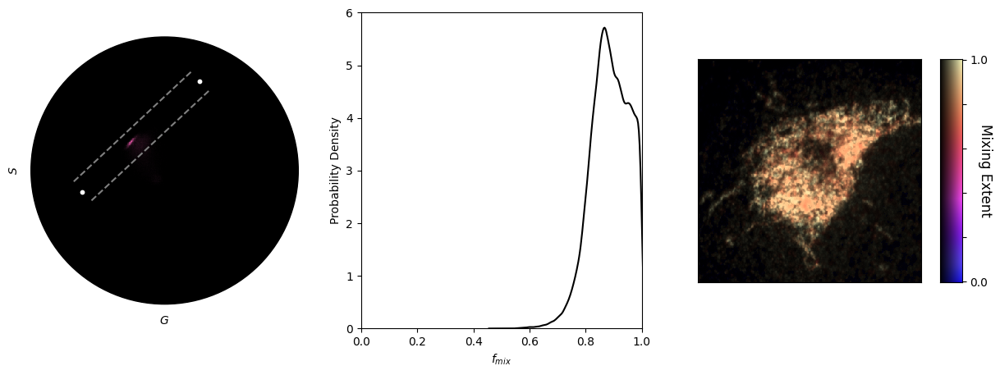

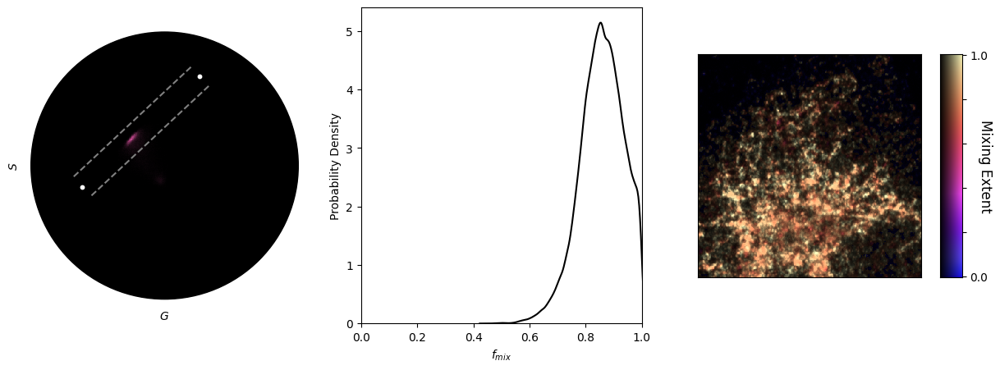

In [70]:
### Calculate the colocalization and mixing for two-color samples without thresholding
data_dir = os.path.join(droot,f'fig5/mito-mito/')

pc1_test = PC(file=data_dir+'6. AF488_a.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
pc2_test = PC(file=data_dir+'6. AF555_a.czi',name='AF568',thresh=None,filt=True,ver=0,crop_dims=None)

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

data_dir = os.path.join(droot,f'fig5/mito-mito/')
mito_pearsons = []
mito_manders = []
mito_manders1 = []
mito_manders2 = []
mito_pmc1 = []
mito_pmc2 = []

for fname, dims in zip(['5. AF488_AF55_3x_0.8%_0.1%_112.czi',
                        '6. AF488_AF555_3x_0.8%_0.1%_112a.czi',
                        '6. AF488_AF555_3x_0.8%_0.1%_112d.czi'],
                       [[30,430,100,500],[70,420,20,370],[20,370,0,350]]):
    mix_mitomito = PairMixture(file=os.path.join(data_dir,fname),name='mito',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=dims)
    mix_mitomito.analyze_overlap()
    mix_mitomito.calc_pearson_mander(pcs=mix_mitomito.purecomps,thresh_override=True)
    
    mito_pearsons.append(mix_mitomito.pearsons)
    mito_manders.append(mix_mitomito.mandersO)
    mito_manders1.append(mix_mitomito.manders1)
    mito_manders2.append(mix_mitomito.manders2)
    mito_pmc1.append(mix_mitomito.coloc_vec[0])
    mito_pmc2.append(mix_mitomito.coloc_vec[1])
    
    if fname == '5. AF488_AF55_3x_0.8%_0.1%_112.czi':
        mix_mito_choice = mix_mitomito
    
mito_mns = np.array([np.mean(mito_pearsons),np.mean(mito_manders),np.mean(mito_manders1),np.mean(mito_manders2),np.mean(mito_pmc1),np.mean(mito_pmc2)])
mito_err = np.array([np.std(mito_pearsons),np.std(mito_manders),np.std(mito_manders1),np.std(mito_manders2),np.std(mito_pmc1),np.std(mito_pmc2)])/np.sqrt(3)

print(mito_mns)
print(mito_err)

## Myosin Data

##### PCs

In [61]:
### Determine the PC coordinates for single-color samples 
data_dir = os.path.join(droot,f'fig5/myo-pmyo')

pc1_test = PC(file=data_dir+'/Ptk_MHC-AF488_01.czi',name='AF488')
pc2_test = PC(file=data_dir+'/Ptk_RLC-AF568_02.czi',name='AF568')

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')


Finished clustering data for AF488...
Determined peak at [0.30612245 0.67346939]for AF488
Finished clustering data for AF568...
Determined peak at [-0.64341616 -0.04920326]for AF568


##### Clustering -- Fig S1

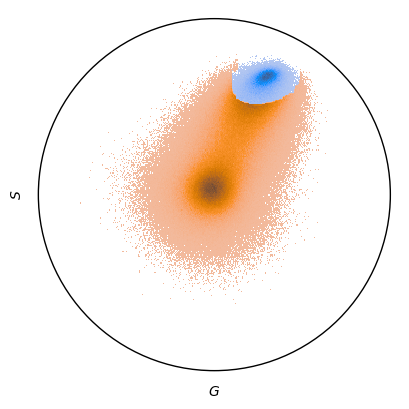

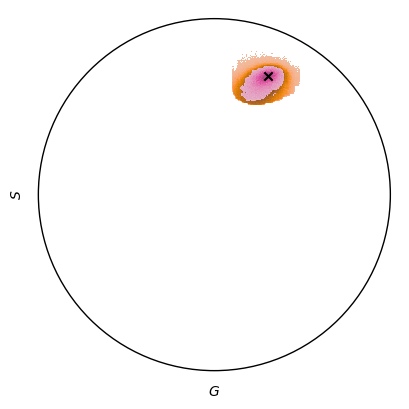

In [62]:
### Visualize the two-step clustering process which allows precise determination of the PC coordinates

save_dir = os.path.join( droot,f'fig_s1/')
fig, ax1 = plt.subplots()
temp_x = pc1_test.phasor_coords[:,:,0].flatten()
temp_y = pc1_test.phasor_coords[:,:,1].flatten()
cs = ['#0365B5','#EC8609']
for j in np.unique(pc1_test.clusters_GMM):
    sns.histplot(ax=ax1,x=temp_x[pc1_test.clusters_GMM==j],y=temp_y[pc1_test.clusters_GMM==j],color=cs[j])
    
c1=plt.Circle((0,0),radius=1,color='k',fill=False,zorder=-100)
ax1.add_patch(c1)
ax1.set_xlim([-1.05,1.05]); ax1.set_ylim([-1.05,1.05]); 
ax1.set_xticks([]); ax1.set_yticks([]);
ax1.set_aspect('equal'); 
# ax1.set_title(self.name);
ax1.set_xlabel(r'$G$'); ax1.set_ylabel(r'$S$');
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)

fig.savefig(save_dir+'GMM_clustering.png',dpi=300)

fig, ax = plt.subplots()
temp_x = pc1_test.data_c[:,0]
temp_y = pc1_test.data_c[:,1]
cs = ['#DF53A2','#EC8609']
for j in np.unique(pc1_test.clusters):
    sns.histplot(ax=ax,x=temp_x[pc1_test.clusters==j],y=temp_y[pc1_test.clusters==j],color=cs[j])

ax.scatter(pc1_test.pks_l[0],pc1_test.pks_l[1],marker='x',c='k')
c1=plt.Circle((0,0),radius=1,color='k',fill=False,zorder=-100)
ax.add_patch(c1)
ax.set_xlim([-1.05,1.05]); ax.set_ylim([-1.05,1.05]); 
ax.set_xticks([]); ax.set_yticks([]);
ax.set_aspect('equal'); 
# ax1.set_title(self.name);
ax.set_xlabel(r'$G$'); ax.set_ylabel(r'$S$');
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

# fig.savefig(save_dir+'HDBSCAN_clustering.png',dpi=300)

#### Display

Finished clustering data for AF488...
Determined peak at [0.29210521 0.67007556]for AF488
Finished clustering data for AF568...
Determined peak at [-0.64341616 -0.04144772]for AF568
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.29210521 0.67007556]
AF568 is already clustered... Peak at [-0.64341616 -0.04144772]
myosin has a colocalization factor of [0.73611777 0.74920044]
Threshold method not given by requested. Using Otsu
0.4648556611584807
0.9159874439965751
0.9257909434987165
0.7435277060857984


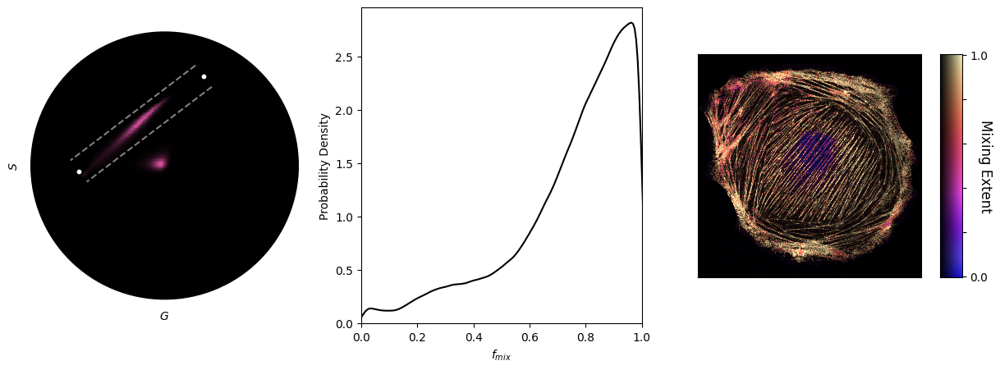

In [258]:
### Calculate the colocalization and mixing of a two-color sample without applying an intensity threshold
data_dir = os.path.join(droot,f'fig5/myo-pmyo')

pc1_test = PC(file=data_dir+'/Ptk_MHC-AF488_01.czi',name='AF488')
pc2_test = PC(file=data_dir+'/Ptk_RLC-AF568_02.czi',name='AF568')

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

mix_rlcmhc = PairMixture(file=data_dir+'/Ptk_MHC-AF488_RLC-AF568_04.czi',name='myosin',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=[90,1440,20,1370],ver=0)
mix_rlcmhc.analyze_overlap();
mix_rlcmhc.calc_pearson_mander(pcs=mix_rlcmhc.purecomps,thresh_override=True)
print(mix_rlcmhc.pearsons)
print(mix_rlcmhc.mandersO)
print(mix_rlcmhc.manders1)
print(mix_rlcmhc.manders2)

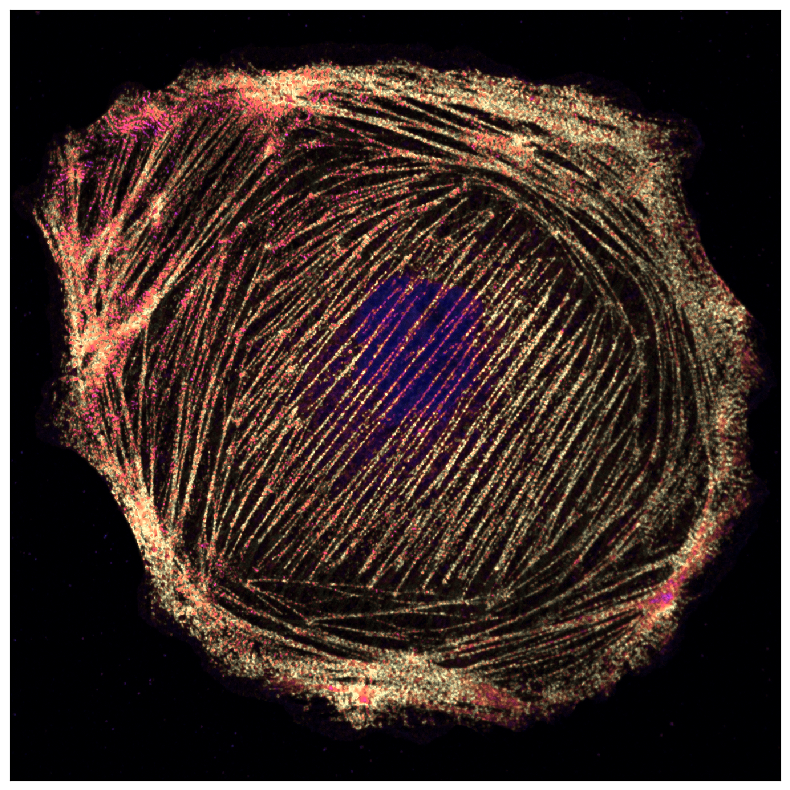

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_rlcmhc.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'rlc_mhc_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

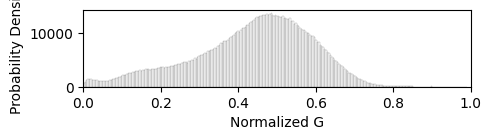

In [ ]:
fig, ax1 = plt.subplots(figsize=(5,1))
mix_choice = mix_rlcmhc
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w')
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'rlc_mhc_mixture_band_hist_new.svg'),format='svg',dpi=300)

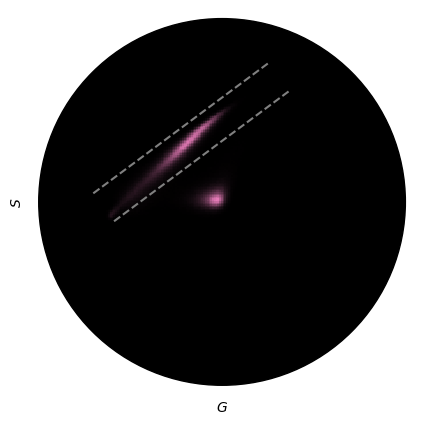

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
mix_rlcmhc.plot_phasor(ax1=ax)
ax.plot([mix_rlcmhc.vertices[0,0],mix_rlcmhc.vertices[3,0]],[mix_rlcmhc.vertices[0,1],mix_rlcmhc.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_rlcmhc.vertices[1,0],mix_rlcmhc.vertices[2,0]],[mix_rlcmhc.vertices[1,1],mix_rlcmhc.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'rlc_mhc_phasor_band_new_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

In [ ]:
# 20 um scalebar
20/(114.79/37.759)

6.578796062374771

##### Otsu Masks (Fig S4)

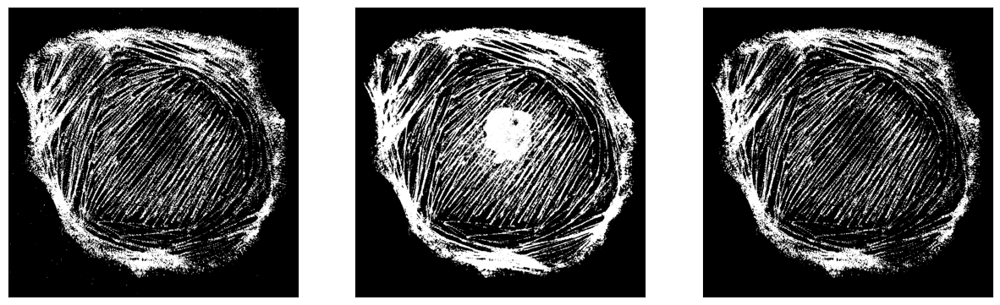

In [104]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(15,5))
ax[0].imshow(-1.0*mix_rlcmhc.mask2,cmap='Greys')
ax[0].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[1].imshow(-1.0*mix_rlcmhc.mask1,cmap='Greys')
ax[1].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[2].imshow(-1.0*np.logical_and(mix_rlcmhc.mask1,mix_rlcmhc.mask2),cmap='Greys')
ax[2].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

save_dir = os.path.join(droot,'revisions/fig_s5/')
plt.savefig(os.path.join(save_dir,f'rlcmhc_otsu_masks.png'),dpi=300,transparent=True,bbox_inches='tight')

##### Defining the Mixing Band -- Fig S1

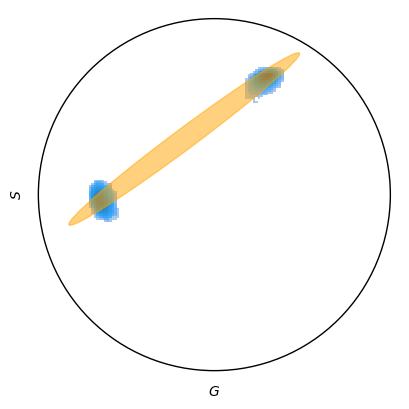

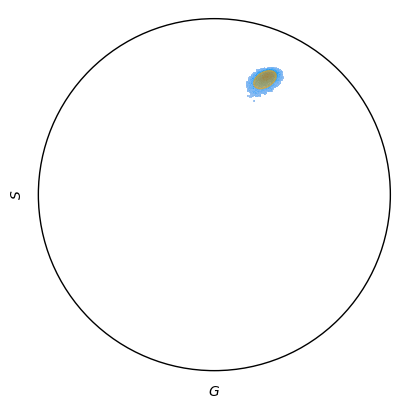

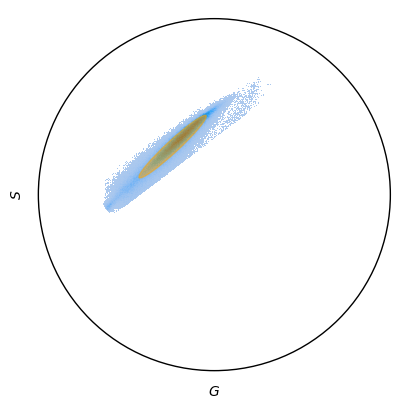

In [ ]:
### Visualize the process for calculating the scaling for PMC_2 using the size of different clusters 

from matplotlib.patches import Ellipse

def make_ellipses(gmm, mn, ax):
    if gmm.covariance_type == "full":
        covariances = gmm.covariances_[0][:2, :2]
    elif gmm.covariance_type == "tied":
        covariances = gmm.covariances_[:2, :2]
    elif gmm.covariance_type == "diag":
        covariances = np.diag(gmm.covariances_[0][:2])
    elif gmm.covariance_type == "spherical":
        covariances = np.eye(gmm.means_.shape[1]) * gmm.covariances_[0]
    v, w = np.linalg.eigh(covariances)
    u = w[0] / np.linalg.norm(w[0])
    angle = np.arctan2(u[1], u[0])
    angle = 180 * angle / np.pi  # convert to degrees
    v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
    ell = Ellipse(
        mn, v[0], v[1], angle=180 + angle, color='orange'
    )
    ell.set_clip_box(ax.bbox)
    ell.set_alpha(0.5)
    ax.add_artist(ell)
    # ax.set_aspect("equal", "datalim")
    
    return v

save_dir = os.path.join( droot,'supp_fig1/')
        
X = np.vstack([cluster for cluster in mix_rlcmhc.pc_clusters[0:2]])
y = np.zeros(np.shape(X)[0])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
        
GMM = GaussianMixture(n_components=1)

gm = GMM.fit(X)
classifier = RandomForestClassifier(random_state=42,n_jobs = int(0.875 * cpu_count()))
inductive_learner = InductiveClusterer(GMM, classifier).fit(X_test)

clusters_GMM = inductive_learner.predict(X)

fig, ax = plt.subplots()
test = np.vstack([pc.pks_l for pc in mix_rlcmhc.purecomps])

v1 = make_ellipses(gm,np.mean(test,axis=0),ax)

sns.histplot(ax=ax,x=X[clusters_GMM==0,0],y=X[clusters_GMM==0,1],zorder=-100)
c1=plt.Circle((0,0),radius=1,color='k',fill=False,zorder=-100)
ax.add_patch(c1)
ax.set_xlim([-1.05,1.05]); ax.set_ylim([-1.05,1.05]); 
ax.set_xticks([]); ax.set_yticks([]);
ax.set_aspect('equal'); 
ax.set_xlabel(r'$G$'); ax.set_ylabel(r'$S$');
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

# fig.savefig(save_dir+'joined_pc_cluster.png',dpi=300)

X = np.vstack([cluster for cluster in mix_rlcmhc.pc_clusters[0:1]])
y = np.zeros(np.shape(X)[0])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
        
GMM = GaussianMixture(n_components=1)


gm = GMM.fit(X)

classifier = RandomForestClassifier(random_state=42,n_jobs = int(0.875 * cpu_count()))
inductive_learner = InductiveClusterer(GMM, classifier).fit(X_test)

clusters_GMM = inductive_learner.predict(X)

fig, ax = plt.subplots()
v1 = make_ellipses(gm,np.array([np.mean(X[clusters_GMM==0,0]), np.mean(X[clusters_GMM==0,1])]),ax)

sns.histplot(ax=ax,x=X[clusters_GMM==0,0],y=X[clusters_GMM==0,1],zorder=-100)
c1=plt.Circle((0,0),radius=1,color='k',fill=False,zorder=-100)
ax.add_patch(c1)
ax.set_xlim([-1.05,1.05]); ax.set_ylim([-1.05,1.05]); 
ax.set_xticks([]); ax.set_yticks([]);
ax.set_aspect('equal'); 
# ax1.set_title(self.name);
ax.set_xlabel(r'$G$'); ax.set_ylabel(r'$S$');
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

# fig.savefig(save_dir+'single_pc_cluster.png',dpi=300)

X = np.dstack((mix_rlcmhc.X_thresh_x[mix_rlcmhc.idx],mix_rlcmhc.X_thresh_y[mix_rlcmhc.idx]))[0]
y = np.zeros(np.shape(X)[0])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

temp = np.mean(mix_rlcmhc.pc_pks[0:2],axis=1)
GMM = GaussianMixture(n_components=1,means_init=np.array([[temp[1],temp[0]]]),covariance_type='full')

gm = GMM.fit(X)

classifier = RandomForestClassifier(random_state=42,n_jobs = int(0.875 * cpu_count()))
inductive_learner = InductiveClusterer(GMM, classifier).fit(X_test)

clusters_GMM = inductive_learner.predict(X)

fig, ax = plt.subplots()
v1 = make_ellipses(gm,np.array([np.mean(X[clusters_GMM==0,0]), np.mean(X[clusters_GMM==0,1])]),ax)

sns.histplot(ax=ax,x=X[clusters_GMM==0,0],y=X[clusters_GMM==0,1],zorder=-100)
c1=plt.Circle((0,0),radius=1,color='k',fill=False,zorder=-100)
ax.add_patch(c1)
ax.set_xlim([-1.05,1.05]); ax.set_ylim([-1.05,1.05]); 
ax.set_xticks([]); ax.set_yticks([]);
ax.set_aspect('equal'); 
ax.set_xlabel(r'$G$'); ax.set_ylabel(r'$S$');
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

# fig.savefig(save_dir+'mixing_cluster.png',dpi=300)

#### Combined

Finished clustering data for AF488...
Determined peak at [0.30067028 0.67346939]for AF488
Finished clustering data for AF568...
Determined peak at [-0.64341616 -0.04144772]for AF568
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.30067028 0.67346939]
AF568 is already clustered... Peak at [-0.64341616 -0.04144772]
myosin has a colocalization factor of [0.73219243 0.72809415]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.30067028 0.67346939]
AF568 is already clustered... Peak at [-0.64341616 -0.04144772]
myosin has a colocalization factor of [0.75068803 0.75003039]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.30067028 0.67346939]
AF568 is already clustered... Peak at [-0.64341616 -0.04144772]
myosin has a colocalization factor of [0.73602315 0.74917059]
Threshold method not given by requested. Using Otsu
[0

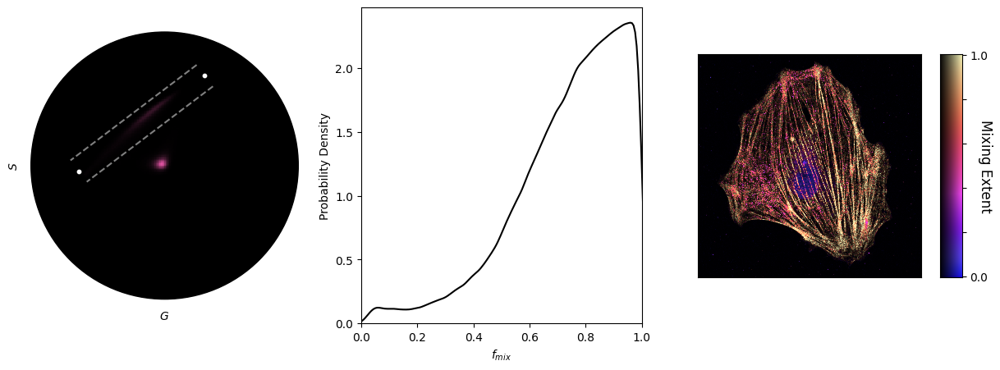

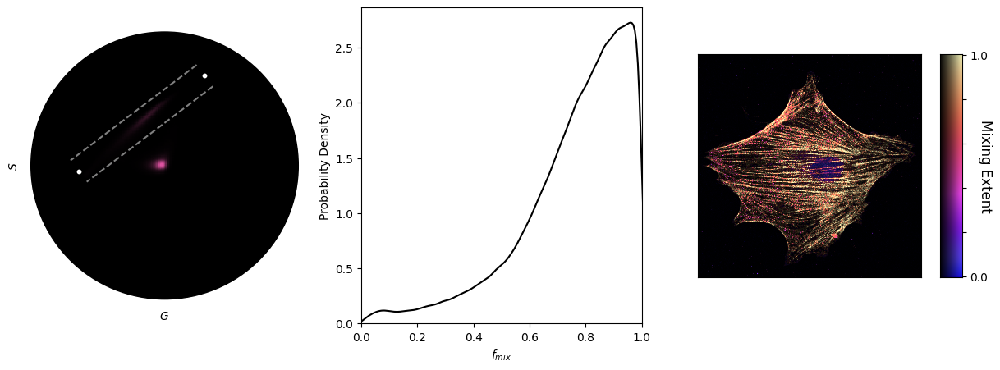

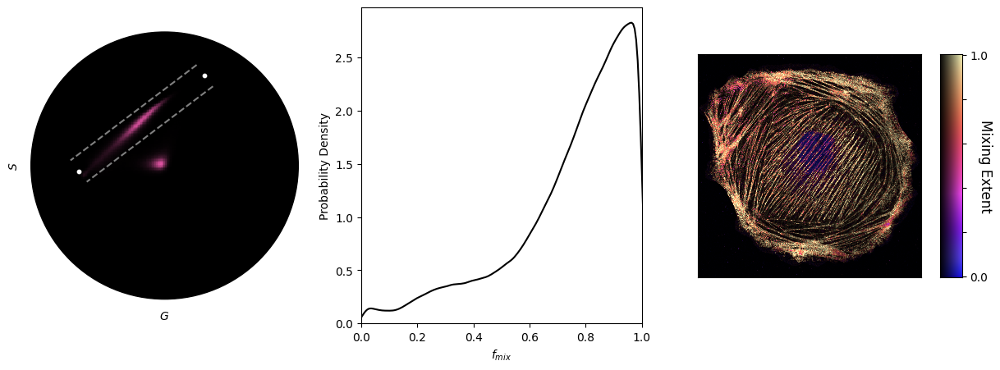

In [63]:
### Calculate the colocalization and mixing of two-color samples without applying an intensity threshold
data_dir = os.path.join(droot,f'fig5/myo-pmyo')

pc1_test = PC(file=data_dir+'/Ptk_MHC-AF488_01.czi',name='AF488')
pc2_test = PC(file=data_dir+'/Ptk_RLC-AF568_02.czi',name='AF568')

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

myo_pearsons = []
myo_manders = []
myo_manders1 = []
myo_manders2 = []
myo_pmc1 = []
myo_pmc2 = []

ns = [1,2,4]
myo_crop_dims = [[350,1500,170,1320],[110,1440,50,1380],[90,1440,20,1370]]
for ni, jj in zip(ns,range(len(ns))):
    fname = data_dir+'/Ptk_MHC-AF488_RLC-AF568_0'+str(ni)+'.czi'
    mix_rlcmhc = PairMixture(file=fname,name='myosin',
                pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=myo_crop_dims[jj])
    mix_rlcmhc.analyze_overlap()
    mix_rlcmhc.calc_pearson_mander(pcs=mix_rlcmhc.purecomps,thresh_override=True)
    
    myo_pearsons.append(mix_rlcmhc.pearsons)
    myo_manders.append(mix_rlcmhc.mandersO)
    myo_manders1.append(mix_rlcmhc.manders1)
    myo_manders2.append(mix_rlcmhc.manders2)
    myo_pmc1.append(mix_rlcmhc.coloc_vec[0])
    myo_pmc2.append(mix_rlcmhc.coloc_vec[1])
    
    if ni == 4:
        mix_myo_choice = mix_rlcmhc
    
myo_mns = np.array([np.mean(myo_pearsons),np.mean(myo_manders),np.mean(myo_manders1),np.mean(myo_manders2),np.mean(myo_pmc1),np.mean(myo_pmc2)])
myo_err = np.array([np.std(myo_pearsons),np.std(myo_manders),np.std(myo_manders1),np.std(myo_manders2),np.std(myo_pmc1),np.std(myo_pmc2)])/np.sqrt(3)

print(myo_mns)
print(myo_err)

## Mito-Nuc

### PCs

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.28274896 0.66526216]for AF488
Finished clustering data for AF568...
Determined peak at [-0.68336909 -0.16148847]for AF568


<Axes: xlabel='$G$', ylabel='$S$'>

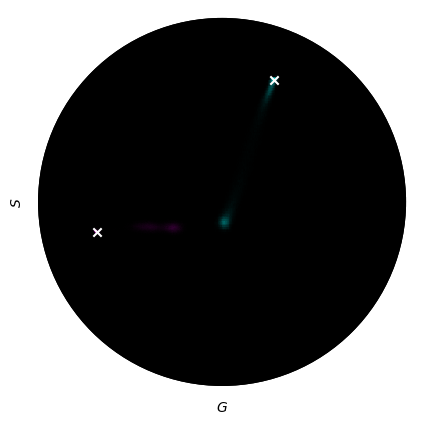

In [64]:
### Determine the PC coordinates in single-color samples 
data_dir = os.path.join(droot,'fig5/mito-nuc')


crop_dims = [70,270,240,440]
pc1_test = PC(file=data_dir+'/5. AF488_3X_0.5%_1.7%_56_b.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
crop_dims = [200,400,60,260]
pc2_test = PC(file=data_dir+'/5. JF549_3X_0.5%_1.7%_56_b.czi',name='AF568',thresh=None,filt=True,ver=0,crop_dims=None)


pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

fig, ax = plt.subplots(figsize=(5,5))
pc1_test.plot_hist_with_peaks(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']))
pc2_test.plot_hist_with_peaks(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#fd00fdff']))

### Display

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.2801757  0.66526216]for AF488
Finished clustering data for AF488...
Determined peak at [-0.68336909 -0.16148847]for AF488
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.2801757  0.66526216]
AF488 is already clustered... Peak at [-0.68336909 -0.16148847]
myosin has a colocalization factor of [0.32091722 0.13927073]
Threshold method not given by requested. Using Otsu
-0.27119585555012715
0.31500794900384305
0.05125038429547901
0.03549298317539026


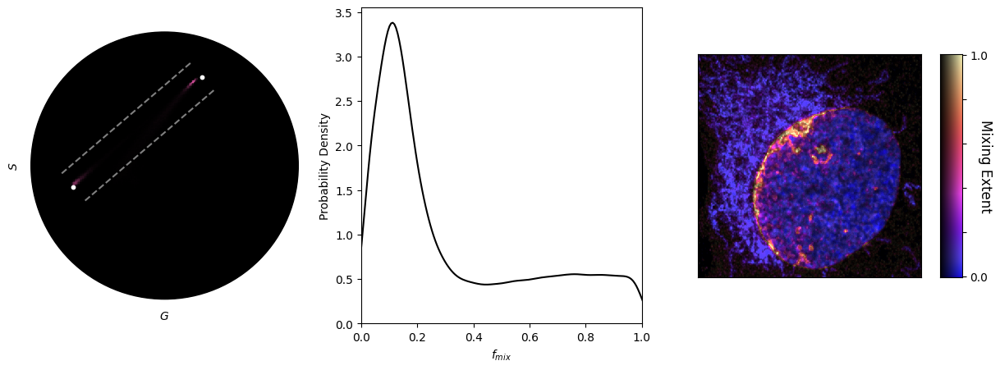

In [65]:
### Calculate the colocalization and mixing in two-color samples without applying an intensity threshold
data_dir = os.path.join(droot,'fig5/mito-nuc')
crop_dims = [30,380,80,430]
pc1_test = PC(file=data_dir+'/5. AF488_3X_0.5%_1.7%_56_b.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
crop_dims = [130,480,0,350]
pc2_test = PC(file=data_dir+'/5. JF549_3X_0.5%_1.7%_56_b.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)

pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

crop_dims = [90,490,80,480]
mix_nuc = PairMixture(file=data_dir+'/5. AF488_JF549_3X_0.5%_1.7%_56.czi',name='myosin',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=crop_dims)
mix_nuc.analyze_overlap()
mix_nuc.calc_pearson_mander(pcs=mix_nuc.purecomps,thresh_override=True)
print(mix_nuc.pearsons)
print(mix_nuc.mandersO)
print(mix_nuc.manders1)
print(mix_nuc.manders2)

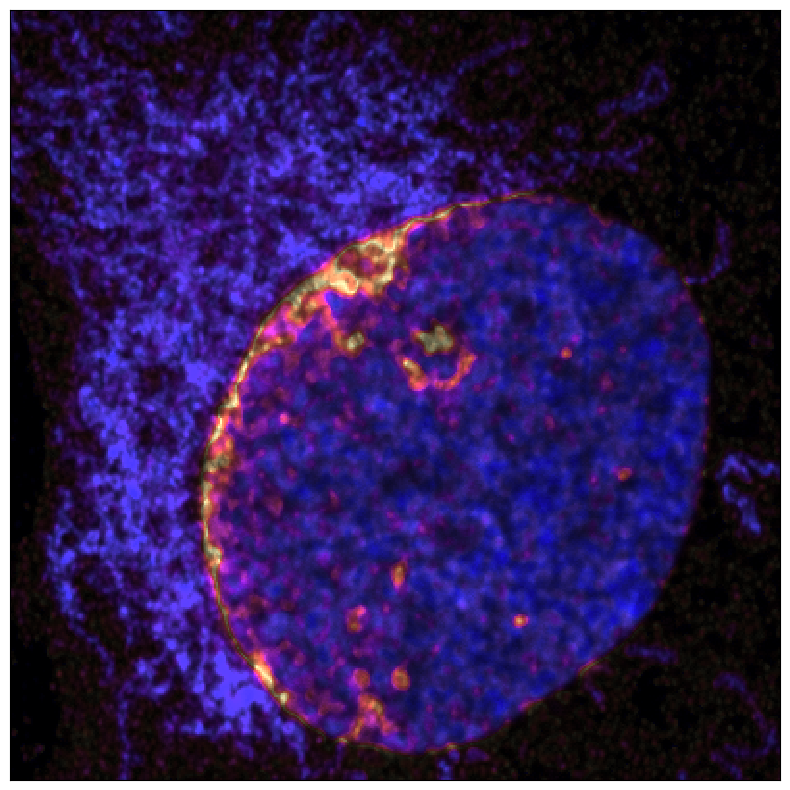

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(mix_nuc.im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'nuc_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

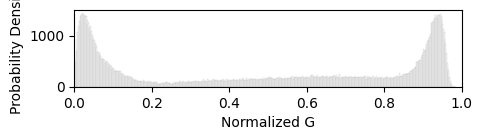

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax1 = plt.subplots(figsize=(5,1))
mix_choice = mix_nuc
temp = np.hstack((mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,1]>=0.5),0],1-mix_choice.fs_tot[np.logical_and(mix_choice.ids_b,mix_choice.fs_tot[:,0]>0.5),1]))
sns.histplot(ax=ax1,data=temp,color='w',bins=500)
# sns.kdeplot(ax=ax1,data=temp,color='k')
ax1.set_xlim([0.0,1.0])
ax1.set_xlabel(r'Normalized G')
ax1.set_ylabel(r'Probability Density')
# plt.savefig(os.path.join(save_dir,f'nuc_mixture_band_hist_new.svg'),format='svg',dpi=300)

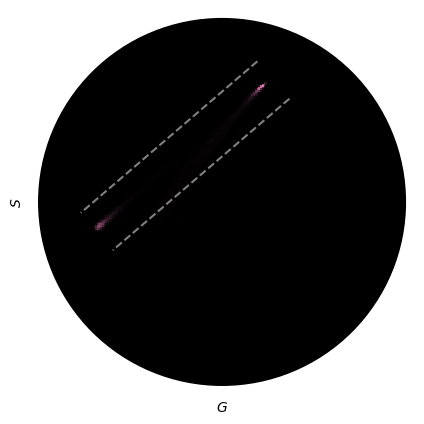

In [ ]:
save_dir = os.path.join(droot,'fig5/figures/')

fig, ax = plt.subplots(figsize=(5,5))
mix_nuc.plot_phasor(ax1=ax)
ax.plot([mix_nuc.vertices[0,0],mix_nuc.vertices[3,0]],[mix_nuc.vertices[0,1],mix_nuc.vertices[3,1]],c='gray',linestyle='--')
ax.plot([mix_nuc.vertices[1,0],mix_nuc.vertices[2,0]],[mix_nuc.vertices[1,1],mix_nuc.vertices[2,1]],c='gray',linestyle='--')
# plt.savefig(os.path.join(save_dir,f'nuc_phasor_band_new_color_corrected.png'),dpi=300,transparent=True,bbox_inches='tight')

In [ ]:
## 10um scalebar
10/(34.01/37.759)/2

5.55116142311085

#### Comparing 2D vs 1D LUTs and different colormaps (Fig S3)

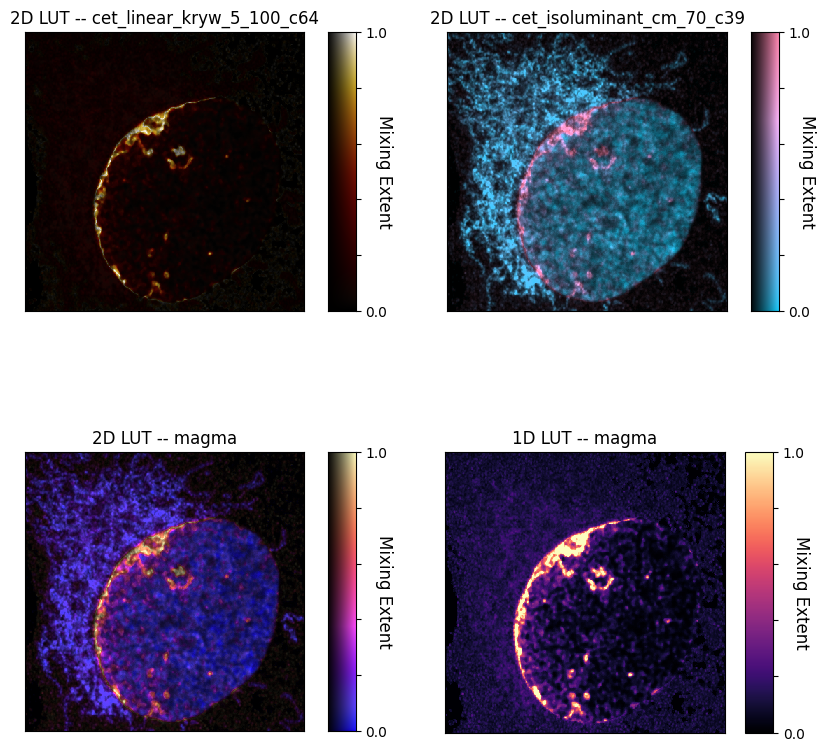

In [66]:
obj1 = 'cet_linear_kryw_5_100_c64'
obj2 = 'cet_isoluminant_cm_70_c39'

fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(10,10))
mix_nuc.color_mixing_image(ax1=ax[0,0],cmap=obj1,quad=True)
ax[0,0].set_title('2D LUT -- ' + obj1)
mix_nuc.color_mixing_image(ax1=ax[0,1],cmap=obj2)
ax[0,1].set_title('2D LUT -- ' + obj2)
mix_nuc.color_mixing_image(ax1=ax[1,0])
ax[1,0].set_title('2D LUT -- magma')
mix_nuc.color_mixing_image(ax1=ax[1,1],imtype='1D')
ax[1,1].set_title('1D LUT -- magma')
ax[1,1].set_position([0.545, 0.12, 0.3285, 0.3285])

save_dir = os.path.join(droot,'fig_s3')
# plt.savefig(os.path.join(save_dir,f'nuc_cmi_colormap_examples.png'),dpi=300,transparent=True,bbox_inches='tight')

#### Otsu Masks (Fig S4)

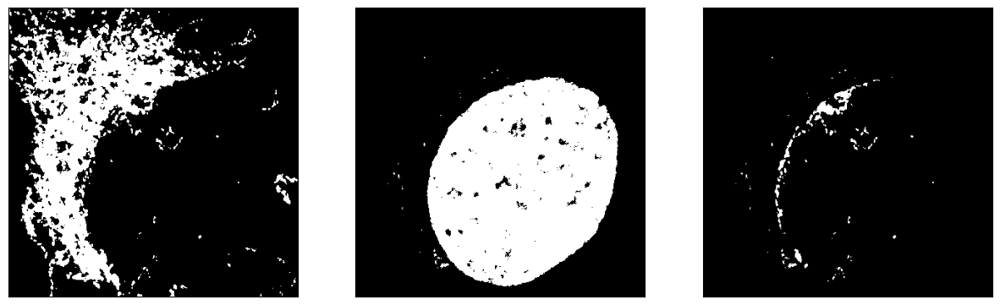

In [105]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(15,5))
ax[0].imshow(-1.0*mix_nuc.mask2,cmap='Greys')
ax[0].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[1].imshow(-1.0*mix_nuc.mask1,cmap='Greys')
ax[1].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)
ax[2].imshow(-1.0*np.logical_and(mix_nuc.mask1,mix_nuc.mask2),cmap='Greys')
ax[2].tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

save_dir = os.path.join(droot,'revisions/fig_s5/')
plt.savefig(os.path.join(save_dir,f'nuc_otsu_masks.png'),dpi=300,transparent=True,bbox_inches='tight')

### Combined

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF488...
Determined peak at [0.2801757  0.66526216]for AF488
Finished clustering data for AF488...
Determined peak at [-0.68336909 -0.16148847]for AF488
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.2801757  0.66526216]
AF488 is already clustered... Peak at [-0.68336909 -0.16148847]
myosin has a colocalization factor of [0.32091722 0.13927073]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.2801757  0.66526216]
AF488 is already clustered... Peak at [-0.68336909 -0.16148847]
myosin has a colocalization factor of [0.4617752  0.29869894]
Threshold method not given by requested. Using Otsu
Filtering Phasor Coordinates...
AF488 is already clustered... Peak at [0.2801757  0.66526216]
AF488 is already clustered... Peak at [-0.68336909 -0.16148847]
myosin has a colocalization factor of [0.35328787 0.

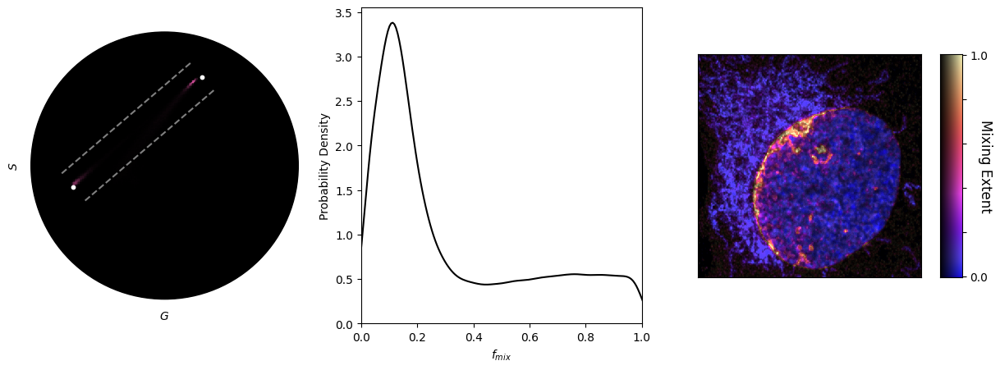

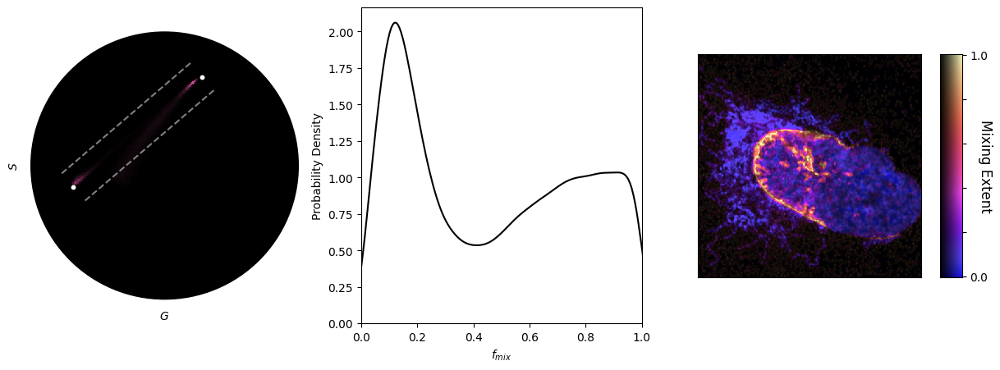

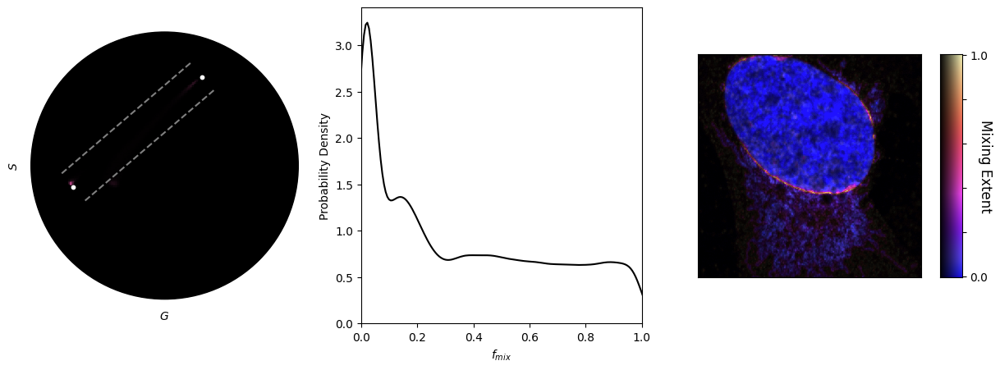

In [ ]:
### Calculate the colocalization and mixing two-color samples without applying an intensity threshold
data_dir = os.path.join(droot,'fig5/mito-nuc/')

crop_dims = [30,380,80,430]
pc1_test = PC(file=data_dir+'5. AF488_3X_0.5%_1.7%_56_b.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)
crop_dims = [130,480,0,350]
pc2_test = PC(file=data_dir+'5. JF549_3X_0.5%_1.7%_56_b.czi',name='AF488',thresh=None,filt=True,ver=0,crop_dims=None)


pc1_test.determine_peak(pk_flag='test')
pc2_test.determine_peak(pk_flag='test')

nuc_pearsons = []
nuc_manders = []
nuc_manders1 = []
nuc_manders2 = []
nuc_pmc1 = []
nuc_pmc2 = []

for fname, dims in zip(['5. AF488_JF549_3X_0.5%_1.7%_56.czi','5. AF488_JF549_3X_0.5%_1.7%_56_b.czi','5. AF488_JF549_3X_0.5%_1.7%_56_c.czi'],
                       [[90,490,80,480],[40,440,70,470],[30,430,60,460]]):
    mix_mitonuc = PairMixture(file=os.path.join(data_dir,fname),name='myosin',
                  pcs=[pc1_test,pc2_test],thresh=None,filt=True,crop_dims=dims)
    mix_mitonuc.analyze_overlap()
    mix_mitonuc.calc_pearson_mander(pcs=mix_mitonuc.purecomps,thresh_override=True)
    
    nuc_pearsons.append(mix_mitonuc.pearsons)
    nuc_manders.append(mix_mitonuc.mandersO)
    nuc_manders1.append(mix_mitonuc.manders1)
    nuc_manders2.append(mix_mitonuc.manders2)
    nuc_pmc1.append(mix_mitonuc.coloc_vec[0])
    nuc_pmc2.append(mix_mitonuc.coloc_vec[1])
    
    if fname == '5. AF488_JF549_3X_0.5%_1.7%_56.czi':
        mix_mitonuc_choice = mix_mitonuc
    
nuc_mns = np.array([np.mean(nuc_pearsons),np.mean(nuc_manders),np.mean(nuc_manders1),np.mean(nuc_manders2),np.mean(nuc_pmc1),np.mean(nuc_pmc2)])
nuc_err = np.array([np.std(nuc_pearsons),np.std(nuc_manders),np.std(nuc_manders1),np.std(nuc_manders2),np.std(nuc_pmc1),np.std(nuc_pmc2)])/np.sqrt(3)

print(nuc_mns)
print(nuc_err)

## Together

#### Fig S2

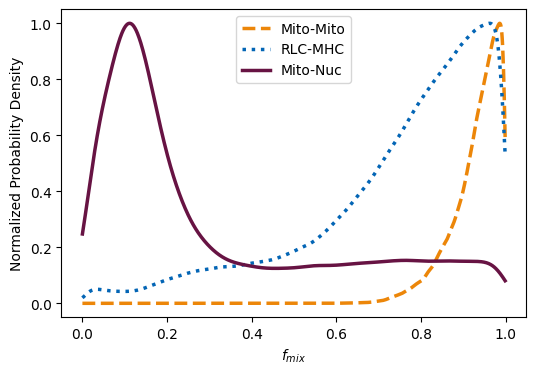

In [ ]:
### Plot the Mixing Distributions for the three examples in Figure 5
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(6,4))
pts = np.arange(0.0,1.0,0.001)
kde_mito = gaussian_kde(mix_mito_choice.fs_norm[mix_mito_choice.ids_b]).pdf(pts)
kde_rlchlc = gaussian_kde(mix_myo_choice.fs_norm[mix_myo_choice.ids_b]).pdf(pts)
kde_nuc = gaussian_kde(mix_mitonuc_choice.fs_norm[mix_mitonuc_choice.ids_b]).pdf(pts)
ax.plot(pts,kde_mito/np.amax(kde_mito),c=colors[0],linewidth=2.5,linestyle='--')
ax.plot(pts,kde_rlchlc/np.amax(kde_rlchlc),c=colors[1],linewidth=2.5,linestyle='dotted')
ax.plot(pts,kde_nuc/np.amax(kde_nuc),c=colors[3],linewidth=2.5)
plt.legend(['Mito-Mito','RLC-MHC','Mito-Nuc'])
ax.set_xlabel(r'$f_{mix}$')
ax.set_ylabel(r'Normalized Probability Density')

save_dir = os.path.join(droot,'supp_fig2')
# plt.savefig(os.path.join(save_dir,f'mito_myo_nuc_fmix_wide.svg'),dpi=300,transparent=True,bbox_inches='tight')

###### Combined Quantitative Plots

In [76]:
print(mito_mns)
print(myo_mns)
print(nuc_mns)

[0.92911767 0.99344065 0.95821468 0.96942755 0.87970044 0.99210251]
[0.47473688 0.90348315 0.91375792 0.7357551  0.73963454 0.74243171]
[-0.33000619  0.28604792  0.07217104  0.04197863  0.3786601   0.20735743]


In [77]:
exp_pearsons = [mito_pearsons, myo_pearsons, nuc_pearsons]

exp_manders1 = [mito_manders1, myo_manders1, nuc_manders1]

exp_manders2 = [mito_manders2, myo_manders2, nuc_manders2]

exp_pmc1 = [mito_pmc1, myo_pmc1, nuc_pmc1]

exp_pmc2 = [mito_pmc2, myo_pmc2, nuc_pmc2]

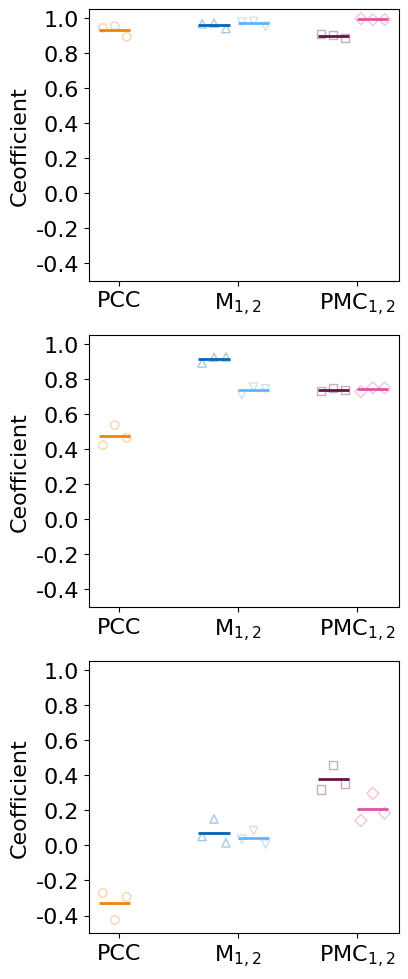

In [ ]:
### Compare the various colocalization and mixing coefficients across the examples in Figure 5
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(4,12))
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']
xs = np.array([0.0,0.125,0.175,0.275,0.325])
markers = ['o','^','v','s','D']

d = [mito_pearsons,mito_manders1,mito_manders2,mito_pmc1,mito_pmc2]
for jj in range(len(xs)):
    ax[0].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')
    
ax[0].set_ylim([-0.5,1.05])
ax[0].set_xticks([],labels=[])

ax[0].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

d = [myo_pearsons,myo_manders1,myo_manders2,myo_pmc1,myo_pmc2]
for jj in range(len(xs)):
    ax[1].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')
    
ax[1].set_ylim([-0.5,1.05])
ax[1].set_xticks([],labels=[])

ax[1].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

d = [nuc_pearsons,nuc_manders1,nuc_manders2,nuc_pmc1,nuc_pmc2]
for jj in range(len(xs)):
    ax[2].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')
    
ax[2].set_ylim([-0.5,1.05])
ax[2].set_xticks([],labels=[])

ax[2].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

for axes in ax.ravel():

    axes.set_xticks([0.0,0.15,0.3],labels=['PCC',r'M$_{1,2}$',r'PMC$_{1,2}$'],rotation=0,fontsize=16)
    axes.set_yticks(np.arange(-0.4,1.1,0.2),labels=['-0.4','-0.2','0.0','0.2','0.4','0.6','0.8','1.0'],fontsize=16)
    axes.set_ylabel('Ceofficient',fontsize=16)
    
save_dir = os.path.join(droot,'fig5/figures')
# fig.savefig(save_dir+f'mito_myo_nuc_coeffs_new_color_corrected_sep.svg',dpi=300)


# Figure 6

#### Data

Finished clustering data for PC_1...
Determined peak at [0.30612245 0.67346939]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.65179879 -0.03369218]for PC_2
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.73402033 0.73336919]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.73141537 0.73594811]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.73963457 0.74402563]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a

/mnt/homedir/data/phasor/manuscript_data/revisions/pmc/pmc.py:1418: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1,ax2,ax3) = plt.subplots(nrows=1,ncols=3,figsize=(15,5))


myosin has a colocalization factor of [0.75086469 0.75220647]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.74761074 0.74637649]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.74827831 0.74589866]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
myosin has a colocalization factor of [0.74003618 0.7514069 ]


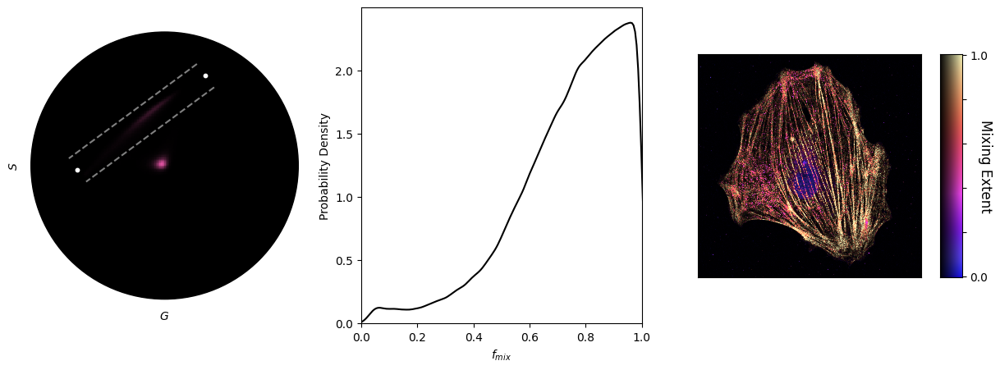

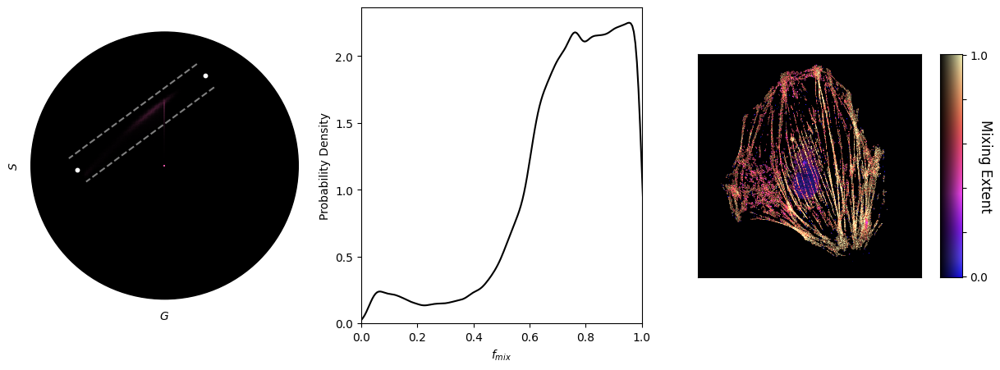

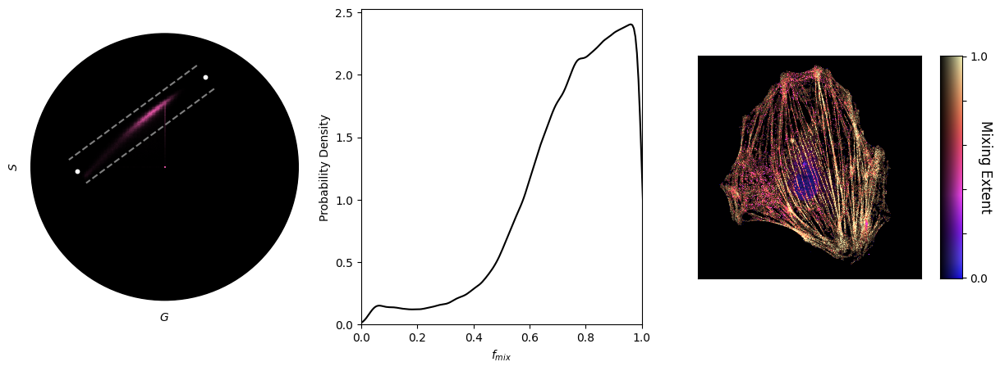

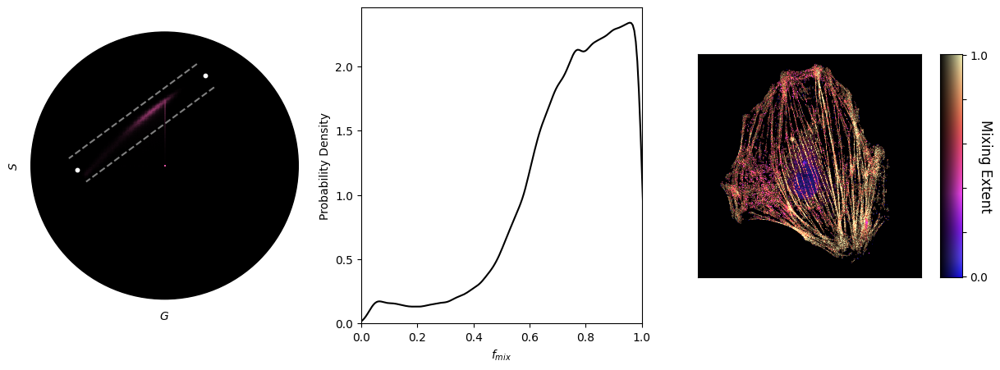

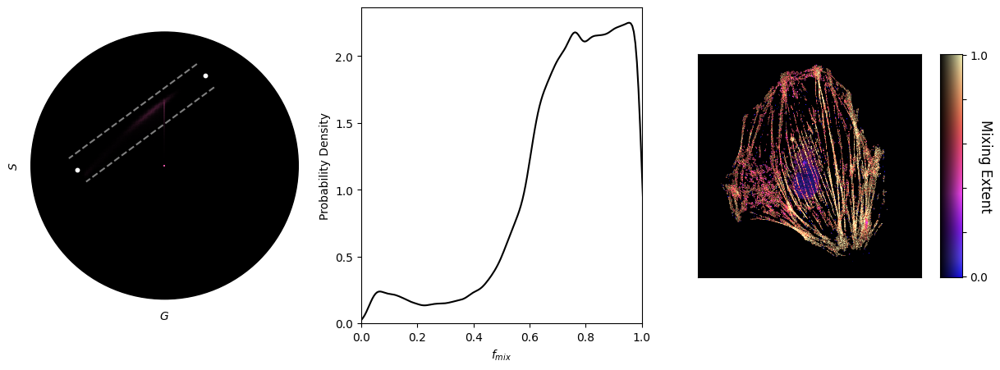

...

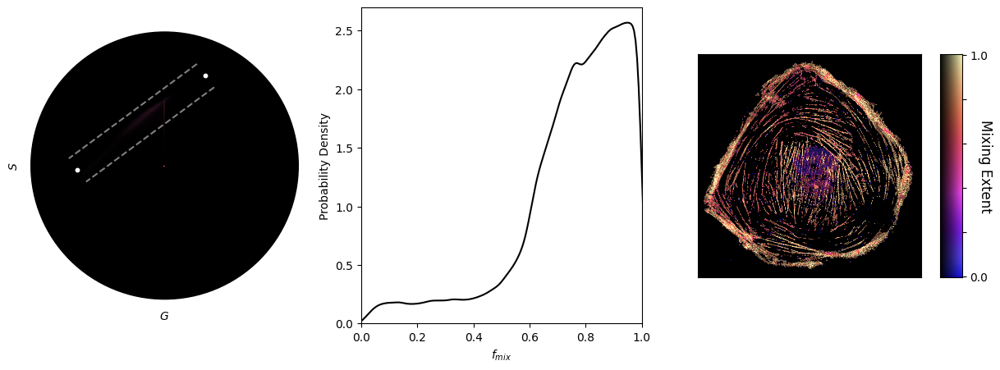

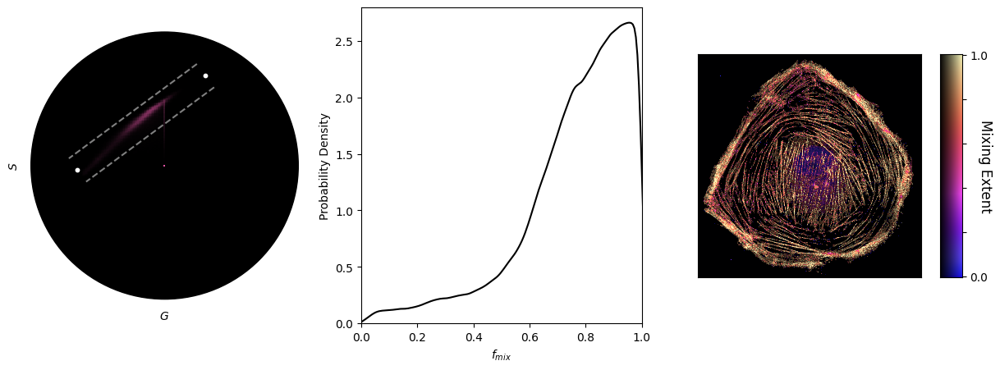

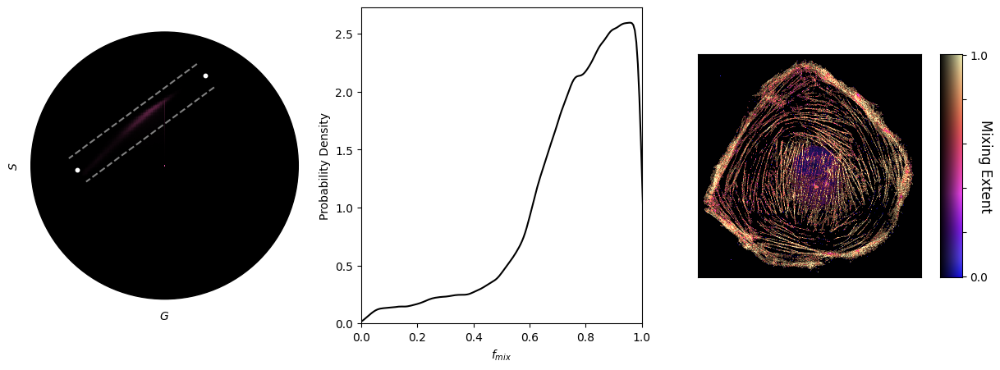

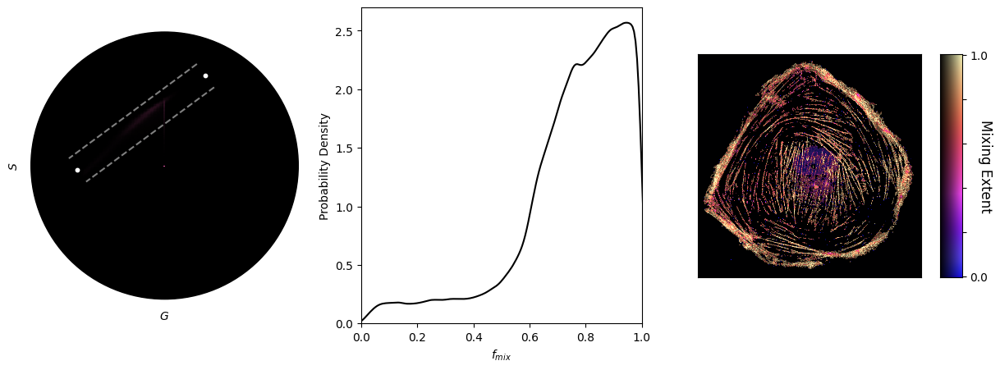

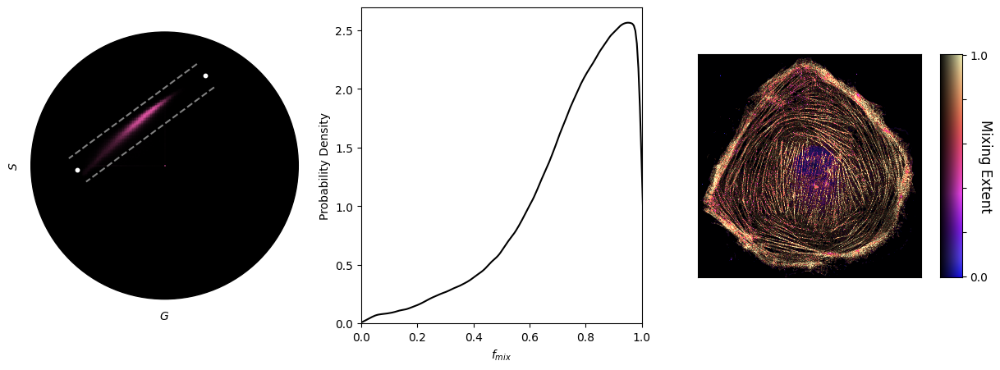

In [79]:
### Calcualte the colocalization and mixing after applying intensity thresholds determined through various methods, comparing to no threshold

data_dir = os.path.join(droot,f'fig6')
methods = [None,'otsu','li','mean','iso','triangle']
ns = [1,2,4,7]
exps_myo = dict()
pc1 = PC(file=data_dir+'/Ptk_MHC-AF488_01.czi',name='PC_1',thresh=None,filt=False)
pc2 = PC(file=data_dir+'/Ptk_RLC-AF568_02.czi',name='PC_2',thresh=None,filt=False)
pc1.determine_peak(pk_flag='test')
pc2.determine_peak(pk_flag='test')
myo_colocs_new = np.zeros((len(ns),len(methods),2))
myo_pearsons_new = np.zeros((len(ns),len(methods)))
myo_manders1_new = np.zeros((len(ns),len(methods)))
myo_manders2_new = np.zeros((len(ns),len(methods)))
myo_mandersO_new = np.zeros((len(ns),len(methods)))
myo_crop_dims = [[350,1500,170,1320],[110,1440,50,1380],[90,1440,20,1370],[30,1430,50,1450]]
for ni, jj in zip(ns,range(len(ns))):
    fname = data_dir+'/Ptk_MHC-AF488_RLC-AF568_0'+str(ni)+'.czi'
    
    pmcs = np.zeros(len(methods))
    pmcs_var = np.zeros(len(methods))
    pearsons = np.zeros(len(methods))
    manders1 = np.zeros(len(methods))
    manders2 = np.zeros(len(methods))
    mandersO = np.zeros(len(methods))
    for method, j in zip(methods,range(len(methods))):
        mix = PairMixture(file=fname,name='myosin',
                    pcs=[pc1,pc2],thresh=method,filt=True,crop_dims=myo_crop_dims[jj])
        mix.analyze_overlap();
        mix.calc_pearson_mander(pcs=mix.purecomps);
        # print([mix.pearsons,mix.manders1,mix.manders2])
        pmcs[j] = mix.coloc_vec[0]
        pmcs_var[j] = mix.coloc_vec[1]
        pearsons[j] = mix.pearsons
        manders1[j] = mix.manders1
        manders2[j] = mix.manders2
        mandersO[j] = mix.mandersO
        
    myo_colocs_new[jj,:,0] = pmcs[:]
    myo_colocs_new[jj,:,1] = pmcs_var[:]
    myo_pearsons_new[jj,:] = pearsons[:]
    myo_manders1_new[jj,:] = manders1[:]
    myo_manders2_new[jj,:] = manders2[:]
    myo_mandersO_new[jj,:] = mandersO[:]

[array([0.99954897, 0.99955535, 0.99977841, 0.99974857]), array([0.99925804, 0.9992071 , 0.99950588, 0.99916689])]
[array([0.89142848, 0.92405434, 0.92579094, 0.88151241]), array([0.70993954, 0.75379806, 0.74352771, 0.69912426])]
[array([0.97994434, 0.9854512 , 0.97561722, 0.96228478]), array([0.82844721, 0.86446788, 0.8498484 , 0.80990846])]
[array([0.96266154, 0.97877308, 0.95478044, 0.93827548]), array([0.83767914, 0.88138579, 0.85466373, 0.81922786])]
[array([0.89142848, 0.92705019, 0.92752336, 0.87982176]), array([0.70993954, 0.75149491, 0.74608623, 0.70382573])]
[array([0.99635838, 0.99569169, 0.99922207, 0.99850009]), array([0.96326063, 0.9698179 , 0.96385606, 0.96018097])]
[array([0.73402033, 0.75212634, 0.73696858, 0.70914551]), array([0.73336919, 0.7554036 , 0.75433286, 0.72318454])]
[array([0.73141537, 0.77410299, 0.80228508, 0.74931628]), array([0.73594811, 0.78479364, 0.8249543 , 0.74750032])]
[array([0.73963457, 0.77483188, 0.77868223, 0.75086469]), array([0.74402563, 0.7

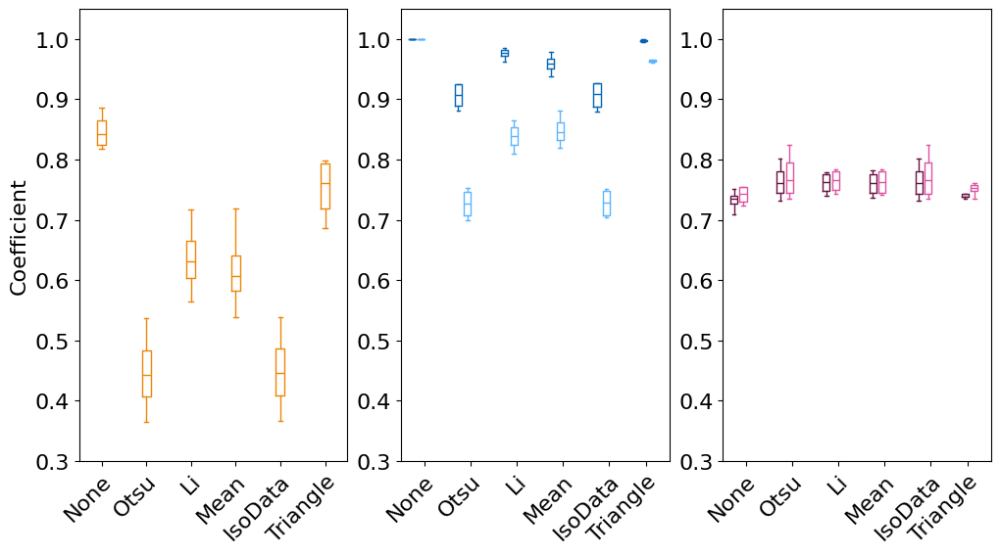

In [80]:
# colors = ['#EC8609','#576553','#0486F1','#671343','#DF53A2']

def setBoxColors(bp,c):
    plt.setp(bp['boxes'], color=c)
    plt.setp(bp['caps'], color=c)
    plt.setp(bp['caps'], color=c)
    plt.setp(bp['whiskers'], color=c)
    plt.setp(bp['whiskers'], color=c)
    # setp(bp['fliers'][0], color='blue')
    # setp(bp['fliers'][1], color='blue')
    plt.setp(bp['medians'], color=c)

fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(12,6))


bp = ax[0].boxplot(myo_pearsons_new, positions = np.arange(1,7), widths = 0.2, showfliers=False)
setBoxColors(bp,c=colors[0])

for j in range(len(methods)):
    A = [myo_manders1_new[:,j],myo_manders2_new[:,j]]
    print(A)
    bp = ax[1].boxplot(A, positions = np.arange((5*j)+1,(5*j)+3)+0.2, widths = 0.75, showfliers=False)
    # setBoxColors(bp,c='green')
    color = colors[1]
    plt.setp(bp['boxes'][0], color=color)
    plt.setp(bp['caps'][0], color=color)
    plt.setp(bp['caps'][1], color=color)
    plt.setp(bp['caps'][2], color=color)
    plt.setp(bp['whiskers'][0], color=color)
    plt.setp(bp['whiskers'][1], color=color)
    plt.setp(bp['whiskers'][2], color=color)
    plt.setp(bp['medians'][0], color=color)

    color = colors[2]
    plt.setp(bp['boxes'][1], color=color)
    plt.setp(bp['caps'][2], color=color)
    plt.setp(bp['caps'][3], color=color)
    plt.setp(bp['whiskers'][2], color=color)
    plt.setp(bp['whiskers'][3], color=color)
    plt.setp(bp['medians'][1], color=color)

ax[1].set_xlim([0.0,29])
ax[1].set_xticks([2.5,7.5,12.5,17.5,22.5,26.5])
# ax[1].set_xticklabels(['None'] + methods[1:])
# ax[0].set_xticklabels(['None'] + methods[1:])
ax[1].set_xticklabels(['None','Otsu','Li','Mean','IsoData','Triangle'],fontsize=16,rotation=45,rotation_mode='anchor',ha='right')
ax[0].set_xticklabels(['None','Otsu','Li','Mean','IsoData','Triangle'],fontsize=16,rotation=45,rotation_mode='anchor',ha='right')

for j in range(len(methods)):
    A = [myo_colocs_new[:,j,0],myo_colocs_new[:,j,1]]
    print(A)
    bp = ax[2].boxplot(A, positions = np.arange((5*j)+1,(5*j)+3)+0.2, widths = 0.75, showfliers=False)
    # setBoxColors(bp,c='green')
    color = colors[3]
    plt.setp(bp['boxes'][0], color=color)
    plt.setp(bp['caps'][0], color=color)
    plt.setp(bp['caps'][1], color=color)
    plt.setp(bp['caps'][2], color=color)
    plt.setp(bp['whiskers'][0], color=color)
    plt.setp(bp['whiskers'][1], color=color)
    plt.setp(bp['whiskers'][2], color=color)
    plt.setp(bp['medians'][0], color=color)

    color = colors[4]
    plt.setp(bp['boxes'][1], color=color)
    plt.setp(bp['caps'][2], color=color)
    plt.setp(bp['caps'][3], color=color)
    plt.setp(bp['whiskers'][2], color=color)
    plt.setp(bp['whiskers'][3], color=color)
    plt.setp(bp['medians'][1], color=color)

for j in range(len(ax)):
    ax[j].set_ylim([0.3,1.05])
    ax[j].set_yticks(np.arange(0.3,1.1,0.1),[str(np.round(i,decimals=2)) for i in np.arange(0.3,1.1,0.1)],fontsize=16)

ax[0].set_ylabel('Coefficient',fontsize=16)

ax[2].set_xlim([0.0,29])
ax[2].set_xticks([2.5,7.5,12.5,17.5,22.5,26.5])
ax[2].set_xticklabels(['None','Otsu','Li','Mean','IsoData','Triangle'],fontsize=16,rotation=45,rotation_mode='anchor',ha='right')

save_dir = os.path.join(droot,'fig6/figures')
# plt.savefig(os.path.join(save_dir,f'/threshold_methods_new_color_corrected.svg'),format='svg',dpi=300)

In [81]:
import scipy.stats
for j in range(1,myo_colocs_new.shape[1]):
    test = scipy.stats.ttest_ind(myo_colocs_new[:,0],myo_colocs_new[:,j])
    print(test.pvalue)

print(r'\n')
for j in range(1,myo_pearsons_new.shape[1]):
    test = scipy.stats.ttest_ind(myo_pearsons_new[:,0],myo_pearsons_new[:,j])
    print(test.pvalue)

print(r'\n')
for j in range(1,myo_pearsons_new.shape[1]):
    test = scipy.stats.ttest_ind(myo_manders2_new[:,0],myo_manders2_new[:,j])
    print(test.pvalue)

[0.12980331 0.19301566]
[0.07447568 0.11598688]
[0.10246107 0.16843895]
[0.13378474 0.2008319 ]
[0.3814557  0.36607571]
\n
5.431490608673858e-05
0.001033292784166376
0.001317806287293888
5.660134648785266e-05
0.022117580830821798
\n
7.997647331151659e-07
1.0453849165513459e-05
2.6815996663296445e-05
5.422387265757118e-07
2.336853996453536e-06


#### Summed Intensity Images after Applying Threshold (Otsu's method)

Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]
Filtering Phasor Coordinates...
PC_1 is already clustered... Peak at [0.30612245 0.67346939]
PC_2 is already clustered... Peak at [-0.65179879 -0.03369218]


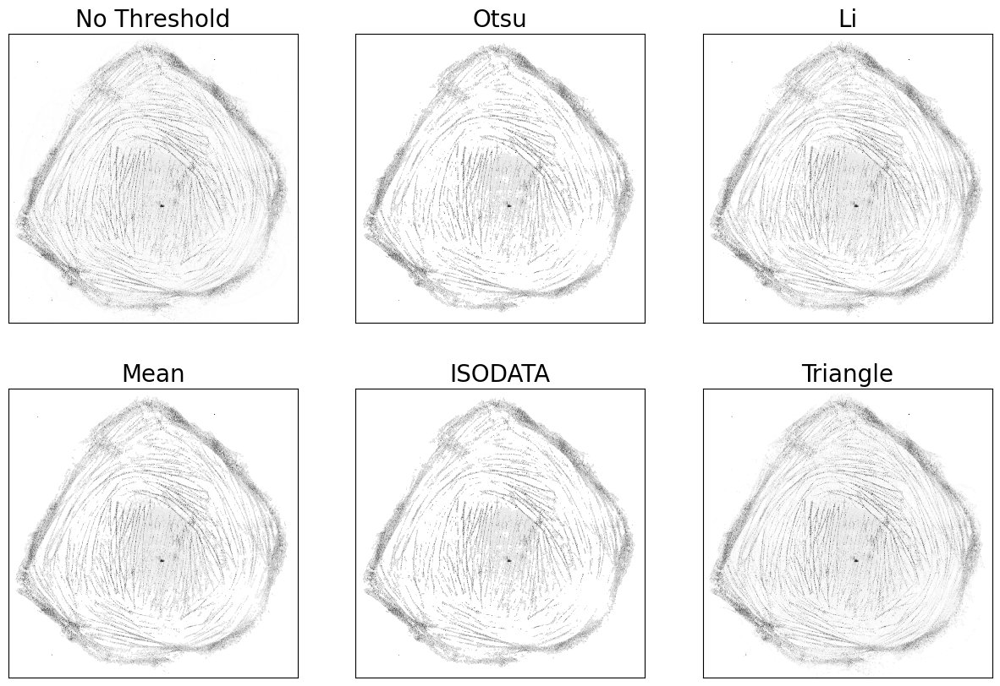

In [88]:
ns = [1,2,4,7]
myo_crop_dims = [[350,1500,170,1320],[110,1440,50,1380],[90,1440,20,1370],[30,1430,50,1450]]
methods = [None,'otsu','li','mean','iso','triangle']
fname = data_dir+'/Ptk_MHC-AF488_RLC-AF568_0'+str(ni)+'.czi'
myo_id = 3
fig_labels = ['No Threshold','Otsu','Li',
              'Mean','ISODATA','Triangle']

fig, ax = plt.subplots(nrows=2,ncols=3,figsize=(15,10))
for method, axes, label in zip(methods,ax.ravel(), fig_labels):
    fname = data_dir+'/Ptk_MHC-AF488_RLC-AF568_0'+str(ns[myo_id])+'.czi'
    mix = PairMixture(file=fname,name='myosin',pcs=[pc1,pc2],thresh=method,filt=True,crop_dims=myo_crop_dims[myo_id])
    img = np.sum(np.nan_to_num(mix.intensity),axis=-1)
    if method is None:
        max_val = np.amax(img)
    axes.pcolormesh(np.flipud(np.sum(np.nan_to_num(mix.intensity),axis=-1)),cmap='Greys',vmax=max_val)
    axes.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        labelbottom=False,
        left=False,
        right=False,
        labelleft=False
    )
    axes.set_aspect('equal'); 
    axes.set_title(label,fontsize=20)
    
save_dir = os.path.join(droot,'fig6/figures')
plt.savefig(os.path.join(save_dir,f'fig6_threshold_method_images.png'),dpi=300,transparent=True,bbox_inches='tight')

# Figure 7

##### PCs

In [144]:
laser_powers = ['_0p01-488_0p1-561','_0p06-488_0p3-561','_0p12-488_0p6-561',
                '_0p18-488_0p9-561','_0p24-488_1p2-561','_0p3-488_1p5-561']

### Determine the PC coordinates for single-color samples for a range of laser powers (effective SNR)
data_dir_lp = os.path.join(droot,f'fig7/')
pcs_lp = dict()
for lp in laser_powers:
    pc1_temp = PC(file=data_dir_lp+'greenonly_cell1/Ptk_MHC-AF488_01'+lp+'.czi',name='PC_1',thresh='iso',filt=False)
    pc2_temp = PC(file=data_dir_lp+'redonly_cell1/Ptk_RLC-AF568_01'+lp+'.czi',name='PC_2',thresh='iso',filt=False)
    pc1_temp.determine_peak()
    pc2_temp.determine_peak()
    
    pcs_lp[lp] = dict(zip(['pc1','pc2'],[pc1_temp,pc2_temp]))

Finished clustering data for PC_1...
Determined peak at [0.24617343 0.51148953]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.51820661 -0.00877344]for PC_2
Finished clustering data for PC_1...
Determined peak at [0.27241652 0.64611986]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.59712973 -0.03840595]for PC_2
Finished clustering data for PC_1...
Determined peak at [0.2743609  0.66581644]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.61505893 -0.03555665]for PC_2
Finished clustering data for PC_1...
Determined peak at [0.28626836 0.6728372 ]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.62628032 -0.01573223]for PC_2
Finished clustering data for PC_1...
Determined peak at [0.27587075 0.6690661 ]for PC_1
Finished clustering data for PC_2...
Determined peak at [-0.65522378 -0.01929266]for PC_2
Finished clustering data for PC_1...
Determined peak at [0.27523482 0.67346939]for PC_1
Finished clustering da

###### Effect of SNR on PC Cluster Size (Fig S5)

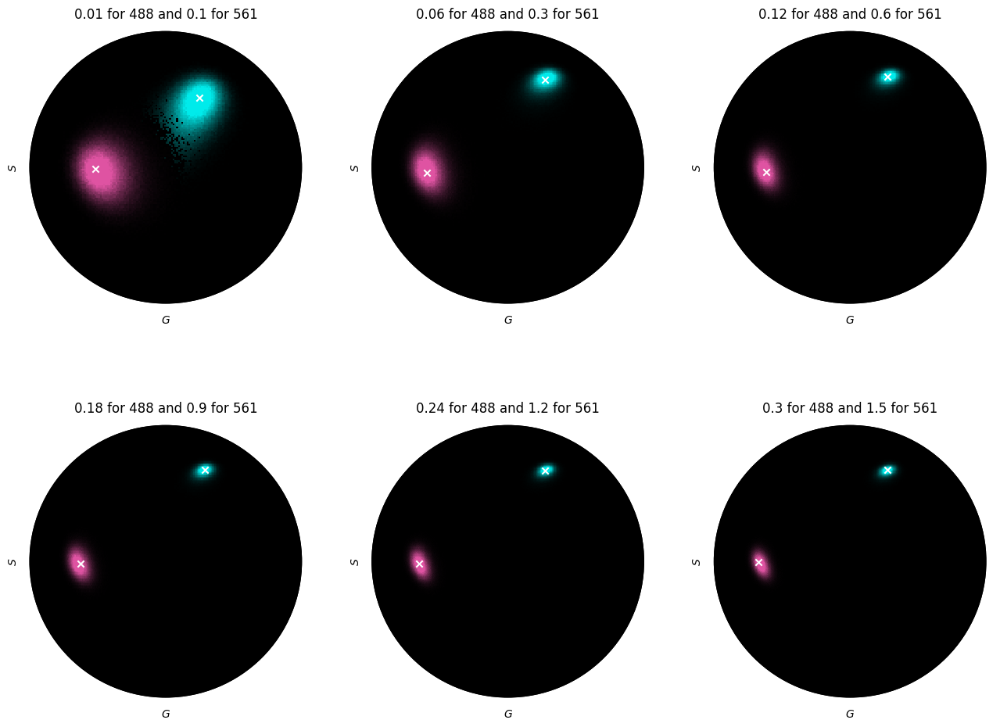

In [ ]:
fig, axes = plt.subplots(nrows=2,ncols=int(len(laser_powers)/2),figsize=(16,12))

for key, ax, lp in zip(pcs_lp,axes.ravel(), laser_powers):
    pcs_lp[key]['pc1'].plot_hist_with_peaks(ax1=ax,cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']),p_max=0.75)
    pcs_lp[key]['pc2'].plot_hist_with_peaks(ax1=ax,p_max=0.75)
    
    temp = lp[1:]
    name = temp.replace('p','.').replace('-',' for ').replace('_',' and ')
    ax.set_title(name)
    
save_dir = os.path.join(droot,'fig_s6')
# fig.savefig(save_dir+'pcs_across_lps.png',dpi=300)

#### Combined

###### Mixture

PC_1 is already clustered... Peak at [0.24617343 0.51148953]
PC_2 is already clustered... Peak at [-0.51820661 -0.00877344]
0.01_488_0.1_561 has a colocalization factor of [0.65901966 0.79787354]
PC_1 is already clustered... Peak at [0.27241652 0.64611986]
PC_2 is already clustered... Peak at [-0.59712973 -0.03840595]
0.06_488_0.3_561 has a colocalization factor of [0.62072548 0.70043772]
PC_1 is already clustered... Peak at [0.2743609  0.66581644]
PC_2 is already clustered... Peak at [-0.61505893 -0.03555665]
0.12_488_0.6_561 has a colocalization factor of [0.62457162 0.67683396]
PC_1 is already clustered... Peak at [0.28626836 0.6728372 ]
PC_2 is already clustered... Peak at [-0.62628032 -0.01573223]
0.18_488_0.9_561 has a colocalization factor of [0.63751429 0.66786175]
PC_1 is already clustered... Peak at [0.27587075 0.6690661 ]
PC_2 is already clustered... Peak at [-0.65522378 -0.01929266]
0.24_488_1.2_561 has a colocalization factor of [0.64073492 0.65491967]
PC_1 is already clus

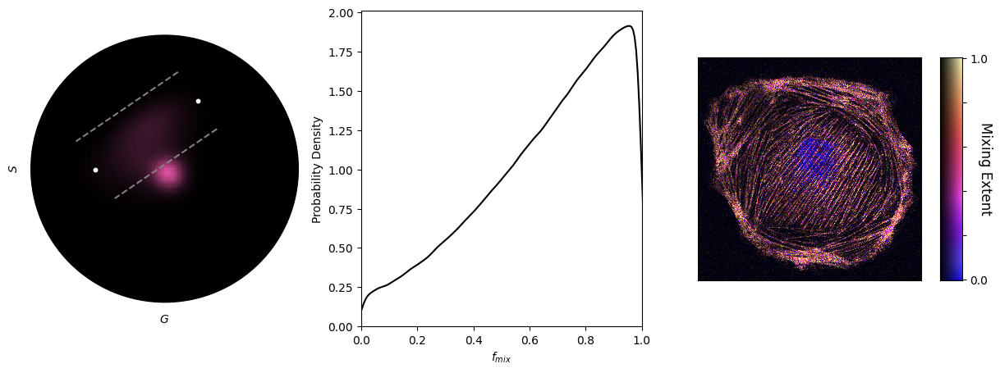

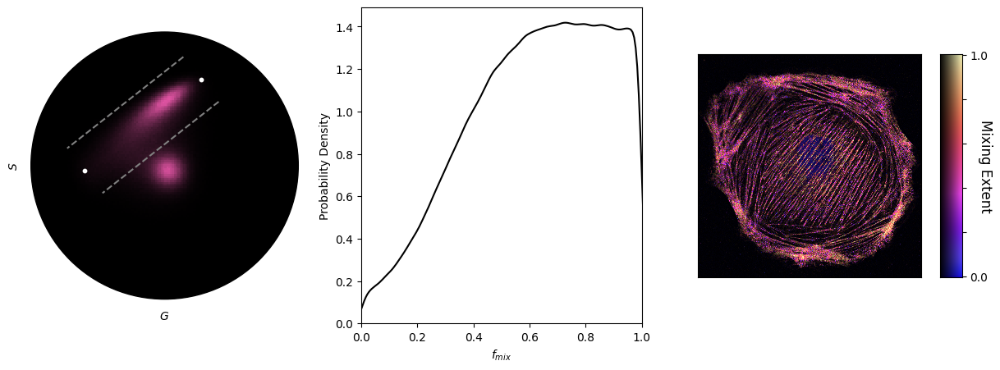

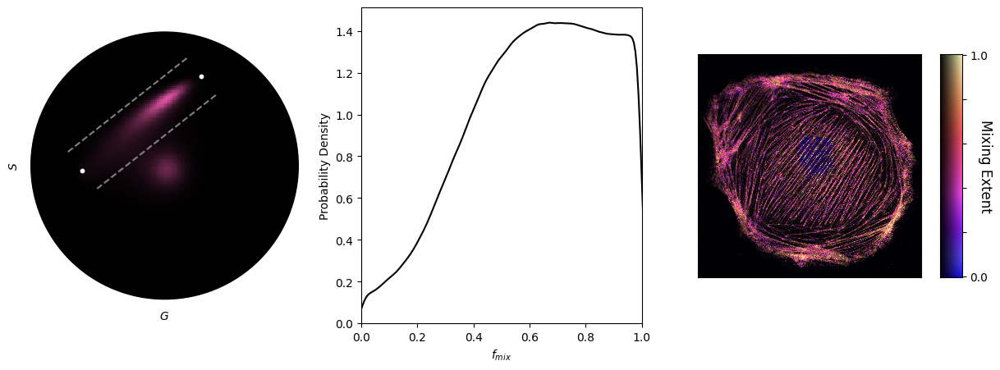

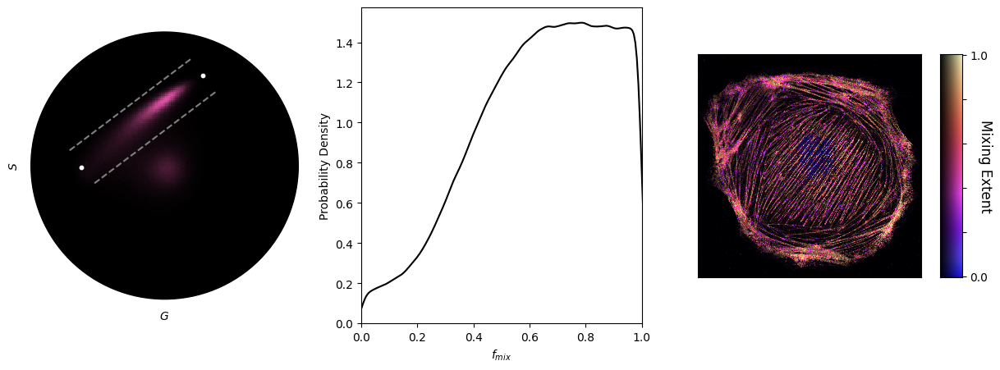

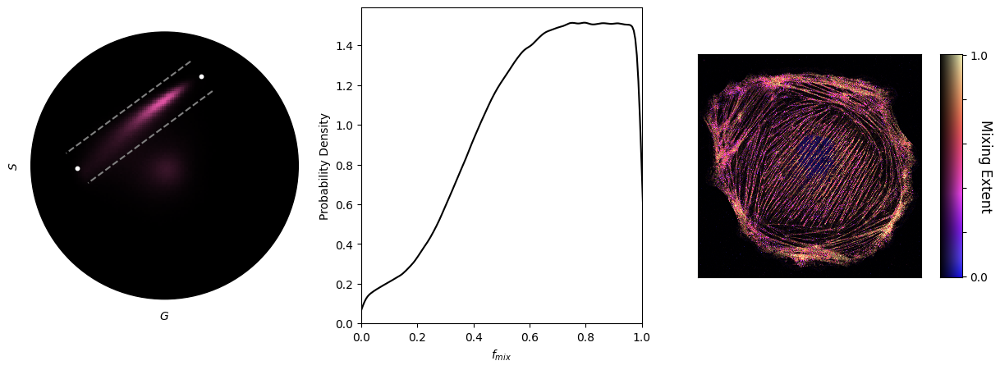

...

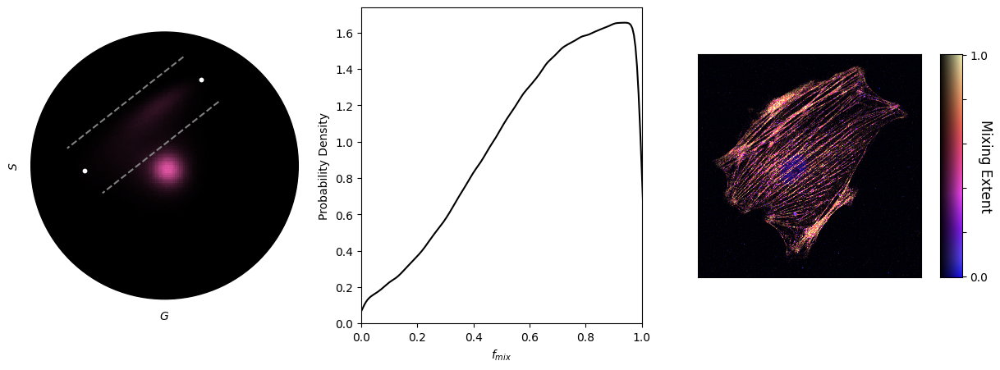

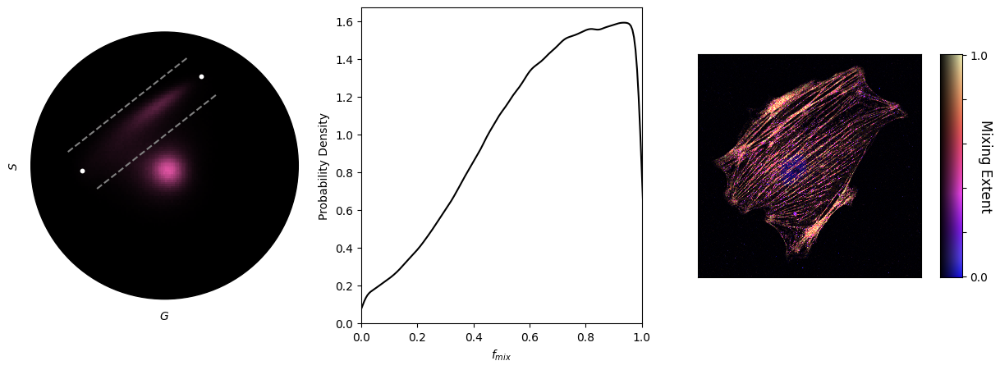

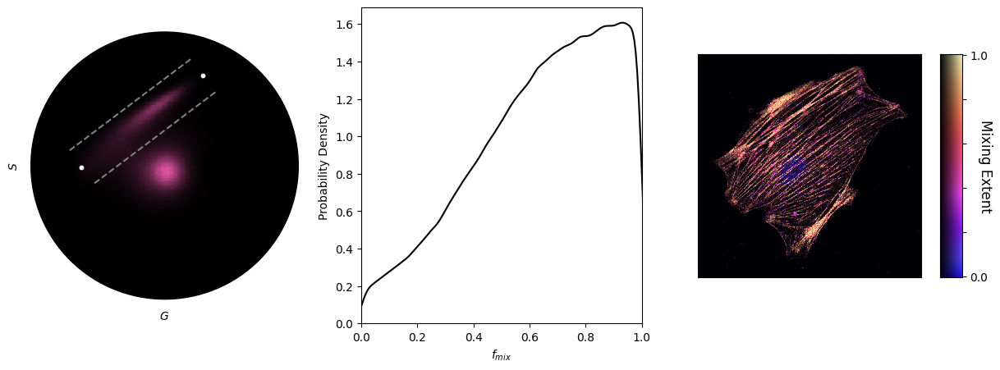

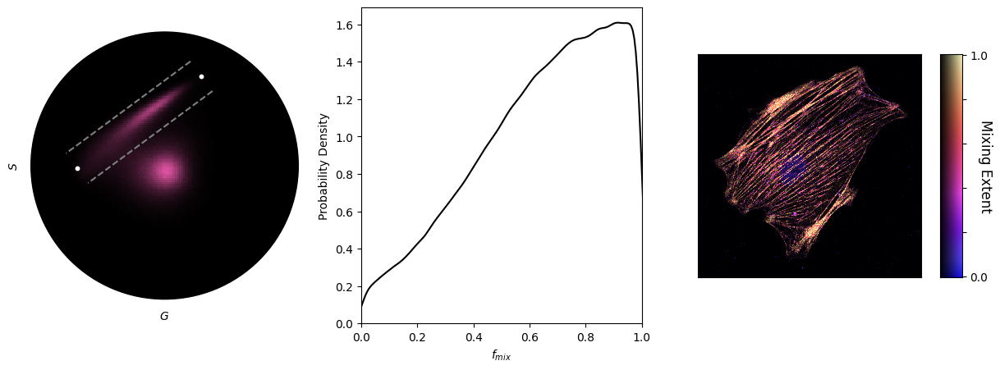

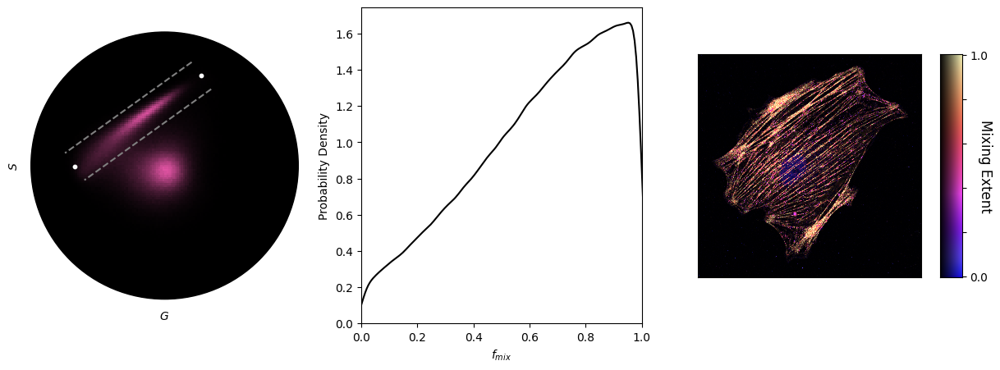

In [315]:
### Calculate the colocalization and mixing as a function of laser power (effective SNR)

data_dir_lp = os.path.join(droot,f'fig7/')
exps_combined_new = dict()
# for lp in laser_powers:
cells = [3,4,5]
lp_crop_dims = [[230,1580,120,1470],[60,1510,100,1550],[150,1450,200,1500]]
for cell, j in zip(cells,range(len(cells))):
    ddir = data_dir_lp+'dualcolor_cell'+str(cell)
    fname = '/Ptk_MHC-AF488_RLC-AF568_0'+str(cell)
    exps_temp = dict()
    for lp in laser_powers:
        # fig, ax1 = plt.subplots(nrows=1,ncols=3,figsize=(18,5))
        temp = lp[1:]
        name = temp.replace('p','.').replace('-','_')
        pc1_temp = pcs_lp[lp]['pc1']
        pc2_temp = pcs_lp[lp]['pc2']

        mix = PairMixture(file=ddir+fname+lp+'.czi',name=name,pcs=[pc1_temp,pc2_temp],
                          thresh=None,filt=False,crop_dims=lp_crop_dims[j])
        mix.analyze_overlap()
        mix.calc_pearson_mander(pcs=mix.purecomps,thresh_override=True,thresh_method='otsu')
        exps_temp[lp] = dict(zip(['pc1','pc2','mix'],[pc1_temp,pc2_temp,mix]))

    exps_combined_new[str(cell)] = exps_temp

###### Display

In [ ]:
# 20 um scalebar
20/(123.29/60)

9.733149484954174

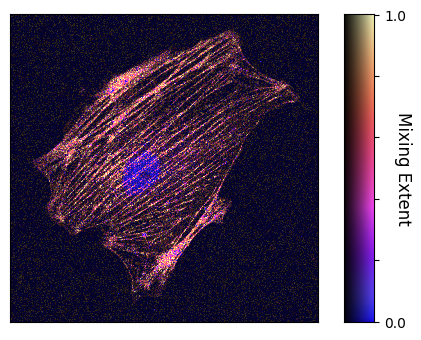

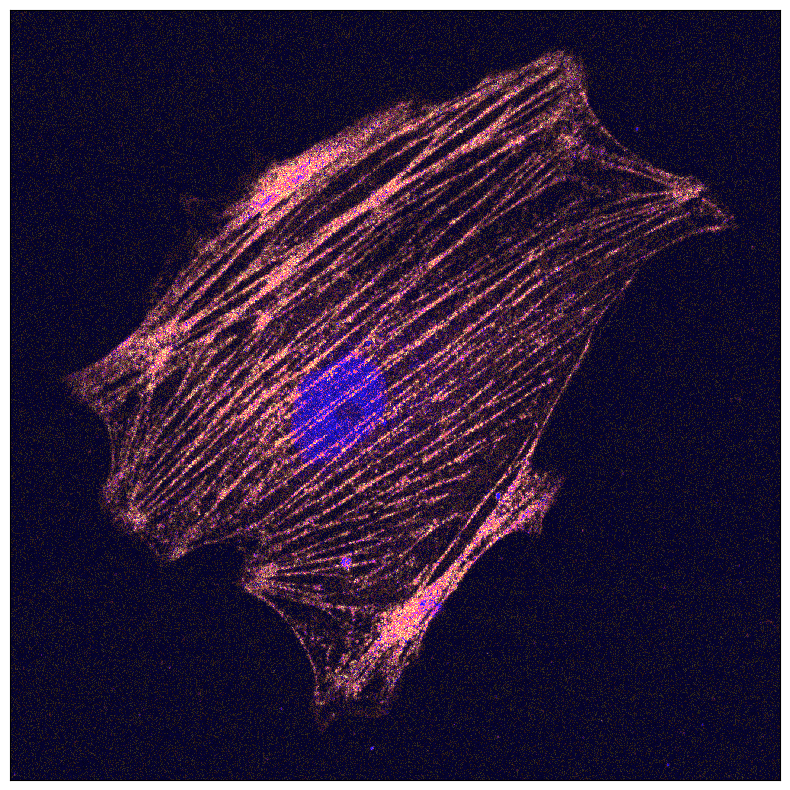

In [ ]:
save_dir = os.path.join(droot,f'fig7/figures')
fig, ax = plt.subplots(figsize=(5,5))
exps_combined_new['5'][laser_powers[0]]['mix'].color_mixing_image(ax1=ax,lims=[0,98])


fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(exps_combined_new['5'][laser_powers[0]]['mix'].im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

# plt.savefig(os.path.join(save_dir,f'cell5_lp0_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

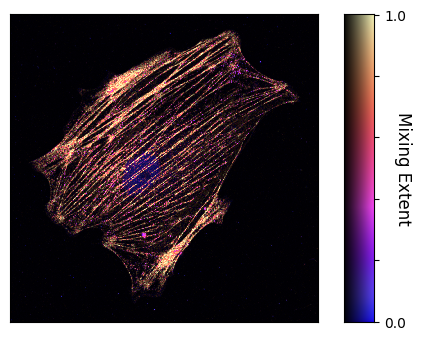

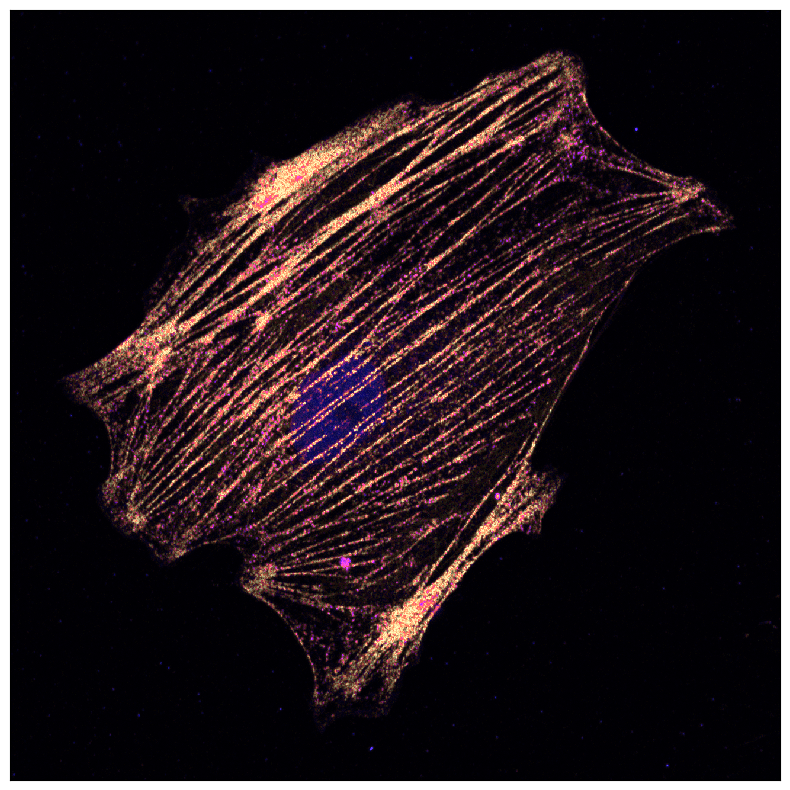

In [ ]:
save_dir = os.path.join(droot,'fig7/figures/')
fig, ax = plt.subplots(figsize=(5,5))
exps_combined_new['5'][laser_powers[-1]]['mix'].color_mixing_image(ax1=ax,lims=[0,98])


fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(np.flipud(exps_combined_new['5'][laser_powers[-1]]['mix'].im_2DLUT))
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

plt.savefig(os.path.join(save_dir,f'cell5_lp6_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

###### Plot

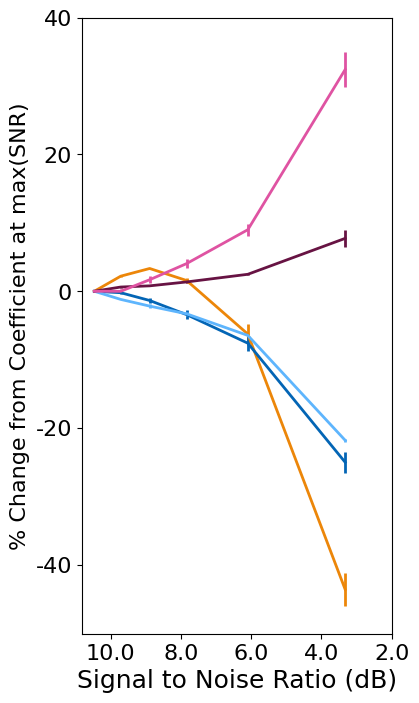

In [ ]:
coloc = np.zeros((3,len(laser_powers)))
coloc_vars = np.zeros((3,len(laser_powers)))
pearsons = np.zeros((3,len(laser_powers)))
manders1 = np.zeros((3,len(laser_powers)))
manders2 = np.zeros((3,len(laser_powers)))

for key, j in zip(exps_combined_new,range(3)):
    for lp, i in zip(exps_combined_new[key], range(len(laser_powers))):
        coloc[j,i] = exps_combined_new[key][lp]['mix'].coloc
        coloc_vars[j,i] = exps_combined_new[key][lp]['mix'].var_norm
        pearsons[j,i] = exps_combined_new[key][lp]['mix'].pearsons
        manders1[j,i] = exps_combined_new[key][lp]['mix'].manders1
        manders2[j,i] = exps_combined_new[key][lp]['mix'].manders2
        
coloc_norm = np.zeros((3,6))
coloc_norm_err = np.zeros((3,6))
coloc_var_norm = np.zeros((3,6))
coloc_var_norm_err = np.zeros((3,6))
pearsons_norm = np.zeros((3,6))
manders1_norm = np.zeros((3,6))
manders2_norm = np.zeros((3,6))
for j in range(3):

    coloc_norm[j,:] = (coloc[j,:]-coloc[j,-1])/coloc[j,-1]
    coloc_var_norm[j,:] = (coloc_vars[j,:]-coloc_vars[j,-1])/coloc_vars[j,-1]
    pearsons_norm[j,:] = (pearsons[j,:]-pearsons[j,-1])/pearsons[j,-1]
    manders1_norm[j,:] = (manders1[j,:]-manders1[j,-1])/manders1[j,-1]
    manders2_norm[j,:] = (manders2[j,:]-manders2[j,-1])/manders2[j,-1]
    
def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)

snrs = np.zeros((3,len(laser_powers)))
for key, j in zip(exps_combined_new,range(3)):
    for lp, i in zip(exps_combined_new[key], range(len(laser_powers))):

        temp_im = np.sum(exps_combined_new[key][lp]['mix'].intensity_orig,axis=-1)
        thresh_val = threshold_triangle(temp_im)

        binary = temp_im > thresh_val

        snrmean = np.mean(np.nan_to_num(temp_im[binary],nan=0.0))/np.mean(np.nan_to_num(temp_im[~binary],nan=0.0))    
        snrs[j,i] = snrmean
        
coloc_mns = np.mean(100.0*coloc_norm[1:],axis=0)
coloc_errs = np.std(100.0*coloc_norm[1:],axis=0)/np.sqrt(3)

coloc_var_mns = np.mean(100.0*coloc_var_norm[1:],axis=0)
coloc_var_errs = np.std(100.0*coloc_var_norm[1:],axis=0)/np.sqrt(3)

pearsons_mns = np.mean(100.0*pearsons_norm[1:],axis=0)
pearsons_errs = np.std(100.0*pearsons_norm[1:],axis=0)/np.sqrt(3)

manders1_mns = np.mean(100.0*manders1_norm[1:],axis=0)
manders1_errs = np.std(100.0*manders1_norm[1:],axis=0)/np.sqrt(3)

manders2_mns = np.mean(100.0*manders2_norm[1:],axis=0)
manders2_errs = np.std(100.0*manders2_norm[1:],axis=0)/np.sqrt(3)

stat_mns = [pearsons_mns,manders1_mns,manders2_mns,coloc_mns,coloc_var_mns]
stat_errs = [pearsons_errs,manders1_errs,manders2_errs, coloc_errs,coloc_var_errs]

fig, ax = plt.subplots(figsize=(4,8))
for j in range(len(stat_mns)):
    # print(2*(np.amax(stat_mn[-1])-np.amin(stat_mn[0]))/(np.amax(stat_mn[-1])+np.amin(stat_mn[0])))
    # plt.errorbar(np.mean(snrs,axis=0),stat_mns[j],stat_errs[j],c=cs[j])
    # plt.errorbar([0.1,0.3,0.6,0.9,1.2,1.5],stat_mns[j],stat_errs[j],c=cs[j])
    snr_temp = 10*np.log10(np.mean(snrs,axis=0))
    mn = stat_mns[j]
    err = stat_errs[j]
    ax.errorbar(x=snr_temp[::-1],y=mn[::-1],yerr=err[::-1],c=colors[j],lw=2)
    # plt.scatter(10*np.log10(np.mean(snrs,axis=0)),stat_mns[j],c=cs[j])

ax.xaxis.set_inverted(True)
plt.xticks([2.0,4.0,6.0,8.0,10.0],[str(x) for x in [2.0,4.0,6.0,8.0,10.0]],fontsize=16)
plt.yticks([-40,-20,0,20,40],[str(x) for x in [-40,-20,0,20,40]],fontsize=16)
plt.xlabel('Signal to Noise Ratio (dB)',fontsize=18)
plt.ylabel(r'% Change from Coefficient at max(SNR)',fontsize=16)
# plt.legend([r'PMC$_1$','Pearson\'s','Mander\'s Overlap',r'PMC$_2$'])

save_dir = os.path.join(droot,'fig7/figures/')
# plt.savefig(os.path.join(save_dir,f'snr_comparison_pcc_m1_m2_pmc_color_corrected_new.svg'),dpi=300,transparent=True,bbox_inches='tight')

In [355]:
print(10*np.log10(np.mean(snrs,axis=0)))

[ 3.3264019   6.09628568  7.8377191   8.88973667  9.71425754 10.46517322]


In [343]:
print(coloc_mns)
print(coloc_var_mns)
print(pearsons_mns)
print(manders1_mns)
print(manders2_mns)

[7.73474886 2.48205564 1.36317871 0.7932514  0.61892068 0.        ]
[ 3.24239059e+01  9.00270222e+00  4.04997479e+00  1.68677168e+00
 -7.80598547e-03  0.00000000e+00]
[-43.60300553  -6.26064564   1.57071693   3.33045901   2.20588475
   0.        ]
[-25.00535806  -7.59525064  -3.41963654  -1.35062178  -0.21129181
   0.        ]
[-21.79322664  -6.45995679  -3.302175    -2.17062857  -1.19032256
   0.        ]


# Figure 8

### Unmix PCs

Phasor Plots (Figure S7)

Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Filtering Phasor Coordinates...


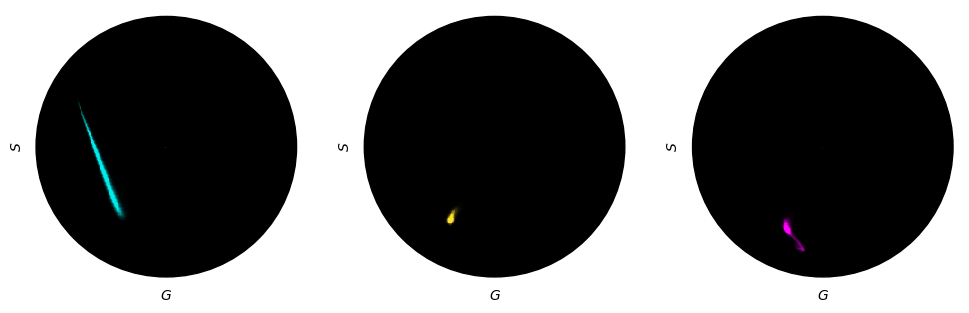

In [ ]:
### Plot the three "PCs" without removing the CellTrace to display its effect

data_dir = os.path.join(droot,f'fig8/one-color-plus-cellTrace/')

fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(12,6))
# mito_only = Phasor(file=data_dir+'3. MitoOnly_2x_0.3%_1.czi',name='mitos',filt=True,thresh=None)
mito_only = Phasor(file=data_dir+'6. LAMP1+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.czi',name='mitos',filt=True,thresh='triangle')
mito_only.plot_phasor(ax1=ax[0],p_max=0.5, cmap=lsm.from_list(name = 'test', colors=['0','#00ebebff']))

phal_only = Phasor(file=data_dir+'5. Tomm20+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.czi',name='phal',filt=True,thresh='triangle')
phal_only.plot_phasor(ax1=ax[2],p_max=0.5, cmap=lsm.from_list(name = 'test', colors=['0','#fd00fdff']))

no_stain = Phasor(file=data_dir+'4. CellTrace_Only_488-0.8_561-0.1_pin-70_Gain-700_2x.czi',name='none',filt=True,thresh='triangle')
no_stain.plot_phasor(ax1=ax[1],p_max=0.5, cmap=lsm.from_list(name = 'test', colors=['0','#FEE12B']))

save_dir = os.path.join(droot,'fig_s7/')
# fig.savefig(os.path.join(save_dir,f'mixed_pcs.png'),dpi=300)

In [ ]:
### Remove the effect of the CellTrace using linear unmixing (linear regression)
ddir = os.path.join(droot,f'fig8/one-color-plus-cellTrace/')

n = 1
for ni in range(1,n+1):
    
    file_phall = os.path.join(ddir,f'6. LAMP1+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.czi')
    file_phall_mask = os.path.join(ddir,f'MASK_6. LAMP1+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.tif')

    img = AICSImage(file_phall)
    # Intensity
    mask = tifffile.imread(file_phall_mask)
    data_cyx = np.array(img.get_image_data("CYX", Z=0, S=0, T=0),dtype=np.float32)
                
    binary = mask > 0.0
    data_cyx[:,~binary] = np.nan   
    intensity = np.nan_to_num(1.0*np.moveaxis(data_cyx,0,-1))
    
    tree = ET.parse(os.path.join(ddir,'spectra/CellTrace_Yellow.xml'))
    root = tree.getroot()

    temp = root[0].text.split()
    lambdas = np.zeros(len(temp)-1)
    lambdas[0] = float(temp[0])

    ints = np.zeros(len(temp)-1)
    ints[-1] = float(temp[-1].split(';')[0])
    for j in range(1,len(temp)-1):
        # if j < len(temp):
        lambdas[j] = temp[j].split(';')[1]
        ints[j-1] = temp[j].split(';')[0]
        
    tree = ET.parse(os.path.join(ddir,'spectra/AF488.xml'))
    root = tree.getroot()

    temp = root[0].text.split()
    lambdas_sig = np.zeros(len(temp)-1)
    lambdas_sig[0] = float(temp[0])

    ints_sig = np.zeros(len(temp)-1)
    ints_sig[-1] = float(temp[-1].split(';')[0])
    for j in range(1,len(temp)-1):
        # if j < len(temp):
        lambdas_sig[j] = temp[j].split(';')[1]
        ints_sig[j-1] = temp[j].split(';')[0]
    
    temptemptemp = [nnls(np.transpose(np.stack((ints,ints_sig))),np.reshape(intensity,(intensity.shape[0]*intensity.shape[1],intensity.shape[2]))[idt,:]) for idt in range(intensity.shape[0]*intensity.shape[1])] 
    temp_af_comp = np.array([comp[0][0] for comp in temptemptemp])
    temp_sig_comp = np.array([comp[0][1] for comp in temptemptemp])
    test_af = np.reshape(np.outer(np.reshape(temp_af_comp,(intensity.shape[0],intensity.shape[1])),ints),intensity.shape)
    test_img = np.reshape(np.outer(np.reshape(temp_sig_comp,(intensity.shape[0],intensity.shape[1])),ints_sig),intensity.shape)
    testtest = intensity-test_af
    testtest[testtest < 0.0] = 0.0
    
    tifffile.imwrite(os.path.join(ddir,'LAMP1_unmixing.tif'),np.moveaxis(testtest.astype(np.float32),-1,0),
                     imagej=True,metadata={'axes' : 'ZYX', 'Labels' : [str(round(t)) for t in lambdas]})
    
    
    
    file_MT = os.path.join(ddir,'5. Tomm20+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.czi')
    file_MT_mask = os.path.join(ddir,f'MASK_5. Tomm20+CellTrace_488-0.8_561-0.1_pin-70_Gain-700_2x.tif')

    img = AICSImage(file_MT)
    # Intensity
    mask = tifffile.imread(file_MT_mask)
    data_cyx = np.array(img.get_image_data("CYX", Z=0, S=0, T=0),dtype=np.float32)
                
    binary = mask > 0.0
    data_cyx[:,~binary] = np.nan  
    intensity = np.nan_to_num(1.0*np.moveaxis(data_cyx,0,-1))
    
    tree = ET.parse(os.path.join(ddir,'spectra/CellTrace_Yellow.xml'))
    root = tree.getroot()

    temp = root[0].text.split()
    lambdas = np.zeros(len(temp)-1)
    lambdas[0] = float(temp[0])

    ints = np.zeros(len(temp)-1)
    ints[-1] = float(temp[-1].split(';')[0])
    for j in range(1,len(temp)-1):
        # if j < len(temp):
        lambdas[j] = temp[j].split(';')[1]
        ints[j-1] = temp[j].split(';')[0]
        
    tree = ET.parse(os.path.join(ddir,'spectra/AF568.xml'))
    root = tree.getroot()

    temp = root[0].text.split()
    lambdas_sig = np.zeros(len(temp)-1)
    lambdas_sig[0] = float(temp[0])

    ints_sig = np.zeros(len(temp)-1)
    ints_sig[-1] = float(temp[-1].split(';')[0])
    for j in range(1,len(temp)-1):
        # if j < len(temp):
        lambdas_sig[j] = temp[j].split(';')[1]
        ints_sig[j-1] = temp[j].split(';')[0]
        
    temptemptemp = [nnls(np.transpose(np.stack((ints,ints_sig))),np.reshape(intensity,(intensity.shape[0]*intensity.shape[1],intensity.shape[2]))[idt,:]) for idt in range(intensity.shape[0]*intensity.shape[1])] 
    temp_af_comp = np.array([comp[0][0] for comp in temptemptemp])
    temp_sig_comp = np.array([comp[0][1] for comp in temptemptemp])
    test_af = np.reshape(np.outer(np.reshape(temp_af_comp,(intensity.shape[0],intensity.shape[1])),ints),intensity.shape)
    test_img = np.reshape(np.outer(np.reshape(temp_sig_comp,(intensity.shape[0],intensity.shape[1])),ints_sig),intensity.shape)
    testtest = intensity-test_af
    testtest[testtest < 0.0] = 0.0
    
    tifffile.imwrite(os.path.join(ddir,'mito_unmixing.tif'),np.moveaxis(testtest.astype(np.float32),-1,0),
                     imagej=True,metadata={'axes' : 'ZYX', 'Labels' : [str(round(t)) for t in lambdas]})


Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Filtering Phasor Coordinates...
Finished clustering data for AF...
Determined peak at [-0.33612177 -0.56408579]for AF
Finished clustering data for LAMP1...
Determined peak at [-0.67820949  0.40740059]for LAMP1
Finished clustering data for MT...
Determined peak at [-0.14266086 -0.79145528]for MT


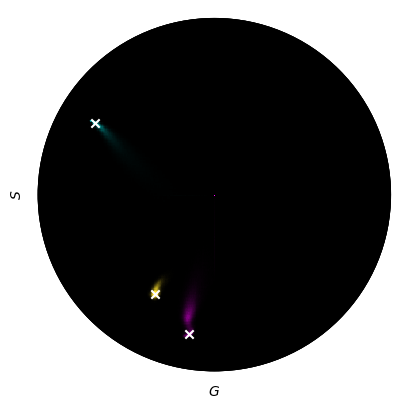

In [166]:
### Calculate the PC coordinates for the unmixed pure component images
ddir = os.path.join(droot,f'fig8/one-color-plus-cellTrace/')

pc1 = PC(file=os.path.join(ddir,'LAMP1_unmixing.tif'),name='LAMP1',filt=True,thresh=None,crop_dims=None)
pc2 = PC(file=os.path.join(ddir,'mito_unmixing.tif'),name='MT',filt=True,thresh=None,crop_dims=None)
fname_AF = '4. CellTrace_Only_488-0.8_561-0.1_pin-70_Gain-700_2x'
pc3 = PC(file=os.path.join(ddir,fname_AF+'.czi'),name='AF',filt=True,thresh='triangle',crop_dims=None)
pc3.determine_peak(no_bg=True,pk_flag='test')

pc1.determine_peak(no_bg=False,pk_flag='test')

pc2.determine_peak(no_bg=False,pk_flag='test')

fig, ax = plt.subplots()

pcs_t = {'LAMP1' : pc1, 'MT' : pc2, 'AF' : pc3}
colors = {'LAMP1' : ['0','#00ebebff'], 'MT' : ['0','#fd00fdff'], 'AF' : ['0','#FEE12B']}
p_maxes = {'LAMP1' : 0.75, 'MT' : 0.605, 'AF' : 0.75}
for key in pcs_t:
    pcs_t[key].plot_hist_with_peaks(ax1=ax,p_max=p_maxes[key],cmap=lsm.from_list(name = 'test', colors=colors[key]))
    
save_dir = os.path.join(droot,'supp_fig5/')
# fig.savefig(save_dir+'unmixed_pcs.png',dpi=300)
 

### Mixture

###### three-color

Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
AF is already clustered... Peak at [-0.33612177 -0.56408579]
Exp has a colocalization factor of [0.28610791 0.38888589]
[-0.10257932038130277, 0.5960967057311807, 0.40663786377387584]
Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
AF is already clustered... Peak at [-0.33612177 -0.56408579]
Exp has a colocalization factor of [0.29994929 0.62460748]
[-0.05877357518363936, 0.8410828856961811, 0.641483874881416]
Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
AF is already clustered... Peak at [-0.33612177 -0.56408579]
Exp has a colocalization factor of [0.40636874 0.68573362]
[-0.13962774363231506, 0.8040743525174043, 

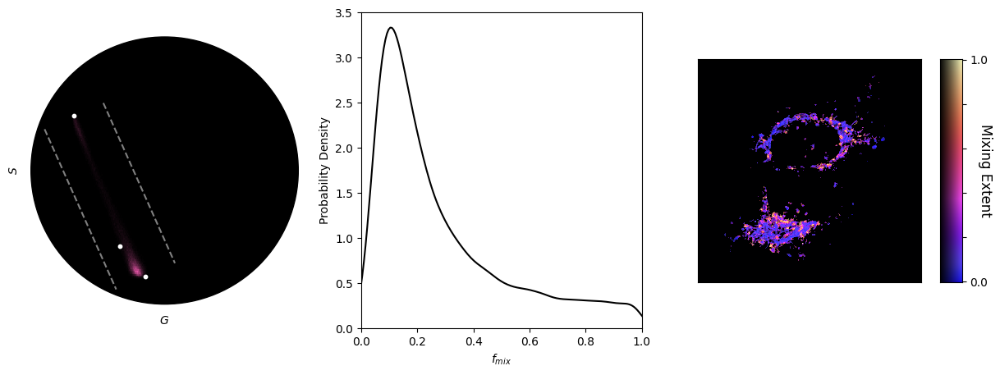

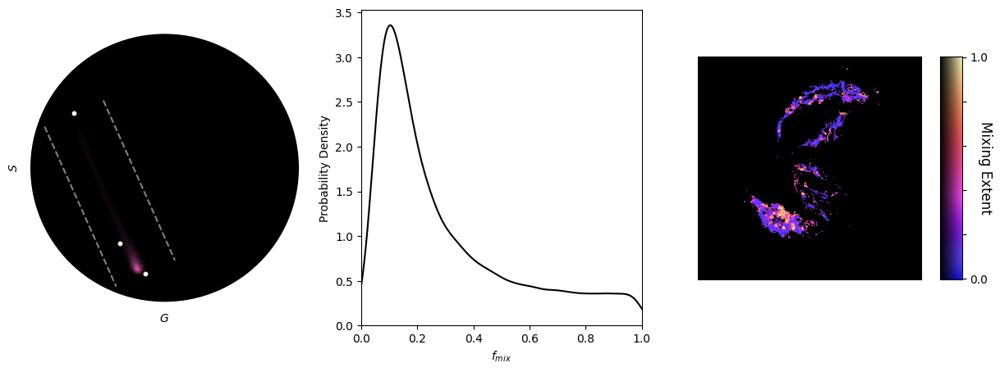

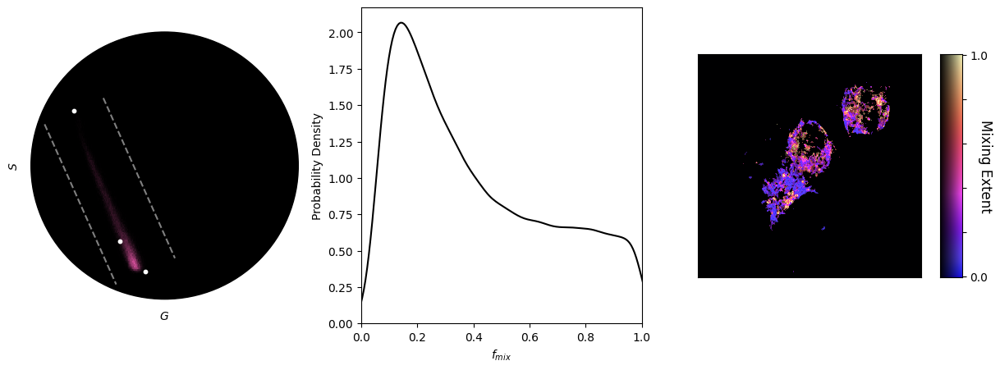

In [170]:
### Calculate the mixing and colocalization in the three-color samples after removing the CellTrace using phasor-based unmixing

ddir = os.path.join(droot,f'fig8/three-color')
fnames = [f for f in os.listdir(ddir) if os.path.isfile(os.path.join(ddir, f))]

exps_threecolor = dict()
for fname_AF in fnames:
    
    exp_temp = PairMixture(file=os.path.join(ddir,fname_AF),name='Exp',
                    pcs=[pcs_t['LAMP1'],pcs_t['MT'],pcs_t['AF']],min_lambda=np.amin(pcs_t['MT'].lambdas),
                    thresh=None,mask=None,filt=True)
    exp_temp.analyze_overlap()
    exp_temp.calc_pearson_mander(pcs=[pcs_t['LAMP1'],pcs_t['MT']],thresh_override=True,thresh_method='iso')
    print([exp_temp.pearsons, exp_temp.manders1, exp_temp.manders2])
    exps_threecolor[fname_AF] = exp_temp

In [ ]:
temp = np.nan_to_num(exps_threecolor[fnames[0]].intensity_af_sub)

tifffile.imwrite(os.path.join(ddir,'out/'+fnames[0][:-4]+'_celltrace_removed.tif'),np.moveaxis(temp.astype(np.float32),-1,0),
                            imagej=True,metadata={'axes' : 'ZYX', 'Labels' : [str(round(t)) for t in exps_threecolor[fnames[0]].lambdas]})

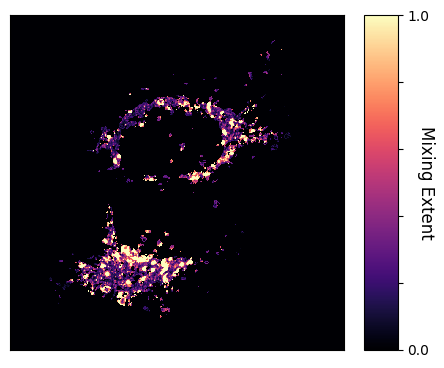

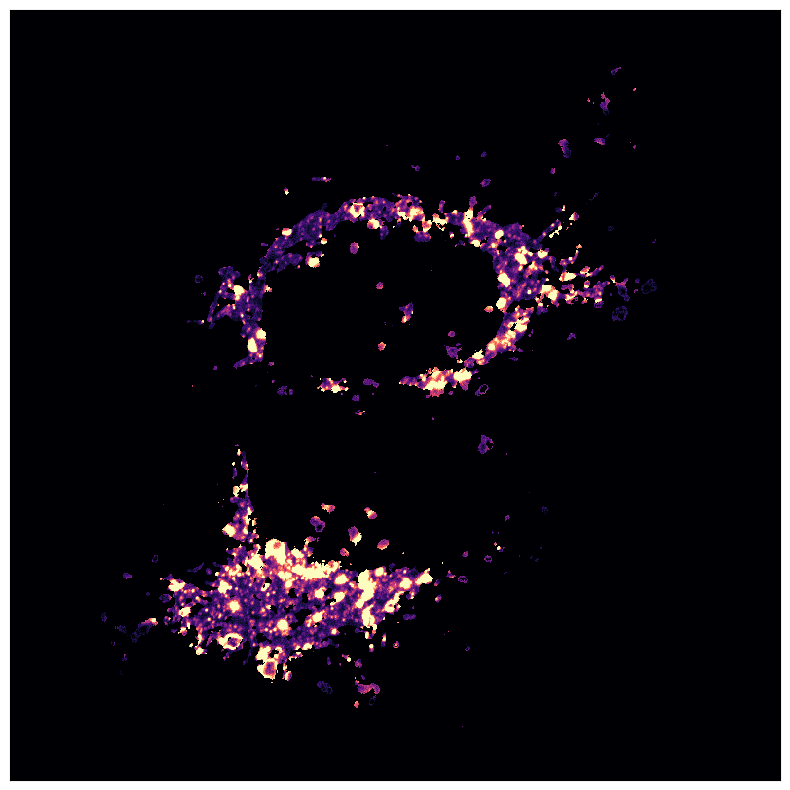

In [375]:
fig, ax = plt.subplots(figsize=(5,5))
exps_threecolor[fnames[0]].color_mixing_image(ax1=ax,imtype='1D')
save_dir = os.path.join(droot,'fig8/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(exps_threecolor[fnames[0]].img_norm_flip,cmap='magma')
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

plt.savefig(os.path.join(save_dir,f'threecolor_af_sub_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
AF is already clustered... Peak at [-0.33612177 -0.56408579]


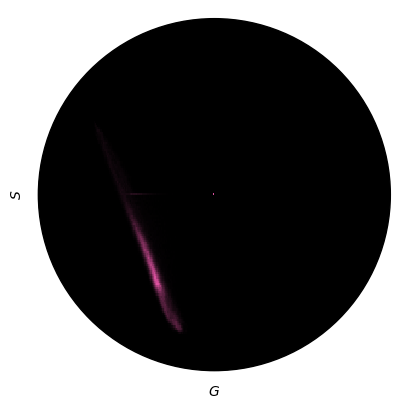

In [ ]:

fnames = os.listdir(ddir)
fig, ax = plt.subplots()
exp_temp = PairMixture(file=os.path.join(ddir,fnames[0]),name='Exp',
                pcs=[pcs_t['LAMP1'],pcs_t['MT'],pcs_t['AF']],
                thresh='triangle',mask=None,filt=True)
exp_temp.plot_phasor(ax1=ax,p_max=1.0)

save_dir = os.path.join(droot,f'fig_s7/')
# fig.savefig(os.path.join(save_dir,f'mixed_threecolor_phasor.png'),dpi=300)

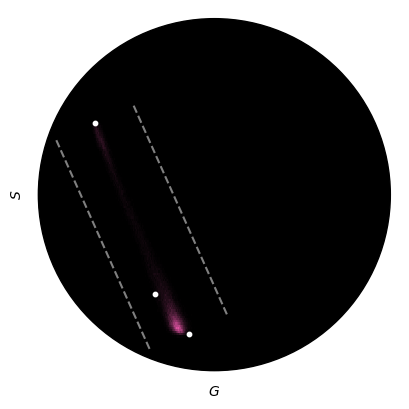

In [ ]:
fig, ax = plt.subplots()
exps_threecolor[fnames[0]].plot_band(ax1=ax)

save_dir = os.path.join(droot,f'fig_s7/')
# fig.savefig(os.path.join(save_dir,'threecolor_unmixed_phasor.png'),dpi=300)

###### Three-color no unmixing

Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
Exp has a colocalization factor of [0.58811623 0.70020831]
[0.10880326594775674, 0.8623500774343457, 0.7815584796026571]
Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
Exp has a colocalization factor of [0.36636667 0.72277027]
[0.372385974470489, 0.9831559789000951, 0.9165718114871578]
Filtering Phasor Coordinates...
LAMP1 is already clustered... Peak at [-0.67820949  0.40740059]
MT is already clustered... Peak at [-0.14266086 -0.79145528]
Exp has a colocalization factor of [0.58293579 0.8648603 ]
[0.36241842076653424, 0.9121818690068141, 0.9362535294982244]


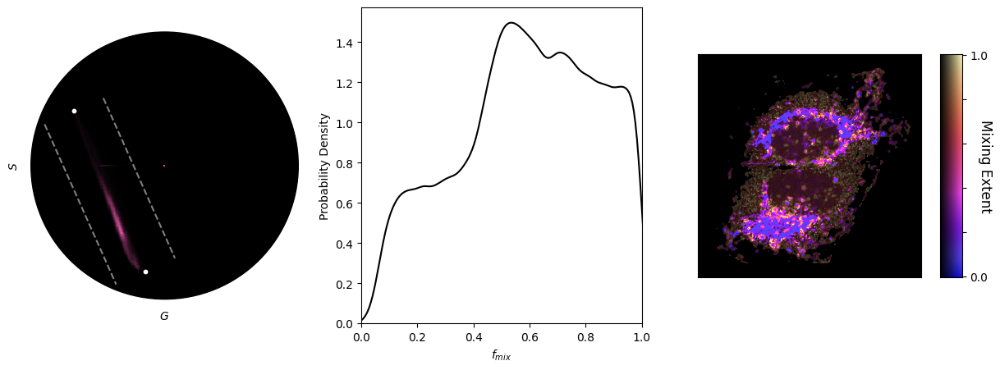

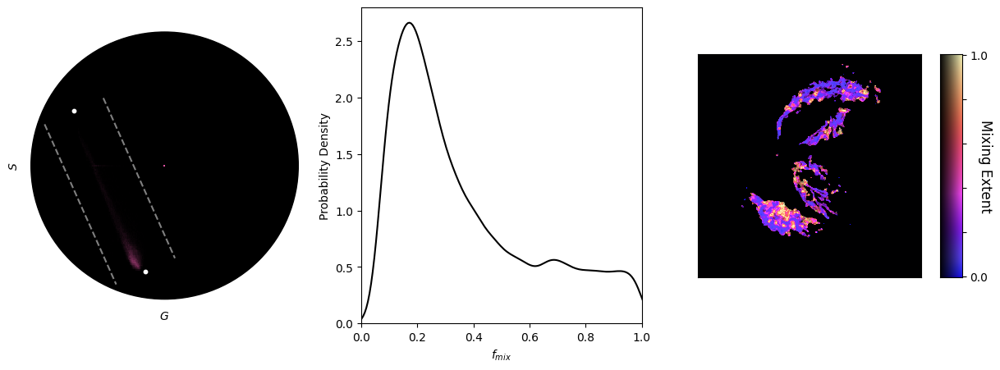

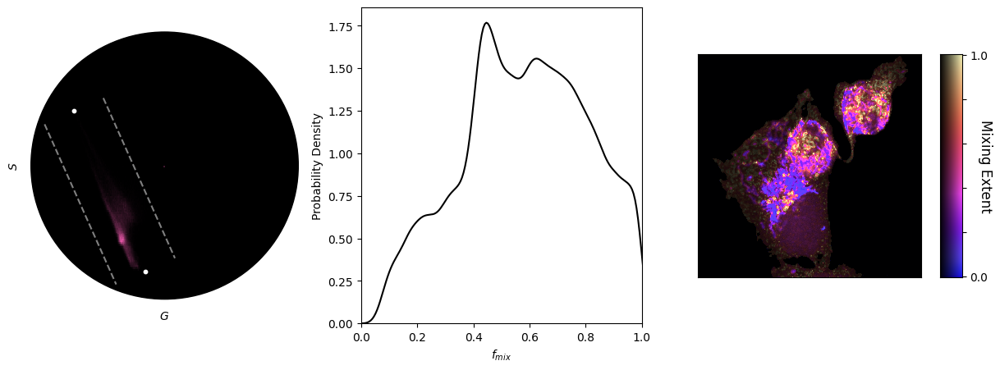

In [177]:
### Calculate the colocalization and mixing without removing the CellTrace

ddir = os.path.join(droot,f'fig8/three-color')
fnames = [f for f in os.listdir(ddir) if os.path.isfile(os.path.join(ddir, f))]
exps_threecolor_noaf = dict()
for fname_AF in fnames:
    exp_temp = PairMixture(file=os.path.join(ddir,fname_AF),name='Exp',
                    pcs=[pcs_t['LAMP1'],pcs_t['MT']],min_lambda=np.amin(pcs_t['MT'].lambdas),
                    thresh='triangle',mask=None,filt=True)
    exp_temp.analyze_overlap(lims=[2,95])
    exp_temp.calc_pearson_mander(pcs=[pcs_t['LAMP1'],pcs_t['MT']],thresh_override=True,thresh_method='triangle')
    print([exp_temp.pearsons, exp_temp.manders1, exp_temp.manders2])
    exps_threecolor_noaf[fname_AF] = exp_temp

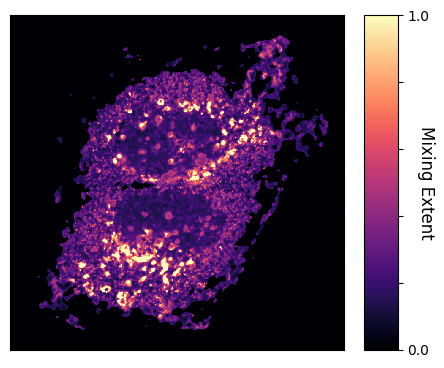

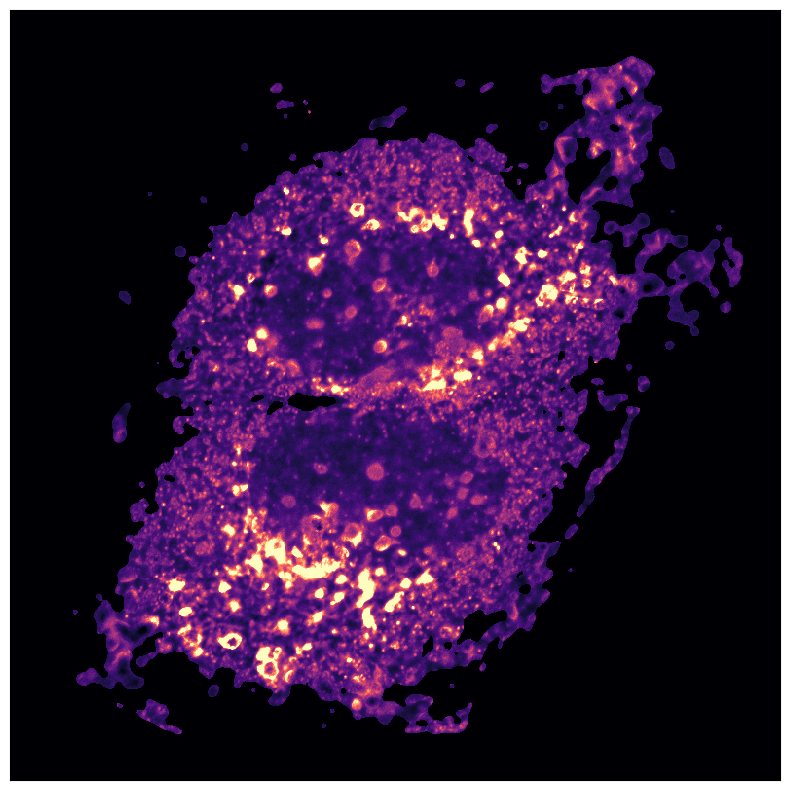

In [374]:
ddir = os.path.join(droot,f'fig8/three-color')
fnames = os.listdir(ddir)

fig, ax = plt.subplots(figsize=(5,5))
exps_threecolor_noaf[fnames[0]].color_mixing_image(ax1=ax,imtype='1D')
save_dir = os.path.join(droot,'fig8/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(exps_threecolor_noaf[fnames[0]].img_norm_flip,cmap='magma')
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

plt.savefig(os.path.join(save_dir,f'threecolor_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

###### lmp1 + mito

Finished clustering data for MT...
Determined peak at [-0.11588207 -0.7936418 ]for MT
Finished clustering data for LAMP1...
Determined peak at [-0.70486624  0.27551876]for LAMP1


<Axes: xlabel='$G$', ylabel='$S$'>

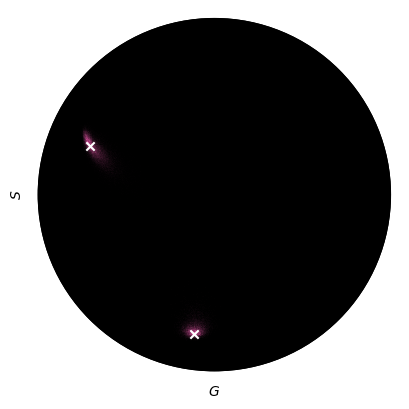

In [182]:
### Determine the PC coordinates in single-color samples without CellTrace
ddir = os.path.join(droot,f'fig8/one-color')
pc2_testtest = PC(file=os.path.join(ddir,'Snap-1001.czi'),name='LAMP1',filt=False,thresh='iso')
pc1_testtest = PC(file=os.path.join(ddir,'Snap-995.czi'),name='MT',filt=False,thresh='iso')

pc1_testtest.determine_peak(no_bg=False,pk_flag='test')

pc2_testtest.determine_peak(no_bg=False,pk_flag='test')

fig, ax = plt.subplots()
pc1_testtest.plot_hist_with_peaks(ax1=ax)
pc2_testtest.plot_hist_with_peaks(ax1=ax)

Filtering Phasor Coordinates...
MT is already clustered... Peak at [-0.11588207 -0.7936418 ]
LAMP1 is already clustered... Peak at [-0.70486624  0.27551876]
Exp has a colocalization factor of [0.32325883 0.56629138]
[-0.023748802579455826, 0.5541708201028656]
Filtering Phasor Coordinates...
MT is already clustered... Peak at [-0.11588207 -0.7936418 ]
LAMP1 is already clustered... Peak at [-0.70486624  0.27551876]
Exp has a colocalization factor of [0.30933464 0.54699574]
[-0.06594463676339876, 0.4989654032062881]
Filtering Phasor Coordinates...
MT is already clustered... Peak at [-0.11588207 -0.7936418 ]
LAMP1 is already clustered... Peak at [-0.70486624  0.27551876]
Exp has a colocalization factor of [0.34910066 0.57633092]
[-0.0677609827577827, 0.5585613240075878]


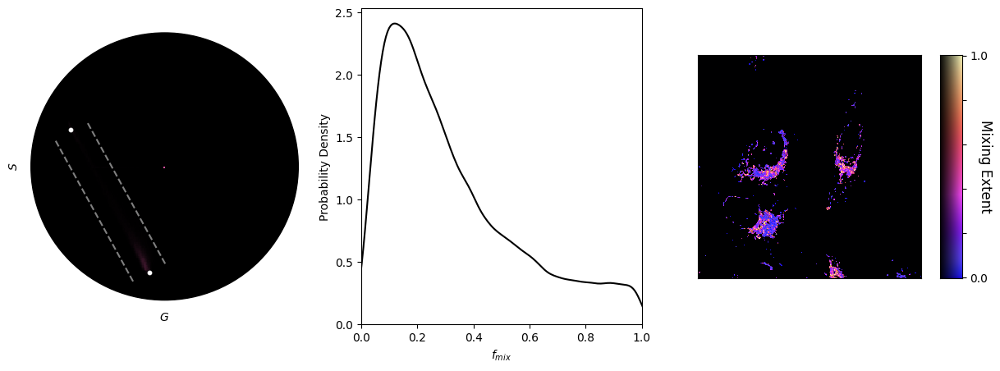

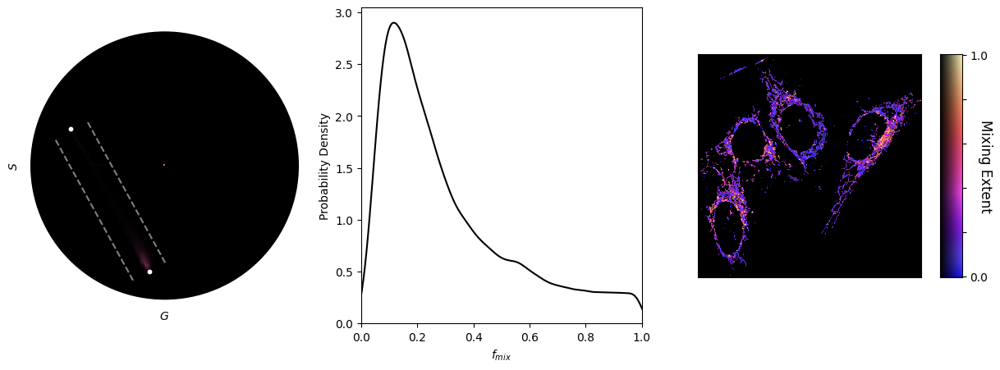

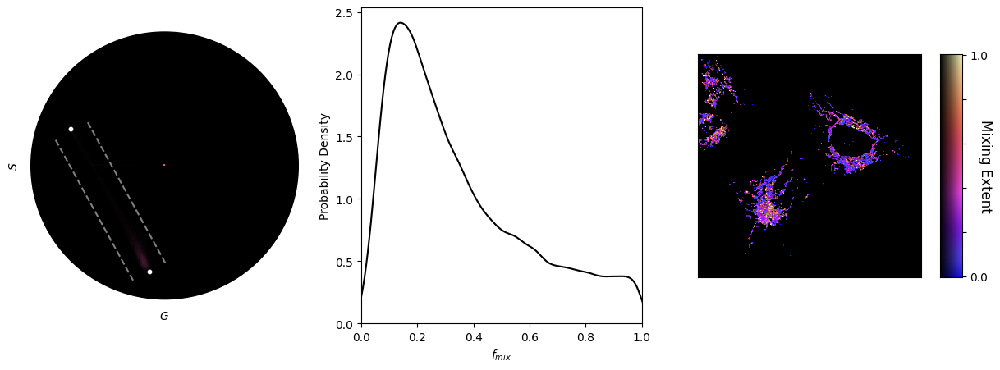

In [186]:
### Calculate the colocalization and mixing in two-color samples without CellTrace
ddir = os.path.join(droot,f'fig8/two-color')
fnames = [f for f in os.listdir(ddir) if os.path.isfile(os.path.join(ddir, f))]
exps_twocolor = dict()
for fname_AF in fnames:

    
    exp_temp = PairMixture(file=os.path.join(ddir,fname_AF),name='Exp',
                pcs=[pc1_testtest,pc2_testtest],min_lambda=np.amin(pc1_testtest.lambdas),
                thresh='iso',mask=None,filt=True)
    exp_temp.analyze_overlap()
    exp_temp.calc_pearson_mander(pcs=[pc1_testtest,pc2_testtest],thresh_override=True,thresh_method='iso')
    print([exp_temp.pearsons, exp_temp.mandersO])
    exps_twocolor[fname_AF] = exp_temp

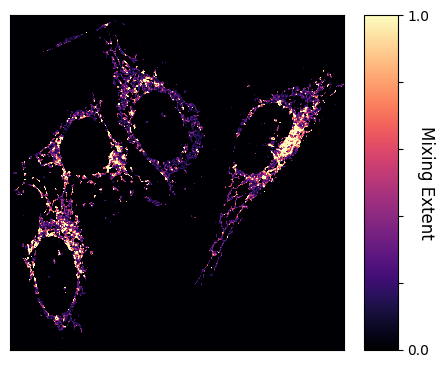

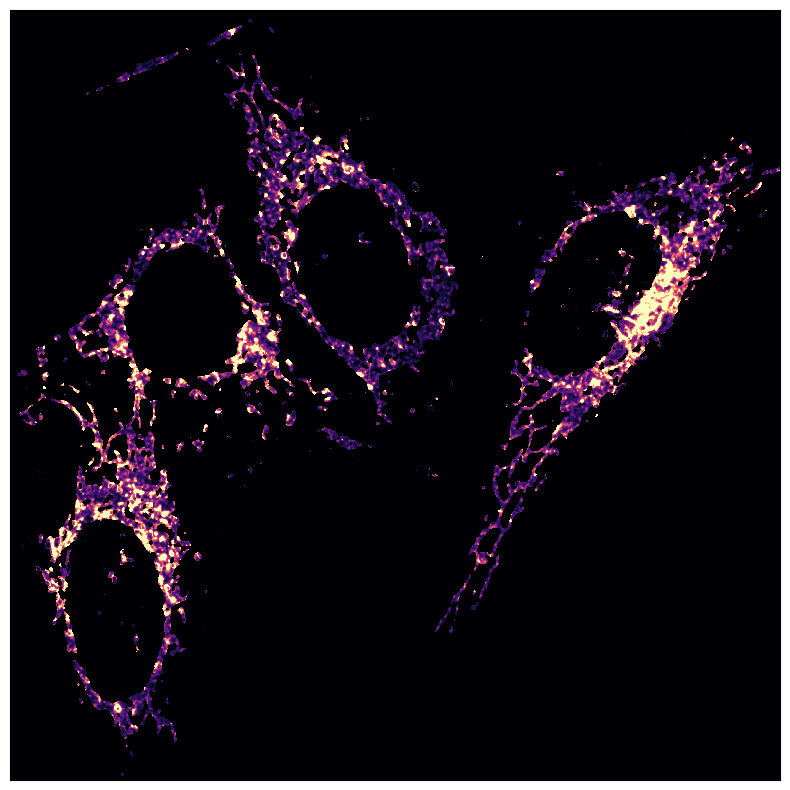

In [373]:
ddir = os.path.join(droot,f'fig8/two-color')
fnames = [f for f in os.listdir(ddir) if os.path.isfile(os.path.join(ddir, f))]

fig, ax = plt.subplots(figsize=(5,5))
exps_twocolor[fnames[1]].color_mixing_image(ax1=ax,imtype='1D')
save_dir = os.path.join(droot,'fig8/figures/')

fig, ax1 = plt.subplots(figsize=(10,10))
ax1.pcolormesh(exps_twocolor[fnames[1]].img_norm_flip,cmap='magma')
ax1.set_aspect('equal'); 
ax1.tick_params(
    axis='both',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False
)

plt.savefig(os.path.join(save_dir,f'twocolor_mixing_image.png'),dpi=300,bbox_inches='tight',transparent=True)

##### Combined

In [188]:
exp_pearsons = [[test.pearsons for _, test in exps_twocolor.items()],
                         [test.pearsons for _, test in exps_threecolor_noaf.items()],
                         [test.pearsons for _, test in exps_threecolor.items()]]

exp_mandersO = [[test.mandersO for _, test in exps_twocolor.items()],
                        [test.mandersO for _, test in exps_threecolor_noaf.items()],
                         [test.mandersO for _, test in exps_threecolor.items()]]

exp_manders1 = [[test.manders1 for _, test in exps_twocolor.items()],
                        [test.manders1 for _, test in exps_threecolor_noaf.items()],
                         [test.manders1 for _, test in exps_threecolor.items
                          ()]]

exp_manders2 = [[test.manders2 for _, test in exps_twocolor.items()],
                        [test.manders2 for _, test in exps_threecolor_noaf.items()],
                         [test.manders2 for _, test in exps_threecolor.items()]]

exp_pmc1 = [[test.coloc_vec[0] for _, test in exps_twocolor.items()],
                     [test.coloc_vec[0] for _, test in exps_threecolor_noaf.items()],
                         [test.coloc_vec[0] for _, test in exps_threecolor.items()]]

exp_pmc2 = [[test.coloc_vec[1] for _, test in exps_twocolor.items()],
                     [test.coloc_vec[1] for _, test in exps_threecolor_noaf.items()],
                         [test.coloc_vec[1] for _, test in exps_threecolor.items()]]

In [189]:
print([np.mean(temp) for temp in exp_pearsons])
print([np.mean(temp) for temp in exp_mandersO])
print([np.mean(temp) for temp in exp_manders1])
print([np.mean(temp) for temp in exp_manders2])
print([np.mean(temp) for temp in exp_pmc1])
print([np.mean(temp) for temp in exp_pmc2])
# print(np.mean(exp_manders,axis=1))
# print(np.mean(exp_pmc1,axis=1))
# print(np.mean(exp_pmc2,axis=1))

[-0.0524848073668791, 0.28120255372826003, -0.10032687973241906]
[0.5372325157722472, 0.6731357302089419, 0.7634643652525198]
[0.3911152393857016, 0.919229308447085, 0.7470846479815888]
[0.2535595327065919, 0.878127940196013, 0.5510943496882853]
[0.32723137635353455, 0.5124728979953036, 0.3308086431842215]
[0.5632060139625623, 0.7626129612982809, 0.566408999297623]


In [190]:
import scipy.stats
# for j in range(1,myo_colocs_new.shape[1]):
test = scipy.stats.ttest_ind(exp_pearsons[0],exp_pearsons[2],equal_var=False)
print(test.pvalue)

test = scipy.stats.ttest_ind(exp_manders1[0],exp_manders1[2],equal_var=False)
print(test.pvalue)

test = scipy.stats.ttest_ind(exp_manders2[0],exp_manders2[2],equal_var=False)
print(test.pvalue)

test = scipy.stats.ttest_ind(exp_pmc1[0],exp_pmc1[2],equal_var=False)
print(test.pvalue)

test = scipy.stats.ttest_ind(exp_pmc2[0],exp_pmc2[2],equal_var=False)
print(test.pvalue)


0.17053852719403112
0.02905298721111694
0.05168786602637695
0.9353064344442242
0.975043271572773


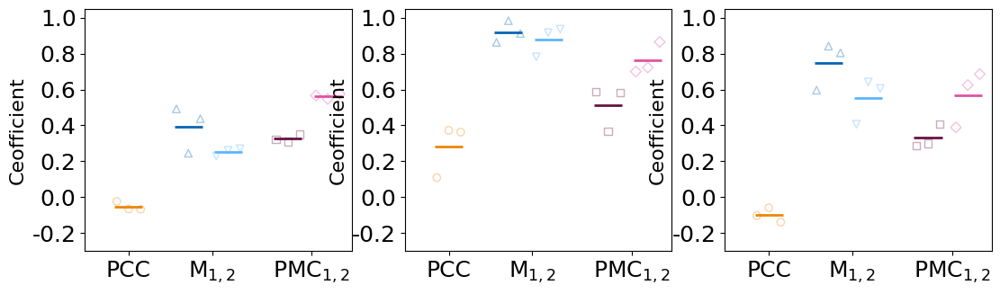

In [192]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(13,3.5))
xs = np.array([0.05,0.125,0.175,0.25,0.3])
markers = ['o','^','v','s','D']
colors = ['#EC8609','#0365B5','#5EB5FD','#671343','#DF53A2']

d = [[test.pearsons for _, test in exps_twocolor.items()],
     [test.manders1 for _, test in exps_twocolor.items()],
     [test.manders2 for _, test in exps_twocolor.items()],
     [test.coloc_vec[0] for _, test in exps_twocolor.items()],
     [test.coloc_vec[1] for _, test in exps_twocolor.items()]]
for jj in range(len(xs)):
    ax[0].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')

ax[0].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

d = [[test.pearsons for _, test in exps_threecolor_noaf.items()],
     [test.manders1 for _, test in exps_threecolor_noaf.items()],
     [test.manders2 for _, test in exps_threecolor_noaf.items()],
     [test.coloc_vec[0] for _, test in exps_threecolor_noaf.items()],
     [test.coloc_vec[1] for _, test in exps_threecolor_noaf.items()]]
for jj in range(len(xs)):
    ax[1].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')

ax[1].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

d = [[test.pearsons for _, test in exps_threecolor.items()],
     [test.manders1 for _, test in exps_threecolor.items()],
     [test.manders2 for _, test in exps_threecolor.items()],
     [test.coloc_vec[0] for _, test in exps_threecolor.items()],
     [test.coloc_vec[1] for _, test in exps_threecolor.items()]]
for jj in range(len(xs)):
    ax[2].scatter(xs[jj]*np.ones_like(d[0][:]) + np.arange(-0.02,0.02,0.015),d[jj],marker=markers[jj],edgecolors=colors[jj],alpha=0.35,facecolors='none')

ax[2].scatter(xs-0.005,[np.mean(temp) for temp in d],c=colors,marker='_',s=500,linewidth=2)

for axes in ax.ravel():

    axes.set_xticks([0.045,0.15,0.275],labels=['PCC',r'M$_{1,2}$',r'PMC$_{1,2}$'],rotation=0,fontsize=18)
    axes.set_yticks(np.arange(-0.4,1.1,0.2),labels=['-0.4','-0.2','0.0','0.2','0.4','0.6','0.8','1.0'],fontsize=18)
    axes.set_ylabel('Ceofficient',fontsize=16)
    axes.set_xlim([-0.01,0.325])    
    axes.set_ylim([-0.3,1.05])
    
save_dir = os.path.join(droot,f'fig8/figures')
# fig.savefig(save_dir+f'/coloc_coefficients_pcc_m1_m2_pmc_scatter_color_corrected_horizontal.svg',format='svg',dpi=300)

# 3D (Proof of Concept)

In [ ]:
### Function to simulate a multispectral image from a single intensity image as input
data_dir_sim = os.path.join(droot,f'fig4/')

def sim_spectral_image_dist_3D(im_file, params):
    
    lpks = params['l_file']
    sig = params['sig']
    lambdas = params['lambdas']
    ints = tifffile.imread(im_file)
    sim_im = np.zeros((ints.shape[0],ints.shape[1],ints.shape[2],len(lambdas)-1))
    for z_slice in range(ints.shape[0]):
        img_shape = ints[z_slice,:,:].shape
        # print(img_shape)
        gain = params['gain']
        readnoise = params['readnoise']
        nphtns = params['nphtns']
        bg = np.random.normal(readnoise,np.sqrt(readnoise),(img_shape[0]*img_shape[1],nphtns))
        pc_file = np.loadtxt(lpks,delimiter=',',skiprows=1)
        prob = pc_file[:,-1]/np.sum(pc_file[:,-1])
        temp = gain*(np.random.choice(np.arange(pc_file[0,0],pc_file[-1,0]+1), p=prob,size=(img_shape[0]*img_shape[1],nphtns))+bg)
        temp[temp<0] = 0.0
        temp2 = [np.histogram(sim,lambdas) for sim in temp]
        sim_im1 = np.multiply(np.reshape(np.array([temp2[j][0] for j in range(len(temp2))]),(img_shape[0],img_shape[1],32)),ints[z_slice,:,:,np.newaxis]).astype('float32')
        ls = np.array(temp2[0][1][1:])
        sim_im[z_slice,:,:,:] = sim_im1
    
    return sim_im, ls

In [ ]:
### Simulate single- and two-color multispectral images from single intensity image inputs
data_dir_sim = os.path.join(droot,f'revisions/3D/')
params = {'l_file' : data_dir_sim+'af561.csv', 'sig' : 10, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'C_ch1.tif'

imA, ls = sim_spectral_image_dist_3D(fname,params)
tifffile.imwrite(data_dir_sim+'C_ch1_3D_spec.tif',np.moveaxis(imA,-1,1).astype('float32')[np.newaxis,...],imagej=True,metadata={'axes' : 'TZCYX', 'Labels' : [f'{l}' for l in ls]})

params = {'l_file' : data_dir_sim+'af647.csv', 'sig' : 10, 'lambdas' : np.linspace(300,900,33), 'gain' : 1.0, 'readnoise' : 1.0, 'nphtns' : 100}
fname = data_dir_sim + 'C_ch2.tif'

imB, ls = sim_spectral_image_dist_3D(fname,params)
tifffile.imwrite(data_dir_sim+'C_ch2_3D_spec.tif',np.moveaxis(imB,-1,1).astype('float32')[np.newaxis,...],imagej=True,metadata={'axes' : 'TZCYX', 'Labels' : [f'{l}' for l in ls]})

im_comb = 1.0*imA + 1.0*imB
tifffile.imwrite(data_dir_sim+'C_3D_afcomb_spec.tif',np.moveaxis(im_comb,-1,1).astype('float32')[np.newaxis,...],imagej=True,metadata={'axes' : 'TZCYX', 'Labels' : [f'{l}' for l in ls]})

In [ ]:
### Determine the PC coordinates from single-color images
data_dir_sim = os.path.join(droot,f'revisions/3D/')
pc1_spec_test = PC(file=data_dir_sim+'C_ch1_3D_spec.tif',name='AF561',thresh=None,crop_dims=None)
pc2_spec_test = PC(file=data_dir_sim+'C_ch2_3D_spec.tif',name='AF647',thresh=None,crop_dims=None)

pc1_spec_test.determine_peak(pk_flag='test')
pc2_spec_test.determine_peak(pk_flag='test')

Filtering Phasor Coordinates...
AF561 is already clustered... Peak at [-0.93764371  0.09812046]
AF647 is already clustered... Peak at [-0.55547238 -0.76442206]
(256, 256, 3)
(256, 256, 3)
(11, 400, 400)
(11, 400, 400)
test has a colocalization factor of [0.60197611 0.58752106]
Threshold method not given by requested. Using Otsu
0.07911747575885458 0.6892500701388856 0.9827843131785338


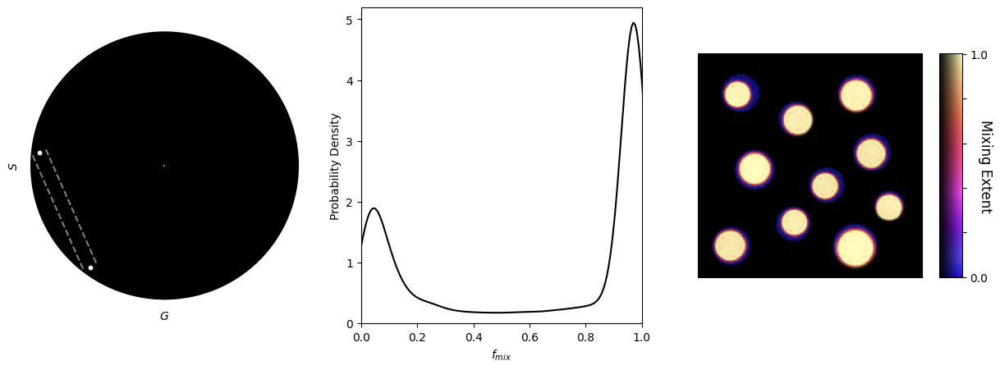

In [299]:
### Calculate the colocalization and mixing from the two-color sample
data_dir_sim = os.path.join(droot,f'3D/')
mixC = PairMixture(file=data_dir_sim + 'C_3D_afcomb_spec.tif',name='test',
                  pcs=[pc1_spec_test,pc2_spec_test],thresh=None,filt=True,crop_dims=None)

mixC.analyze_overlap(n_sigma=1.96,p_max=0.75,lims=[0,100],imtype='2D')
mixC.calc_pearson_mander(pcs=mixC.purecomps,thresh_override=True)
print(mixC.pearsons,mixC.manders1,mixC.manders2)

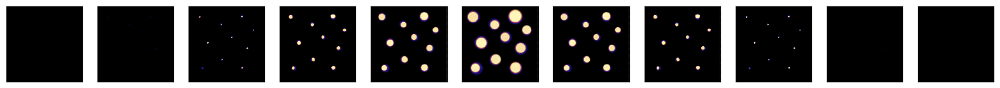

In [224]:
fig, axes = plt.subplots(nrows=1,ncols=mixC.intensity.shape[0],figsize=(20,5))
for j, ax in zip(range(mixC.intensity.shape[0]),axes.ravel()):
    ax.pcolormesh(mixC.im_2DLUT[j,:,:],cmap='magma')
    ax.set_aspect('equal'); 
    ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        labelbottom=False,
        left=False,
        right=False,
        labelleft=False
    )

In [227]:
tifffile.imwrite(os.path.join(data_dir_sim,'3D_mixing_image.tif'),mixC.im_2DLUT,photometric='rgb')